### Checking the device

In [ ]:
!nvidia-smi

Sun May 15 23:28:23 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   70C    P8    12W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

# ***Libraries & Constants***

In [ ]:
!pip install split-folders --quiet
!pip install ipyplot --quiet
!pip install -q -U keras-tuner

In [ ]:
from keras.layers import (Conv2D, Dense, Dropout, Flatten, MaxPooling2D, BatchNormalization, Activation, Input, add, concatenate)
from keras.models import Model
from keras.preprocessing import image
from keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import (Adam, SGD, RMSprop)
from sklearn.model_selection import KFold
from keras.utils.vis_utils import plot_model
from PIL import Image
from keras.layers import AveragePooling2D, MaxPooling2D
from keras.preprocessing.image import array_to_img, img_to_array, load_img
from sklearn import metrics
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from tabulate import tabulate
from termcolor import colored
from tqdm.keras import TqdmCallback
import cv2
import gc
import glob
import keras_tuner as kt
import matplotlib.pyplot as plt
import numpy as np
import os, shutil
import pandas as pd
import random
import seaborn as sn
import splitfolders
import tensorflow as tf
import ipyplot


        WARNING! Google Colab Environment detected!
        You might encounter issues while running in Google Colab environment.
        If images are not displaying properly please try setting `force_b64` param to `True`.
        


In [ ]:
# set path of dataset folders
path = "/content/Multi-class Weather Dataset"

### Setting Random seed

In [ ]:
seed = 14002
def set_random_seed(seed=14002):
    tf.random.set_seed(seed)
    random.seed(seed)
    np.random.seed(seed)

# ***Preprocessing***



##Reading & displaying data

####Downloading dataset

In [ ]:
# Downloading dataset zip file

!gdown 1lwfNxvynjlG8VPd2jwQjk1ylxls1ut0j # main
# !gdown 1OOVZufs6k-yuidGetucYRIF9WLKDeYU0 #test

# silently unzip and overwrite
!unzip -qq -o /content/Multi-class\ Weather\ Dataset.zip # main
# !unzip -qq -o /content/test.zip #test

Downloading...
From: https://drive.google.com/uc?id=1lwfNxvynjlG8VPd2jwQjk1ylxls1ut0j
To: /content/Multi-class Weather Dataset.zip
100% 95.8M/95.8M [00:00<00:00, 390MB/s]


#### analyzing data set

In [ ]:
# printing dataset classes

classes = sorted(os.listdir(path))
print("classes:", classes)

classes: ['Cloudy', 'Rain', 'Shine', 'Sunrise']


In [ ]:
# analyzing data distribution

dic = {}
for i in range(len(classes)):
    dic[classes[i]] = len(os.listdir(path + "/" + classes[i]))
print("Number of samples in each class:", dic)
print("Sum of samples:", sum(dic.values()))

heigths = []
widths = []

for dirpath, _, filenames in os.walk(path):
    for path_image in filenames:
        image = os.path.abspath(os.path.join(dirpath, path_image))
        with Image.open(image) as img:
            width, heigth = img.size
            heigths.append(heigth)
            widths.append(width)
avg_height = 128  #sum(heigths) // len(heigths)
avg_width = 128  #sum(widths) // len(widths)

print("\nThe average height of all images is:", avg_height, "\nThe average width of all images is:", avg_width)

Number of samples in each class: {'Cloudy': 300, 'Rain': 215, 'Shine': 253, 'Sunrise': 357}
Sum of samples: 1125

The average height of all images is: 128 
The average width of all images is: 128


## Train and Val sets and augmentation function

#### Generating augmentation function 

In [ ]:
# first we need to split the folders into train and test set and shuffle them at the same time keeping their lables
# remove existing directory
output_dir = '/content/splitted_output'
if os.path.exists(output_dir):
    shutil.rmtree(output_dir)
# Split with a ratio.
# To only split into training and validation set, set a tuple to `ratio`, i.e, `(.8, .2)`.
splitfolders.ratio(path, output="splitted_output", seed=seed, ratio=(.8, .2))

Copying files: 1125 files [00:00, 3135.42 files/s]


You can find the document to the ImageDataGenerator [here](https://www.tensorflow.org/api_docs/python/tf/keras/preprocessing/image/ImageDataGenerator)

In [ ]:
# Generate batches of tensor image data with real-time data augmentation.

# Train data Generator 
train_datagen = ImageDataGenerator(
    rescale=1. / 255,
    # rotation_range=10,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True)

# Validation data Generator 
val_datagen = ImageDataGenerator(rescale=1. / 255)

#### augmentation example

/usr/local/lib/python3.7/dist-packages/ipyplot/_utils.py:95: FutureWarning: The input object of type 'JpegImageFile' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'JpegImageFile', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  return np.asarray(seq, dtype=type(seq[0]))



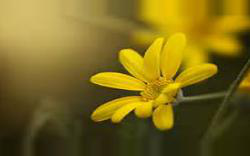
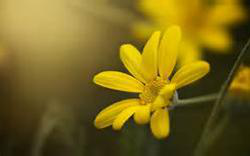
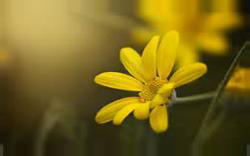
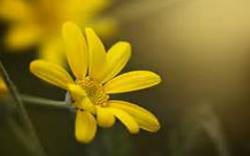
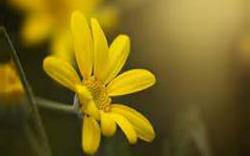
...
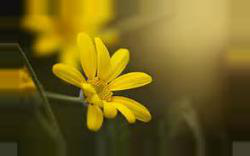
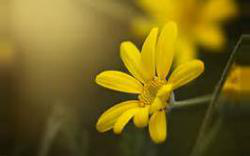
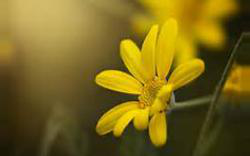
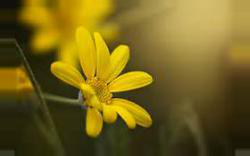
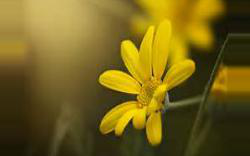

In [ ]:
# Generating Some exmamples of data augmentation

img = load_img('/content/splitted_output/train/Shine/shine252.jpg')  # this is a PIL image

# outputing dir
output_dir = '/content/augmented_sample'
if os.path.exists(output_dir):
    shutil.rmtree(output_dir)
os.mkdir('/content/augmented_sample')

x = img_to_array(img)  # this is a Numpy array with shape (3, 150, 150)
x = x.reshape((1,) + x.shape)  # this is a Numpy array with shape (1, 3, 150, 150)

# the .flow() command below generates batches of randomly transformed images
# and saves the results to the `preview/` directory
i = 0
for batch in train_datagen.flow(x, batch_size=1, seed=seed, save_to_dir='augmented_sample',
                                save_prefix='augmented_sample', save_format='jpg'):
    i += 1
    if i > 10:
        break  # otherwise the generator would loop indefinitely

# printing all images 
image_list = []
for filename in glob.glob('/content/augmented_sample/*.jpg'):  # assuming gif
    im = Image.open(filename)
    image_list.append(im)

ipyplot.plot_images(image_list)


#### Generate Train and Val set

In [ ]:
# Generate Train and Val
def generate_sets():
    # fixing the seed
    set_random_seed()
    
    # paths of shuffled and splitted data
    train_path = "/content/splitted_output/train"
    val_path = "/content/splitted_output/val"

    # Train
    train_generator = train_datagen.flow_from_directory(
        train_path,
        target_size=(avg_height, avg_width),  # 334, 506
        batch_size=32,
        seed=seed,
        shuffle=True,
        class_mode='categorical')

    # Validation
    validation_generator = val_datagen.flow_from_directory(
        val_path,
        target_size=(avg_height, avg_width),  # 334, 506
        batch_size=32,
        seed=seed,
        shuffle=False,
        class_mode='categorical')
    
    return train_generator, validation_generator

In [ ]:
# Generate cross val data

def generate_cross_val():
    # fixing the seed
    set_random_seed()
    
    # paths of shuffled and splitted data
    cross_val_path = "/content/Multi-class Weather Dataset"

    # Train
    cross_val_generator = train_datagen.flow_from_directory(
        cross_val_path,
        target_size=(avg_height, avg_width),  # 334, 506
        batch_size=32,
        seed=seed,
        shuffle=True,
        class_mode='categorical')

    return cross_val_generator

In [ ]:
train_generator, validation_generator = generate_sets()
print()
labels = (train_generator.class_indices)
labels = dict((v, k) for k, v in labels.items())
print(labels)

Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.

{0: 'Cloudy', 1: 'Rain', 2: 'Shine', 3: 'Sunrise'}


#### Train set example

[0. 0. 1. 0.]


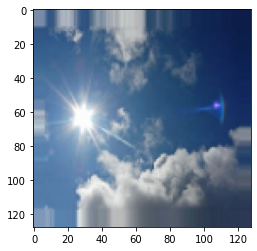

[1. 0. 0. 0.]


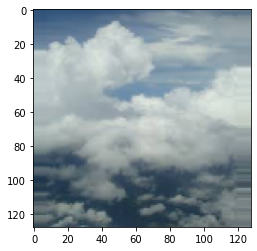

[0. 0. 0. 1.]


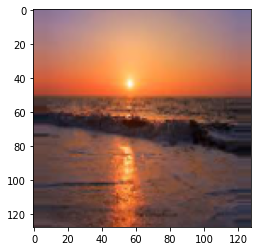

In [ ]:
x,y = train_generator.next()
for i in range(0,3):
    image = x[i]
    label = y[i]
    print (label)
    plt.imshow(image)
    plt.show()

#***Model***

#### Some helping functions

reset the directory

In [ ]:
# reset outputing dir
output_dir = 'models/my_dir'
if os.path.exists(output_dir):
    shutil.rmtree(output_dir)

# ! unzip -qq -o /content/important-backup.zip
# ! mv /content/content/* /content
# ! rmdir /content/content

In [ ]:
optimizers = {"Adam": Adam, "RMSprop": RMSprop, "SGD": SGD}

changing the type of keras history from list into np array

In [ ]:
# changing the type of keras history from list into np array
def dic_to_np_array(dic):
    np_dic = {}
    for key in dic.keys():
        np_dic[key] = np.array(dic[key])
    iterations = np.arange(start=1, stop=len(np_dic['loss']) + 1)
    np_dic["iterations"] = iterations

    return np_dic

remove all checkpoints data

Drawing Plot : drawing the plot for accuacy and loss in train and valid

In [ ]:
def draw_plot(title, accuracy_loss, k=1):
    # reset plt syle
    plt.style.use('default')
    print("\n")
    plt.figure(figsize=(30, 6))

    # left subplot
    plt.subplot(1, 2, 1)
    plt.ylim([0, 1])
    plt.plot(accuracy_loss["iterations"][::k], accuracy_loss["accuracy"][::k], label="train")
    plt.plot(accuracy_loss["iterations"][::k], accuracy_loss["val_accuracy"][::k], label="validation")
    plt.xlabel('epochs')
    plt.ylabel("Accuracy")
    plt.legend()
    plt.title("Accuracy", fontweight='bold')

    # right subplot
    plt.subplot(1, 2, 2)
    # plt.ylim([0, 1])
    plt.plot(accuracy_loss["iterations"][::k], accuracy_loss["loss"][::k], label="train")
    plt.plot(accuracy_loss["iterations"][::k], accuracy_loss["val_loss"][::k], label="validation")
    plt.xlabel('epochs')
    plt.ylabel("Loss")
    plt.legend()
    plt.title("Loss", fontweight='bold')

    plt.suptitle(title, fontsize=20, fontweight='bold', y=1.02)
    plt.show()

Confusion Matirx


a matrix that shows the TP, Tn, FP and FN values

then we will calculate the precision, recall and f1-score along with the macro avg of multiclass classification

In [ ]:
def print_confusion(model, dataset=None, read_data=False):
    # reset plt syle
    plt.style.use('default')

    train_generator, validation_generator = generate_sets()
    lables = list(train_generator.class_indices)

    if not read_data:
        y_pred = np.argmax(model.predict(validation_generator), axis=1)
        y_true = validation_generator.classes
    else:
        data = list(dataset.as_numpy_iterator())[0]
        inputs = data[0] / 255
        targets = data[1]

        y_pred = np.argmax(model.predict(inputs), axis=1)
        y_true = np.argmax(targets, axis=1)

    cm = metrics.confusion_matrix(y_true, y_pred)
    
    df_cm = pd.DataFrame(cm, lables, lables)
    plt.figure(figsize=(3, 2))

    sn.set(font_scale=1.3)  # for label size
    sn.heatmap(df_cm, annot=True, annot_kws={"size": 14}, fmt='g')  # font size

    plt.show()

    print("\n\n", metrics.classification_report(y_true, y_pred, digits=4), "\n\n\n")


some functions for creating tables

In [ ]:
# a function for printing tables
def print_table(data, head=['Number of Layers', 'Train Loss', 'Train Accuracy', 'Val Loss', 'Val Accuracy'],
                rows=['2', '3', '5']):
    # for p in data:
    #     print(p)
    table = [head]
    for i in range(len(data)):
        row_list = [rows[i]]
        for j in range(len(data[i])):
            row_list.append(data[i][j][-1])
        table.append(row_list)
    return tabulate(table, headers='firstrow', tablefmt='fancy_grid')


# a function for turning dictionary of costs and accuracies to matrix
def dic_to_matrix(data):
    tmp = [data["loss_train"], data["accuracy_train"], data["loss_val"], data["accuracy_val"]]
    # print(tmp)
    return tmp


# a function for find the maximum values according to diffrent parameters
def find_max_i(data):
    max_train_accuray = np.where(data["accuracy"] == np.max(data["accuracy"]))[0][0]
    index_max_train_accuray = np.argmax(data["accuracy"])

    max_val_accuracy = np.where(data["val_accuracy"] == np.max(data["val_accuracy"]))[0][0]
    index_max_val_accuracy = np.argmax(data["val_accuracy"])

    min_train_loss = np.where(data["loss"] == np.min(data["loss"]))[0][0]
    index_min_train_loss = np.argmin(data["loss"])

    min_val_loss = np.where(data["val_loss"] == np.min(data["val_loss"]))[0][0]
    index_min_val_loss = np.argmin(data["val_loss"])

    # creating the columns according to the report
    accuray_loss_train__min_loss = ["(epoch index:" + str(index_min_train_loss) + ")\n" +
                                    "Accuracy: " + str(data["accuracy"][min_train_loss]) + "\nLoss: " + str(data["loss"][min_train_loss])]
    accuray_loss_val__min_loss = ["(epoch index:" + str(index_min_val_loss) + ")\n" +
                                  "Accuracy: " + str(data["val_accuracy"][min_val_loss]) + "\nLoss: " + str(data["val_loss"][min_val_loss])]
    accuray_loss_train__max_accuracy = ["(epoch index:" + str(index_max_train_accuray) + ")\n" +
                                        "Accuracy: " + str(data["accuracy"][max_train_accuray]) + "\nLoss: " + str(data["loss"][max_train_accuray])]
    accuray_loss_val__max_accuracy = ["(epoch index:" + str(index_max_val_accuracy) + ")\n" +
                                      "Accuracy: " + str(data["val_accuracy"][max_val_accuracy]) + "\nLoss: " + str(data["val_loss"][max_val_accuracy])]

    return [accuray_loss_train__min_loss, accuray_loss_val__min_loss, accuray_loss_train__max_accuracy,
            accuray_loss_val__max_accuracy]



a function for printing everything in one place

In [ ]:
def print_full_results(title, model, history, dataset, table=True, read_data=False):
    print(colored("\nEvaluation:", 'yellow', attrs=['bold']))
    if not read_data:
        model.evaluate(dataset)
    else:
        data = list(dataset.as_numpy_iterator())[0]
        inputs = data[0] / 255
        targets = data[1]
        model.evaluate(inputs, targets)

    print(colored("\n\nPlots:", 'yellow', attrs=['bold']))
    History = dic_to_np_array(history.history)
    draw_plot(title, History, k=1)

    print(colored("\n\nConfusion_matrix:", 'yellow', attrs=['bold']))
    print_confusion(model, dataset=dataset, read_data=read_data)

    if table:
        print(colored(f"{title}:", 'yellow', attrs=['bold']), "\n")
        print(print_table(
            [find_max_i(History)],
            head=["Number of Layers",
                  "Accuracy and Loss of train set\naccording to Min train Loss",
                  "Accuracy and Loss of val set\naccording to Min val Loss",
                  "Accuracy and Loss of train set\naccording to Max train Accuracy",
                  "Accuracy and Loss of val set\naccording to Max val Accuracy"], rows=[title]))
    return History

In [ ]:
def plot_multi_plots(names, history, purpose="val_accuracy", y_label="None", title="None"):
    # reset plt syle
    plt.style.use('default')
    
    # PLOT ACCURACIES
    plt.figure(figsize=(17, 4))
    for i in range(len(names)):
        plt.plot(history[i][purpose])
    plt.title(title)
    plt.ylabel(y_label)
    plt.xlabel('epoch')
    plt.legend(names)
    axes = plt.gca()
    # axes.set_ylim([0.98,1])
    plt.show()

## Random learning rates, activation functions, structures and optimizers

### define simple model

Let's use Keras tuner, you can find it at  [this link](https://www.tensorflow.org/tutorials/keras/keras_tuner).

It's a library used as a help in hyper tuning process

define the model structure:

learning_rate (Float)

{'default': 0.001, 'conditions': [], 'min_value': 0.001, 'max_value': 0.01, 'step': None, 'sampling': 'log'}

n_layers (Int)

{'default': None, 'conditions': [], 'min_value': 5, 'max_value': 10, 'step': 1, 'sampling': None}

units_n (Int)

{'default': 128, 'conditions': [], 'min_value': 32, 'max_value': 256, 'step': 32, 'sampling': None}


In [ ]:
def simple_model_choose(optimizer, activation_function):
    def simple_model(hp):
        #  set random seed
        set_random_seed()
        
        # units of nodes in each deep fully connected layer
        # units_choice = hp.Int('units', min_value=32, max_value=256, step=64, default=128)

        # learning rate choice
        lr_choice = hp.Float('learning_rate', 1e-3, 1e-2, sampling='LOG', default=1e-3)

        # 
        # create the model
        # 
        model = tf.keras.Sequential()

        # input layer with the shape of 334, 506
        model.add(tf.keras.layers.Flatten(input_shape=(avg_height, avg_width, 3)))

        for i in range(hp.Int("n_layers", 5, 10)):
            # Dense layer
            model.add(Dense(units=hp.Int(f'units_{i}', min_value=32, max_value=256, step=32, default=128), activation=activation_function))

        # output layer
        model.add(Dense(4, activation='softmax'))

        # compiling the model
        model.compile(loss='categorical_crossentropy',
                      optimizer=optimizer(learning_rate=lr_choice),
                      metrics=['accuracy'])

        return model

    return simple_model

 tuner, early stop and search for simple model (only dense layers)



documents of [RandomSearch](https://keras.io/api/keras_tuner/tuners/random/)

In [ ]:
# define_simple_tuner for best simple model

def define_simple_tuner(max_trial, optimizer, activation_function):
    # reset session and seed
    tf.keras.backend.clear_session()
    set_random_seed()

    optimizer = optimizer
    activation_function = activation_function

    # tuner for simple model with only dense layers

    simple_tuner = kt.RandomSearch(
        hypermodel=simple_model_choose(optimizer, activation_function),
        objective="val_accuracy",
        max_trials=max_trial,
        executions_per_trial=1,
        overwrite=True,
        directory=output_dir,
        seed=seed,
        project_name=f"simple_model_{optimizer.__name__}_{activation_function}",
    )

    print()

    # summary of tuner
    simple_tuner.search_space_summary(extended=False)

    return simple_tuner



you can find the documents for early stop [here](https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/EarlyStopping). 


In [ ]:
def simple_tuner_run(epochs, max_trial, optimizer, activation_function):
    # fixing the seed 
    set_random_seed()

    # defining the simple tuner
    simple_tuner = define_simple_tuner(max_trial=max_trial, optimizer=optimizer, activation_function=activation_function)

    # defining early stop
    # patience is the number of epochs if there is no improvement, the algorithm will early stop.
    stop_early = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)

    # regenrating the sets
    print()
    train_generator, validation_generator = generate_sets()
    print()

    # running search for best simple model
    simple_tuner.search(train_generator,
                        epochs=epochs,
                        steps_per_epoch=int(np.ceil(train_generator.samples / train_generator.batch_size)),  # ~28
                        validation_data=validation_generator,
                        # overwrite=False,
                        callbacks=[stop_early])
    return simple_tuner

 Result of simple test model

In [ ]:
def results(tuner):
    # remove all checkpoints data
    remove_checkpoint_data()

    # print tuner summary
    tuner.results_summary(num_trials=1)
    print()
    print()

    # get best learning rate
    best_learning_rate = tuner.get_best_hyperparameters(num_trials=1)[0].get("learning_rate")
    print("learning_rate:", best_learning_rate)

    return best_learning_rate

 best test model 

In [ ]:
def create_simple_model(units, activation_function, optimizer, lr, epochs):
    # clear the previous model
    # available at: https://keras.io/api/utils/backend_utils/
    tf.keras.backend.clear_session()

    # fixing the seed
    set_random_seed()

    # create model
    # model sequential avaliable at: https://www.tensorflow.org/guide/keras/sequential_model
    model = tf.keras.Sequential()
    # input layer with the shape of input
    model.add(tf.keras.layers.Flatten(input_shape=(avg_height, avg_width, 3)))

    for i in range(len(units)):
        # Dense layer
        model.add(Dense(units=units[i], activation=activation_function))

    # output layer
    model.add(Dense(4, activation='softmax'))

    # fixing the seed
    set_random_seed()

    # compiling the model
    model.compile(loss='categorical_crossentropy',
                  optimizer=optimizer(learning_rate=lr),
                  metrics=['accuracy'])
    model.summary()
    print()


    # fixing the seed
    set_random_seed()

    # regenrating the sets
    print()
    (train_generator, validation_generator) = generate_sets()
    print()
    print()

    # fixing the seed
    set_random_seed()

    # defining early stop
    # patience is the number of epochs if there is no improvement, the algorithm will early stop.
    stop_early = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)

    # fixing the seed
    set_random_seed()

    # fit the model
    hist_inc = model.fit(train_generator,
                         validation_data=validation_generator,
                         epochs=epochs,
                         steps_per_epoch=int(np.ceil(train_generator.samples / train_generator.batch_size)),  # 29
                         verbose=0,
                         callbacks=[stop_early, TqdmCallback(verbose=0)])
    return hist_inc, model

In [ ]:
# find all checkpoint data files and delete them
def remove_checkpoint_data():
    tf.keras.backend.clear_session()
    gc.collect()

    fileList = glob.glob('/content/**/checkpoint.data-*', recursive=True)
    for filePath in fileList:
        try:
            os.remove(filePath)
        except:
            print("Error while deleting file : ", filePath)


remove_checkpoint_data()

### Test model

In [ ]:
tuner = simple_tuner_run(epochs=1, max_trial=1, optimizer=optimizers["Adam"], activation_function="relu")

Trial 1 Complete [00h 00m 12s]
val_accuracy: 0.5353982448577881

Best val_accuracy So Far: 0.5353982448577881
Total elapsed time: 00h 00m 12s
INFO:tensorflow:Oracle triggered exit


In [ ]:
best_learning_rate_test = results(tuner)

Results summary
Results in models/my_dir/simple_model_Adam_relu
Showing 1 best trials
Trial summary
Hyperparameters:
learning_rate: 0.0010142202510360857
n_layers: 7
units_0: 96
units_1: 224
units_2: 96
units_3: 192
units_4: 256
units_5: 128
units_6: 128
Score: 0.5353982448577881


learning_rate: 0.0010142202510360857


In [ ]:
test_Structure = [96, 224, 96, 192, 256, 128, 128]
# test_Structure = [128, 256, 192, 96, 32, 160, 224, 224, 128, 224]
# test_Structure = [160, 32, 96, 160, 32, 96, 32, 224, 128, 64]
history_, model = create_simple_model(units=test_Structure, activation_function="relu",
                                                      optimizer=optimizers["Adam"], lr=best_learning_rate_test, epochs=2)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten (Flatten)           (None, 49152)             0         
                                                                 
 dense (Dense)               (None, 96)                4718688   
                                                                 
 dense_1 (Dense)             (None, 224)               21728     
                                                                 
 dense_2 (Dense)             (None, 96)                21600     
                                                                 
 dense_3 (Dense)             (None, 192)               18624     
                                                                 
 dense_4 (Dense)             (None, 256)               49408     
                                                                 
 dense_5 (Dense)             (None, 128)               3

0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 1s 181ms/step - loss: 0.6059 - accuracy: 0.7611


Plots:




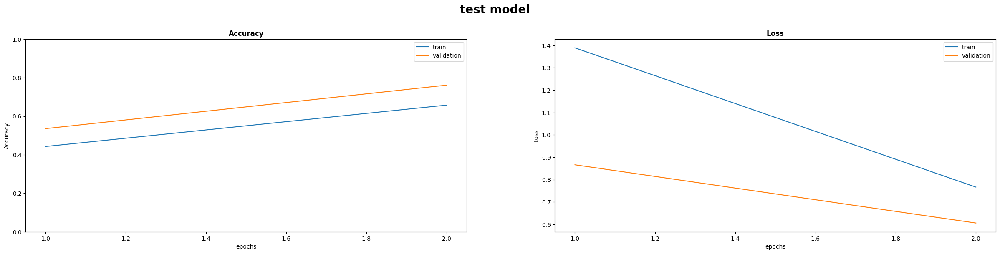



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



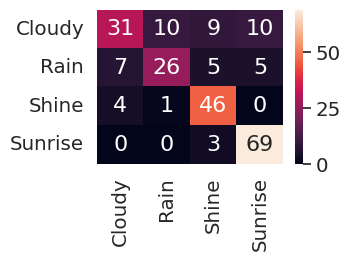



               precision    recall  f1-score   support

           0     0.7381    0.5167    0.6078        60
           1     0.7027    0.6047    0.6500        43
           2     0.7302    0.9020    0.8070        51
           3     0.8214    0.9583    0.8846        72

    accuracy                         0.7611       226
   macro avg     0.7481    0.7454    0.7374       226
weighted avg     0.7561    0.7611    0.7490       226
 



test model: 

╒════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers   │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                    │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════════════╪══════════════════════════════════╪════

In [ ]:
history = print_full_results("test model", model, history_, validation_generator)

###Simple Model with Adam

 Simple Model with Adam and Relu

In [ ]:
tuner = simple_tuner_run(epochs=20, max_trial=5, optimizer=optimizers["Adam"], activation_function="relu")

Trial 5 Complete [00h 03m 09s]
val_accuracy: 0.8628318309783936

Best val_accuracy So Far: 0.8628318309783936
Total elapsed time: 00h 15m 31s
INFO:tensorflow:Oracle triggered exit


In [ ]:
best_learning_rate_simple_adam_relu = results(tuner)

Results summary
Results in models/my_dir/simple_model_Adam_relu
Showing 1 best trials
Trial summary
Hyperparameters:
learning_rate: 0.0010142202510360857
n_layers: 7
units_0: 96
units_1: 224
units_2: 96
units_3: 192
units_4: 256
units_5: 128
units_6: 128
Score: 0.8008849620819092


learning_rate: 0.0010142202510360857


Note that the model will not be trained for 200 epochs due to early stopping

It will quit some time earlier

In [ ]:
simple_adam_relu_Structure = [96, 224, 96, 192, 256, 128, 128]
history_simple_adam_relu_, model = create_simple_model(units=simple_adam_relu_Structure, activation_function="relu",
                                                      optimizer=optimizers["Adam"], lr=0.0010142202510360857, epochs=30)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten (Flatten)           (None, 49152)             0         
                                                                 
 dense (Dense)               (None, 96)                4718688   
                                                                 
 dense_1 (Dense)             (None, 224)               21728     
                                                                 
 dense_2 (Dense)             (None, 96)                21600     
                                                                 
 dense_3 (Dense)             (None, 192)               18624     
                                                                 
 dense_4 (Dense)             (None, 256)               49408     
                                                                 
 dense_5 (Dense)             (None, 128)               3

0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 1s 180ms/step - loss: 0.4815 - accuracy: 0.7788


Plots:




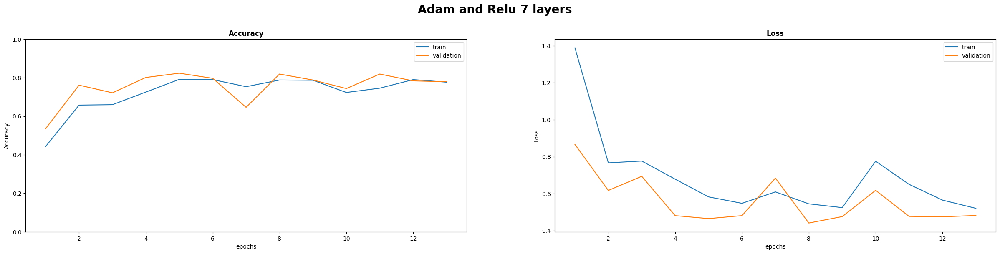



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



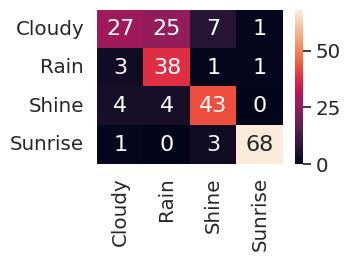



               precision    recall  f1-score   support

           0     0.7714    0.4500    0.5684        60
           1     0.5672    0.8837    0.6909        43
           2     0.7963    0.8431    0.8190        51
           3     0.9714    0.9444    0.9577        72

    accuracy                         0.7788       226
   macro avg     0.7766    0.7803    0.7590       226
weighted avg     0.8019    0.7788    0.7723       226
 



Adam and Relu 7 layers: 

╒════════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers       │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                        │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════════════════╪═══════════

In [ ]:
history_simple_adam_relu = print_full_results("Adam and Relu 7 layers", model, history_simple_adam_relu_, validation_generator)

Simple Model with Adam and Sigmoid

In [ ]:
tuner = simple_tuner_run(epochs=5, max_trial=3, optimizer=optimizers["Adam"], activation_function="sigmoid")

Trial 3 Complete [00h 01m 19s]
val_accuracy: 0.5265486836433411

Best val_accuracy So Far: 0.5707964897155762
Total elapsed time: 00h 03m 57s
INFO:tensorflow:Oracle triggered exit


In [ ]:
best_learning_rate_simple_adam_sigmoid = results(tuner)

Results summary
Results in models/my_dir/simple_model_Adam_sigmoid
Showing 1 best trials
Trial summary
Hyperparameters:
learning_rate: 0.0010142202510360857
n_layers: 7
units_0: 96
units_1: 224
units_2: 96
units_3: 192
units_4: 256
units_5: 128
units_6: 128
Score: 0.5707964897155762


learning_rate: 0.0010142202510360857


Note that the model will not be trained for 200 epochs due to early stopping

It will quit some time earlier

In [ ]:
simple_adam_sigmoid_Structure = [96, 224, 96, 192, 256, 128, 128]
history_simple_adam_sigmoid_, model = create_simple_model(units=simple_adam_sigmoid_Structure, activation_function="sigmoid",
                                                      optimizer=optimizers["Adam"], lr=0.0010142202510360857, epochs=30)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten (Flatten)           (None, 49152)             0         
                                                                 
 dense (Dense)               (None, 96)                4718688   
                                                                 
 dense_1 (Dense)             (None, 224)               21728     
                                                                 
 dense_2 (Dense)             (None, 96)                21600     
                                                                 
 dense_3 (Dense)             (None, 192)               18624     
                                                                 
 dense_4 (Dense)             (None, 256)               49408     
                                                                 
 dense_5 (Dense)             (None, 128)               3

0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 2s 190ms/step - loss: 1.0156 - accuracy: 0.5841


Plots:




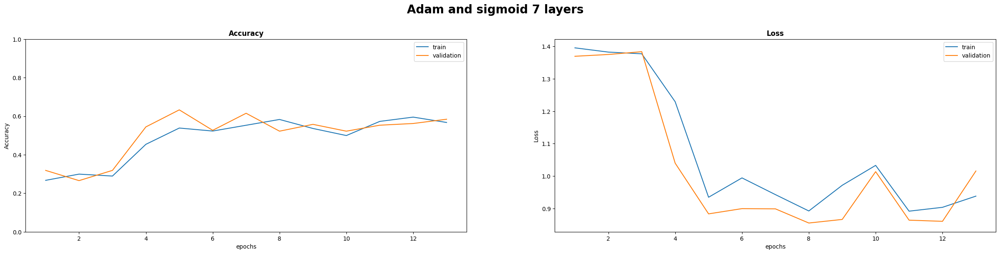



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



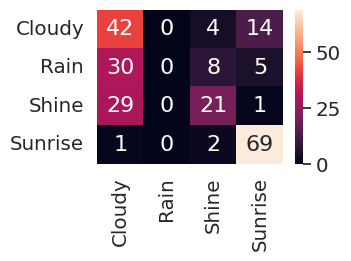



               precision    recall  f1-score   support

           0     0.4118    0.7000    0.5185        60
           1     0.0000    0.0000    0.0000        43
           2     0.6000    0.4118    0.4884        51
           3     0.7753    0.9583    0.8571        72

    accuracy                         0.5841       226
   macro avg     0.4468    0.5175    0.4660       226
weighted avg     0.4917    0.5841    0.5209       226
 



Adam and sigmoid 7 layers: 

╒═══════════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers          │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                           │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════════════════

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
history_simple_adam_sigmoid = print_full_results("Adam and sigmoid 7 layers", model, history_simple_adam_sigmoid_, validation_generator)

Simple Model with Adam and tanh

In [ ]:
tuner = simple_tuner_run(epochs=5, max_trial=3, optimizer=optimizers["Adam"], activation_function="tanh")

Trial 3 Complete [00h 01m 12s]
val_accuracy: 0.6725663542747498

Best val_accuracy So Far: 0.6725663542747498
Total elapsed time: 00h 04m 33s
INFO:tensorflow:Oracle triggered exit


In [ ]:
best_learning_rate_simple_adam_tanh = results(tuner)

Results summary
Results in models/my_dir/simple_model_Adam_tanh
Showing 1 best trials
Trial summary
Hyperparameters:
learning_rate: 0.0011538907663386716
n_layers: 6
units_0: 160
units_1: 32
units_2: 96
units_3: 160
units_4: 32
units_5: 96
units_6: 32
units_7: 224
units_8: 128
units_9: 64
Score: 0.6725663542747498


learning_rate: 0.0011538907663386716


Note that the model will not be trained for 200 epochs due to early stopping

It will quit some time earlier

In [ ]:
simple_adam_tanh_Structure = [160, 32, 96, 160, 32, 96, 32, 224, 128, 64]
history_simple_adam_tanh_, model = create_simple_model(units=simple_adam_tanh_Structure, activation_function="tanh",
                                                      optimizer=optimizers["Adam"], lr=0.0011538907663386716, epochs=30)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten (Flatten)           (None, 49152)             0         
                                                                 
 dense (Dense)               (None, 160)               7864480   
                                                                 
 dense_1 (Dense)             (None, 32)                5152      
                                                                 
 dense_2 (Dense)             (None, 96)                3168      
                                                                 
 dense_3 (Dense)             (None, 160)               15520     
                                                                 
 dense_4 (Dense)             (None, 32)                5152      
                                                                 
 dense_5 (Dense)             (None, 96)                3

0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 1s 184ms/step - loss: 1.3719 - accuracy: 0.3186


Plots:




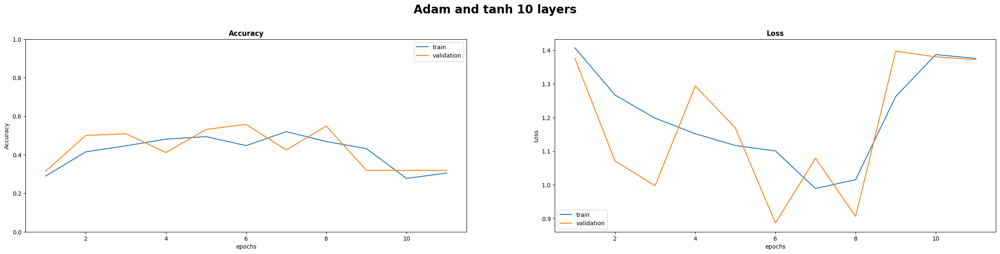



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



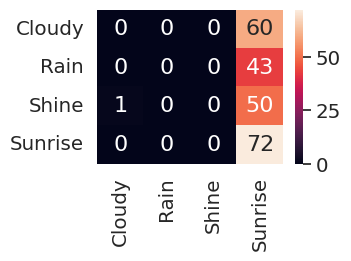



               precision    recall  f1-score   support

           0     0.0000    0.0000    0.0000        60
           1     0.0000    0.0000    0.0000        43
           2     0.0000    0.0000    0.0000        51
           3     0.3200    1.0000    0.4848        72

    accuracy                         0.3186       226
   macro avg     0.0800    0.2500    0.1212       226
weighted avg     0.1019    0.3186    0.1545       226
 



Adam and tanh 10 layers: 

╒═════════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers        │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                         │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞═════════════════════════╪══════

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
history_simple_adam_tanh = print_full_results("Adam and tanh 10 layers", model, history_simple_adam_tanh_, validation_generator)

#### Results of simple model Adam optimzer

In [ ]:
print(colored("Adam models:\n", 'yellow', attrs=['bold']), "\n")
print(print_table(
    [find_max_i(history_simple_adam_relu), find_max_i(history_simple_adam_sigmoid), find_max_i(history_simple_adam_tanh) ],
    head=["Number of Layers",
          "Accuracy and Loss of train set\naccording to Min train Loss",
          "Accuracy and Loss of val set\naccording to Min val Loss",
          "Accuracy and Loss of train set\naccording to Max train Accuracy",
          "Accuracy and Loss of val set\naccording to Max val Accuracy"],
    rows=[f"Adam and relu {len(simple_adam_relu_Structure)} layers\nlr={best_learning_rate_simple_adam_relu}",
          f"Adam and sigmoid {len(simple_adam_sigmoid_Structure)} layers\nlr={best_learning_rate_simple_adam_sigmoid}",
          f"Adam and tanh {len(simple_adam_tanh_Structure)} layers\nlr={best_learning_rate_simple_adam_tanh}", ]))

Adam models:
 

╒═══════════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers          │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                           │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞═══════════════════════════╪══════════════════════════════════╪════════════════════════════════╪═══════════════════════════════════╪═════════════════════════════════╡
│ Adam and relu 7 layers    │ (epoch index:12)                 │ (epoch index:7)                │ (epoch index:4)                   │ (epoch index:4)                 │
│ lr=0.0010142202510360857  │ Accuracy: 0.7764182686805725     │ Accuracy: 0.8185840845108032   │ Accuracy: 0.7908787727355957      │ Accuracy: 

###Simple Model with SGD

 Simple Model with SGD and Relu

In [ ]:
tuner = simple_tuner_run(epochs=5, max_trial=3, optimizer=optimizers["SGD"], activation_function="relu")

Trial 3 Complete [00h 00m 53s]
val_accuracy: 0.8097345232963562

Best val_accuracy So Far: 0.8097345232963562
Total elapsed time: 00h 02m 40s
INFO:tensorflow:Oracle triggered exit


In [ ]:
best_learning_rate_simple_sgd_relu = results(tuner)

Results summary
Results in models/my_dir/simple_model_SGD_relu
Showing 1 best trials
Trial summary
Hyperparameters:
learning_rate: 0.0011538907663386716
n_layers: 6
units_0: 160
units_1: 32
units_2: 96
units_3: 160
units_4: 32
units_5: 96
units_6: 32
units_7: 224
units_8: 128
units_9: 64
Score: 0.8097345232963562


learning_rate: 0.0011538907663386716


Note that the model will not be trained for 200 epochs due to early stopping

It will quit some time earlier

In [ ]:
simple_sgd_relu_Structure = [160, 32, 96, 160, 32, 96, 32, 224, 128, 64]
history_simple_sgd_relu_, model = create_simple_model(units=simple_sgd_relu_Structure, activation_function="relu",
                                                      optimizer=optimizers["SGD"], lr=0.0011538907663386716, epochs=30)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten (Flatten)           (None, 49152)             0         
                                                                 
 dense (Dense)               (None, 160)               7864480   
                                                                 
 dense_1 (Dense)             (None, 32)                5152      
                                                                 
 dense_2 (Dense)             (None, 96)                3168      
                                                                 
 dense_3 (Dense)             (None, 160)               15520     
                                                                 
 dense_4 (Dense)             (None, 32)                5152      
                                                                 
 dense_5 (Dense)             (None, 96)                3

0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 2s 187ms/step - loss: 0.7583 - accuracy: 0.7566


Plots:




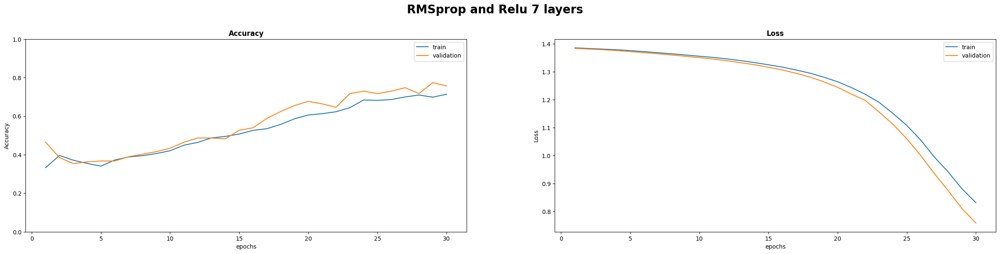



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



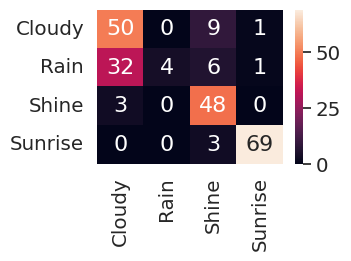



               precision    recall  f1-score   support

           0     0.5882    0.8333    0.6897        60
           1     1.0000    0.0930    0.1702        43
           2     0.7273    0.9412    0.8205        51
           3     0.9718    0.9583    0.9650        72

    accuracy                         0.7566       226
   macro avg     0.8218    0.7065    0.6614       226
weighted avg     0.8202    0.7566    0.7081       226
 



RMSprop and Relu 7 layers: 

╒═══════════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers          │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                           │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════════════════

In [ ]:
history_simple_sgd_relu = print_full_results("RMSprop and Relu 7 layers", model, history_simple_sgd_relu_, validation_generator)

 Simple Model with SGD and Sigmoid

In [ ]:
tuner = simple_tuner_run(epochs=5, max_trial=3, optimizer=optimizers["SGD"], activation_function="sigmoid")

Trial 3 Complete [00h 00m 54s]
val_accuracy: 0.3185840845108032

Best val_accuracy So Far: 0.3185840845108032
Total elapsed time: 00h 03m 18s
INFO:tensorflow:Oracle triggered exit


In [ ]:
best_learning_rate_simple_sgd_sigmoid = results(tuner)

Results summary
Results in models/my_dir/simple_model_SGD_sigmoid
Showing 1 best trials
Trial summary
Hyperparameters:
learning_rate: 0.0010142202510360857
n_layers: 7
units_0: 96
units_1: 224
units_2: 96
units_3: 192
units_4: 256
units_5: 128
units_6: 128
Score: 0.3185840845108032


learning_rate: 0.0010142202510360857


Note that the model will not be trained for 200 epochs due to early stopping

It will quit some time earlier

In [ ]:
simple_sgd_sigmoid_Structure = [96, 224, 96, 192, 256, 128, 128]
history_simple_sgd_sigmoid_, model = create_simple_model(units=simple_sgd_sigmoid_Structure, activation_function="sigmoid",
                                                      optimizer=optimizers["SGD"], lr=0.0010142202510360857, epochs=30)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten (Flatten)           (None, 49152)             0         
                                                                 
 dense (Dense)               (None, 96)                4718688   
                                                                 
 dense_1 (Dense)             (None, 224)               21728     
                                                                 
 dense_2 (Dense)             (None, 96)                21600     
                                                                 
 dense_3 (Dense)             (None, 192)               18624     
                                                                 
 dense_4 (Dense)             (None, 256)               49408     
                                                                 
 dense_5 (Dense)             (None, 128)               3

0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 2s 186ms/step - loss: 1.3682 - accuracy: 0.3186


Plots:




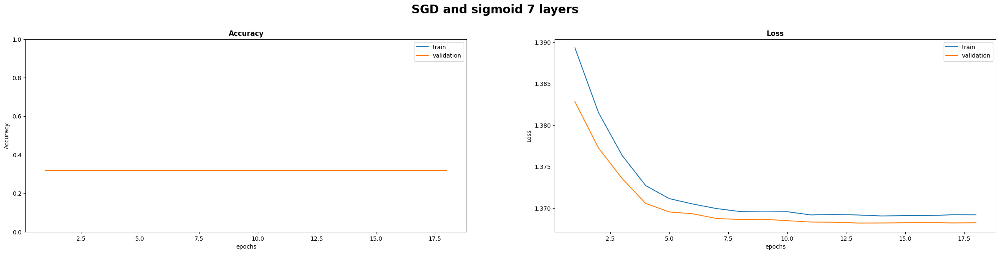



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



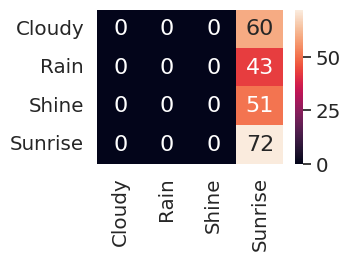



               precision    recall  f1-score   support

           0     0.0000    0.0000    0.0000        60
           1     0.0000    0.0000    0.0000        43
           2     0.0000    0.0000    0.0000        51
           3     0.3186    1.0000    0.4832        72

    accuracy                         0.3186       226
   macro avg     0.0796    0.2500    0.1208       226
weighted avg     0.1015    0.3186    0.1539       226
 



SGD and sigmoid 7 layers: 

╒══════════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers         │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                          │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞══════════════════════════╪═

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
history_simple_sgd_sigmoid = print_full_results("SGD and sigmoid 7 layers", model, history_simple_sgd_sigmoid_, validation_generator)

 Simple Model with SGD and tanh

In [ ]:
tuner = simple_tuner_run(epochs=5, max_trial=3, optimizer=optimizers["SGD"], activation_function="tanh")

Trial 3 Complete [00h 00m 53s]
val_accuracy: 0.8185840845108032

Best val_accuracy So Far: 0.8230088353157043
Total elapsed time: 00h 02m 53s
INFO:tensorflow:Oracle triggered exit


In [ ]:
best_learning_rate_simple_sgd_tanh = results(tuner)

Results summary
Results in models/my_dir/simple_model_SGD_tanh
Showing 1 best trials
Trial summary
Hyperparameters:
learning_rate: 0.0010142202510360857
n_layers: 7
units_0: 96
units_1: 224
units_2: 96
units_3: 192
units_4: 256
units_5: 128
units_6: 128
Score: 0.8230088353157043


learning_rate: 0.0010142202510360857


Note that the model will not be trained for 200 epochs due to early stopping

It will quit some time earlier

In [ ]:
simple_sgd_tanh_Structure = [96, 224, 96, 192, 256, 128, 128]
history_simple_sgd_tanh_, model = create_simple_model(units=simple_sgd_tanh_Structure, activation_function="tanh",
                                                      optimizer=optimizers["SGD"], lr=0.0010142202510360857, epochs=30)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten (Flatten)           (None, 49152)             0         
                                                                 
 dense (Dense)               (None, 96)                4718688   
                                                                 
 dense_1 (Dense)             (None, 224)               21728     
                                                                 
 dense_2 (Dense)             (None, 96)                21600     
                                                                 
 dense_3 (Dense)             (None, 192)               18624     
                                                                 
 dense_4 (Dense)             (None, 256)               49408     
                                                                 
 dense_5 (Dense)             (None, 128)               3

0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 1s 185ms/step - loss: 0.4232 - accuracy: 0.8451


Plots:




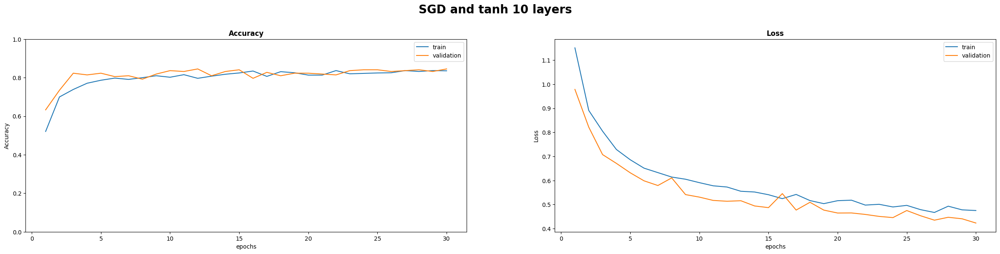



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



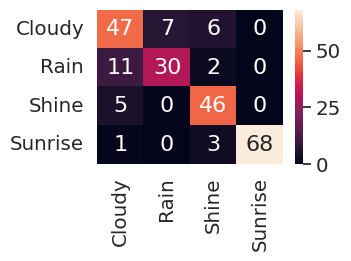



               precision    recall  f1-score   support

           0     0.7344    0.7833    0.7581        60
           1     0.8108    0.6977    0.7500        43
           2     0.8070    0.9020    0.8519        51
           3     1.0000    0.9444    0.9714        72

    accuracy                         0.8451       226
   macro avg     0.8381    0.8319    0.8328       226
weighted avg     0.8499    0.8451    0.8457       226
 



SGD and tanh 10 layers: 

╒════════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers       │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                        │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════════════════╪═══════════

In [ ]:
history_simple_sgd_tanh = print_full_results("SGD and tanh 10 layers", model, history_simple_sgd_tanh_, validation_generator)

#### Results of simple model SGD optimzer

In [ ]:
print(colored("SGD models:\n", 'yellow', attrs=['bold']), "\n")
print(print_table(
    [find_max_i(history_simple_sgd_relu), find_max_i(history_simple_sgd_sigmoid), find_max_i(history_simple_sgd_tanh) ],
    head=["Number of Layers",
          "Accuracy and Loss of train set\naccording to Min train Loss",
          "Accuracy and Loss of val set\naccording to Min val Loss",
          "Accuracy and Loss of train set\naccording to Max train Accuracy",
          "Accuracy and Loss of val set\naccording to Max val Accuracy"],
    rows=[f"SGD and relu {len(simple_sgd_relu_Structure)} layers\nlr={best_learning_rate_simple_sgd_relu}",
          f"SGD and sigmoid {len(simple_sgd_sigmoid_Structure)} layers\nlr={best_learning_rate_simple_sgd_sigmoid}",
          f"SGD and tanh {len(simple_sgd_tanh_Structure)} layers\nlr={best_learning_rate_simple_sgd_tanh}", ]))

SGD models:
 

╒══════════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers         │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                          │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞══════════════════════════╪══════════════════════════════════╪════════════════════════════════╪═══════════════════════════════════╪═════════════════════════════════╡
│ SGD and relu 10 layers   │ (epoch index:29)                 │ (epoch index:29)               │ (epoch index:29)                  │ (epoch index:28)                │
│ lr=0.0011538907663386716 │ Accuracy: 0.7141268253326416     │ Accuracy: 0.7566371560096741   │ Accuracy: 0.7141268253326416      │ Accuracy: 0.77433

###Simple Model with RMSporp

 Simple Model with RMSporp and Relu

In [ ]:
tuner = simple_tuner_run(epochs=5, max_trial=3, optimizer=optimizers["RMSprop"], activation_function="relu")

Trial 3 Complete [00h 00m 55s]
val_accuracy: 0.6460176706314087

Best val_accuracy So Far: 0.6460176706314087
Total elapsed time: 00h 03m 07s
INFO:tensorflow:Oracle triggered exit


In [ ]:
best_learning_rate_simple_rmsprop_relu = results(tuner)

Results summary
Results in models/my_dir/simple_model_RMSprop_relu
Showing 1 best trials
Trial summary
Hyperparameters:
learning_rate: 0.0011538907663386716
n_layers: 6
units_0: 160
units_1: 32
units_2: 96
units_3: 160
units_4: 32
units_5: 96
units_6: 32
units_7: 224
units_8: 128
units_9: 64
Score: 0.6460176706314087


learning_rate: 0.0011538907663386716


Note that the model will not be trained for 200 epochs due to early stopping

It will quit some time earlier

In [ ]:
simple_rmsprop_relu_Structure = [256, 160 , 160, 96, 128, 192, 64, 128, 128, 128]
history_simple_rmsprop_relu_, model = create_simple_model(units=simple_rmsprop_relu_Structure, activation_function="relu",
                                                      optimizer=optimizers["RMSprop"], lr=0.0011538907663386716, epochs=30)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten (Flatten)           (None, 49152)             0         
                                                                 
 dense (Dense)               (None, 256)               12583168  
                                                                 
 dense_1 (Dense)             (None, 160)               41120     
                                                                 
 dense_2 (Dense)             (None, 160)               25760     
                                                                 
 dense_3 (Dense)             (None, 96)                15456     
                                                                 
 dense_4 (Dense)             (None, 128)               12416     
                                                                 
 dense_5 (Dense)             (None, 192)               2

0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 1s 180ms/step - loss: 0.4049 - accuracy: 0.8496


Plots:




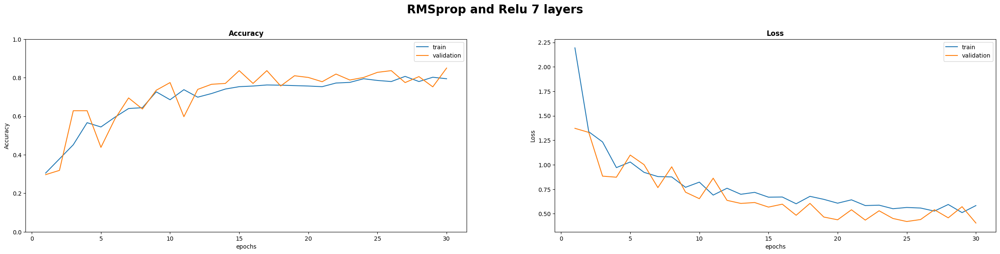



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



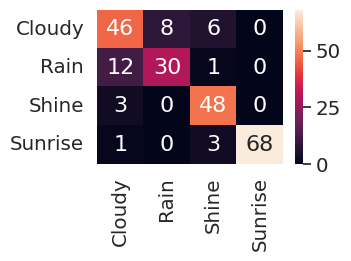



               precision    recall  f1-score   support

           0     0.7419    0.7667    0.7541        60
           1     0.7895    0.6977    0.7407        43
           2     0.8276    0.9412    0.8807        51
           3     1.0000    0.9444    0.9714        72

    accuracy                         0.8496       226
   macro avg     0.8397    0.8375    0.8368       226
weighted avg     0.8525    0.8496    0.8494       226
 



RMSprop and Relu 7 layers: 

╒═══════════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers          │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                           │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════════════════

In [ ]:
history_simple_rmsprop_relu = print_full_results("RMSprop and Relu 7 layers", model, history_simple_rmsprop_relu_, validation_generator)

Simple Model with RMSporp and Sigmoid

In [ ]:
tuner = simple_tuner_run(epochs=5, max_trial=3, optimizer=optimizers["RMSprop"], activation_function="sigmoid")

Trial 3 Complete [00h 00m 54s]
val_accuracy: 0.5530973672866821

Best val_accuracy So Far: 0.5530973672866821
Total elapsed time: 00h 02m 47s
INFO:tensorflow:Oracle triggered exit


In [ ]:
best_learning_rate_simple_rmsprop_sigmoid = results(tuner)

Results summary
Results in models/my_dir/simple_model_RMSprop_sigmoid
Showing 1 best trials
Trial summary
Hyperparameters:
learning_rate: 0.0011538907663386716
n_layers: 6
units_0: 160
units_1: 32
units_2: 96
units_3: 160
units_4: 32
units_5: 96
units_6: 32
units_7: 224
units_8: 128
units_9: 64
Score: 0.5530973672866821


learning_rate: 0.0011538907663386716


Note that the model will not be trained for 200 epochs due to early stopping

It will quit some time earlier

In [ ]:
simple_rmsprop_sigmoid_Structure = [160, 32, 96, 160, 32, 96, 32, 224, 128, 64]
history_simple_rmsprop_sigmoid_, model = create_simple_model(units=simple_rmsprop_sigmoid_Structure, activation_function="sigmoid",
                                                      optimizer=optimizers["RMSprop"], lr=0.5663716793060303, epochs=30)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten (Flatten)           (None, 49152)             0         
                                                                 
 dense (Dense)               (None, 160)               7864480   
                                                                 
 dense_1 (Dense)             (None, 32)                5152      
                                                                 
 dense_2 (Dense)             (None, 96)                3168      
                                                                 
 dense_3 (Dense)             (None, 160)               15520     
                                                                 
 dense_4 (Dense)             (None, 32)                5152      
                                                                 
 dense_5 (Dense)             (None, 96)                3

0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 1s 187ms/step - loss: 14.3332 - accuracy: 0.1903


Plots:




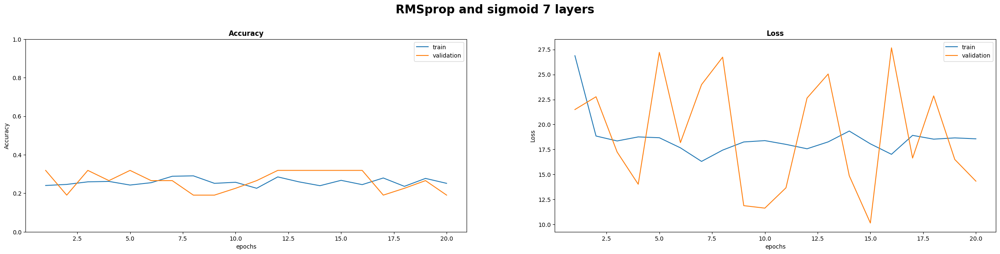



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



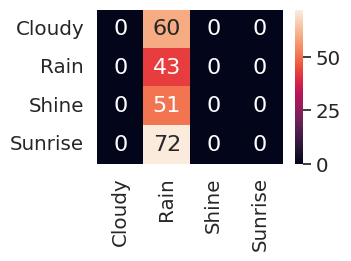



               precision    recall  f1-score   support

           0     0.0000    0.0000    0.0000        60
           1     0.1903    1.0000    0.3197        43
           2     0.0000    0.0000    0.0000        51
           3     0.0000    0.0000    0.0000        72

    accuracy                         0.1903       226
   macro avg     0.0476    0.2500    0.0799       226
weighted avg     0.0362    0.1903    0.0608       226
 



RMSprop and sigmoid 7 layers: 

╒══════════════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers             │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                              │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
history_simple_rmsprop_sigmoid = print_full_results("RMSprop and sigmoid 7 layers", model, history_simple_rmsprop_sigmoid_, validation_generator)

Simple Model with RMSporp and tanh

In [ ]:
tuner = simple_tuner_run(epochs=5, max_trial=3, optimizer=optimizers["RMSprop"], activation_function="tanh")

Trial 3 Complete [00h 01m 04s]
val_accuracy: 0.6061946749687195

Best val_accuracy So Far: 0.6061946749687195
Total elapsed time: 00h 03m 03s
INFO:tensorflow:Oracle triggered exit


In [ ]:
best_learning_rate_simple_rmsprop_tanh = results(tuner)

Results summary
Results in models/my_dir/simple_model_RMSprop_tanh
Showing 1 best trials
Trial summary
Hyperparameters:
learning_rate: 0.0010142202510360857
n_layers: 7
units_0: 96
units_1: 224
units_2: 96
units_3: 192
units_4: 256
units_5: 128
units_6: 128
Score: 0.6061946749687195


learning_rate: 0.0010142202510360857


Note that the model will not be trained for 200 epochs due to early stopping

It will quit some time earlier

In [ ]:
simple_rmsprop_tanh_Structure = [96, 224, 96, 192, 256, 128, 128]
history_simple_rmsprop_tanh_, model = create_simple_model(units=simple_rmsprop_tanh_Structure, activation_function="tanh",
                                                      optimizer=optimizers["RMSprop"], lr=0.0010142202510360857, epochs=30)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten (Flatten)           (None, 49152)             0         
                                                                 
 dense (Dense)               (None, 96)                4718688   
                                                                 
 dense_1 (Dense)             (None, 224)               21728     
                                                                 
 dense_2 (Dense)             (None, 96)                21600     
                                                                 
 dense_3 (Dense)             (None, 192)               18624     
                                                                 
 dense_4 (Dense)             (None, 256)               49408     
                                                                 
 dense_5 (Dense)             (None, 128)               3

0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 1s 180ms/step - loss: 1.5529 - accuracy: 0.4558


Plots:




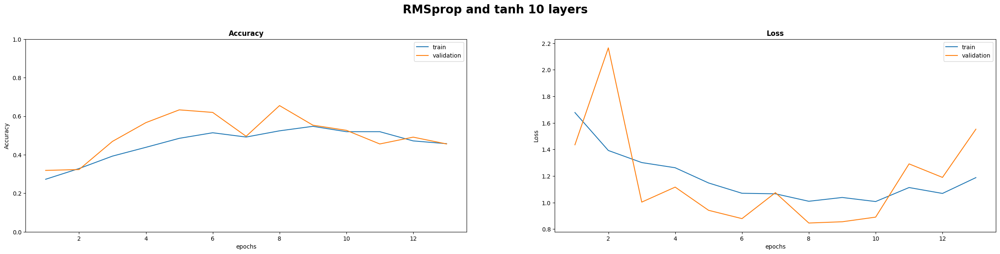



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



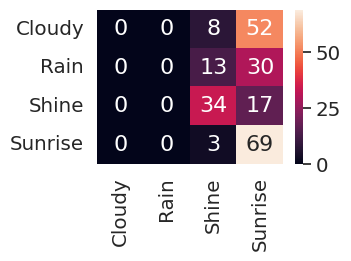



               precision    recall  f1-score   support

           0     0.0000    0.0000    0.0000        60
           1     0.0000    0.0000    0.0000        43
           2     0.5862    0.6667    0.6239        51
           3     0.4107    0.9583    0.5750        72

    accuracy                         0.4558       226
   macro avg     0.2492    0.4062    0.2997       226
weighted avg     0.2631    0.4558    0.3240       226
 



RMSprop and tanh 10 layers: 

╒════════════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers           │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                            │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════════════

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
history_simple_rmsprop_tanh = print_full_results("RMSprop and tanh 10 layers", model, history_simple_rmsprop_tanh_, validation_generator)

#### Results of simple model RMSporp optimzer

In [ ]:
print(colored("RMSprop models:\n", 'yellow', attrs=['bold']), "\n")
print(print_table(
    [find_max_i(history_simple_rmsprop_relu), find_max_i(history_simple_rmsprop_sigmoid), find_max_i(history_simple_rmsprop_tanh) ],
    head=["Number of Layers",
          "Accuracy and Loss of train set\naccording to Min train Loss",
          "Accuracy and Loss of val set\naccording to Min val Loss",
          "Accuracy and Loss of train set\naccording to Max train Accuracy",
          "Accuracy and Loss of val set\naccording to Max val Accuracy"],
    rows=[f"RMSprop and relu {len(simple_rmsprop_relu_Structure)} layers\nlr={best_learning_rate_simple_rmsprop_relu}",
          f"RMSprop and sigmoid {len(simple_rmsprop_sigmoid_Structure)} layers\nlr={best_learning_rate_simple_rmsprop_sigmoid}",
          f"RMSprop and tanh {len(simple_rmsprop_tanh_Structure)} layers\nlr={best_learning_rate_simple_rmsprop_tanh}", ]))

RMSprop models:
 

╒═══════════════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers              │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                               │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞═══════════════════════════════╪══════════════════════════════════╪════════════════════════════════╪═══════════════════════════════════╪═════════════════════════════════╡
│ RMSprop and relu 10 layers    │ (epoch index:28)                 │ (epoch index:29)               │ (epoch index:26)                  │ (epoch index:29)                │
│ lr=0.0011538907663386716      │ Accuracy: 0.8020022511482239     │ Accuracy: 0.8495575189590454   │ Accuracy: 0.8064516

### Simple model results

In [ ]:
print(colored("Simple models:\n", 'yellow', attrs=['bold']), "\n")
print(print_table(
    [find_max_i(history_simple_adam_relu), find_max_i(history_simple_adam_sigmoid), find_max_i(history_simple_adam_tanh),
     find_max_i(history_simple_sgd_relu), find_max_i(history_simple_sgd_sigmoid), find_max_i(history_simple_sgd_tanh),
     find_max_i(history_simple_rmsprop_relu), find_max_i(history_simple_rmsprop_sigmoid), find_max_i(history_simple_rmsprop_tanh)],
    head=["Number of Layers",
          "Accuracy and Loss of train set\naccording to Min train Loss",
          "Accuracy and Loss of val set\naccording to Min val Loss",
          "Accuracy and Loss of train set\naccording to Max train Accuracy",
          "Accuracy and Loss of val set\naccording to Max val Accuracy"],
    rows=[
        f"Adam and relu {len(simple_adam_relu_Structure)} layers\nlr={best_learning_rate_simple_adam_relu}",
        f"Adam and sigmoid {len(simple_adam_sigmoid_Structure)} layers\nlr={best_learning_rate_simple_adam_sigmoid}",
        f"Adam and tanh {len(simple_adam_tanh_Structure)} layers\nlr={best_learning_rate_simple_adam_tanh}",

        f"SGD and relu {len(simple_sgd_relu_Structure)} layers\nlr={best_learning_rate_simple_sgd_relu}",
        f"SGD and sigmoid {len(simple_sgd_sigmoid_Structure)} layers\nlr={best_learning_rate_simple_sgd_sigmoid}",
        f"SGD and tanh {len(simple_sgd_tanh_Structure)} layers\nlr={best_learning_rate_simple_sgd_tanh}",

        f"RMSprop and relu {len(simple_rmsprop_relu_Structure)} layers\nlr={best_learning_rate_simple_rmsprop_relu}",
        f"RMSprop and sigmoid {len(simple_rmsprop_sigmoid_Structure)} layers\nlr={best_learning_rate_simple_rmsprop_sigmoid}",
        f"RMSprop and tanh {len(simple_rmsprop_tanh_Structure)} layers\nlr={best_learning_rate_simple_rmsprop_tanh}", ]))

Simple models:
 

╒═══════════════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers              │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                               │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞═══════════════════════════════╪══════════════════════════════════╪════════════════════════════════╪═══════════════════════════════════╪═════════════════════════════════╡
│ Adam and relu 7 layers        │ (epoch index:12)                 │ (epoch index:7)                │ (epoch index:4)                   │ (epoch index:4)                 │
│ lr=0.0010142202510360857      │ Accuracy: 0.7764182686805725     │ Accuracy: 0.8185840845108032   │ Accuracy: 0.79087877

## Convolution Nural Netwrok


We will follow [this kaggle article](https://www.kaggle.com/code/cdeotte/how-to-choose-cnn-architecture-mnist/notebook) about choosing the architecture of our NN

### simple Conv2d models

<div>
<img src="https://drive.google.com/uc?export=view&id=11m7JWErHn1GYeMFMSOMt63utfrfB76Nj" alt="CNN example" width="600"/>
</div>


In [ ]:
def simple_conv2model(convlayers=1, epochs=1, kernel_size=5, strides=1, padding='same', dense=64, lr=0.0011538907663386716):
    tf.keras.backend.clear_session()

    # fixing the seed
    set_random_seed()

    model = tf.keras.Sequential()

    # input layer
    model.add(tf.keras.layers.Conv2D(filters=16, kernel_size=5, strides=1, padding='same', activation='relu', input_shape=(avg_height, avg_width, 3)))
    if convlayers > 1:  # 2 conv layers
        model.add(tf.keras.layers.Conv2D(filters=32, kernel_size=5, strides=1, padding='same', activation='relu'))
    if convlayers > 2:  # 3 conv layers
        model.add(tf.keras.layers.Conv2D(filters=48, kernel_size=5, strides=1, padding='same', activation='relu'))

    #  flatten
    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(64, activation='relu'))

    # output layer
    model.add(Dense(4, activation='softmax'))

    # print model summary
    model.summary()

    # compiling the model
    model.compile(loss='categorical_crossentropy',
                  optimizer=Adam(lr),
                  metrics=['accuracy'],)

    # regenrating the sets
    print()
    train_generator, validation_generator = generate_sets()
    print()
    print()

    # defining early stop
    # patience is the number of epochs if there is no improvement, the algorithm will early stop.
    stop_early = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)

    # training the model
    hist_inc = model.fit(train_generator,
                         validation_data=validation_generator,
                         epochs=epochs,
                         steps_per_epoch=int(np.ceil(train_generator.samples / train_generator.batch_size)),  # ~28
                         verbose=0,
                         callbacks=[stop_early, TqdmCallback(verbose=0)])

    return hist_inc, model


#### simple conv nC

simple conv 1C

In [ ]:
history_simple_conv2d_1_, model = simple_conv2model(convlayers=1, epochs=200, kernel_size=5, strides=1, padding='same', dense=64, lr=0.0011538907663386716)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 16)      1216      
                                                                 
 flatten (Flatten)           (None, 262144)            0         
                                                                 
 dense (Dense)               (None, 64)                16777280  
                                                                 
 dense_1 (Dense)             (None, 4)                 260       
                                                                 
Total params: 16,778,756
Trainable params: 16,778,756
Non-trainable params: 0
_________________________________________________________________

Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.




0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 1s 184ms/step - loss: 0.4050 - accuracy: 0.8717


Plots:




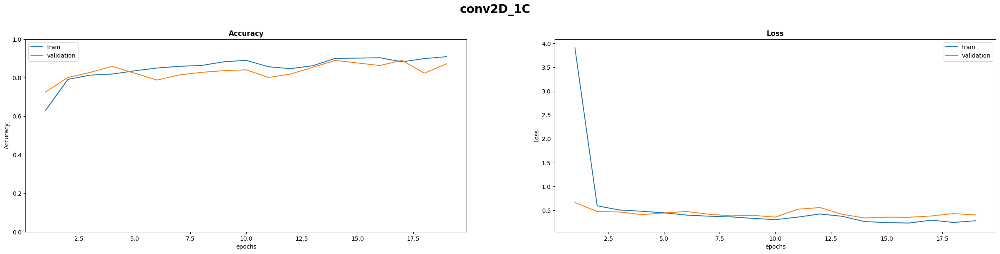



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



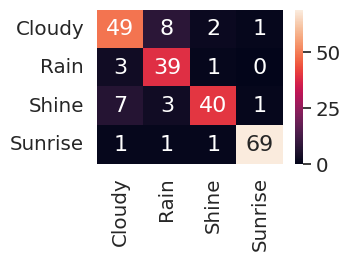



               precision    recall  f1-score   support

           0     0.8167    0.8167    0.8167        60
           1     0.7647    0.9070    0.8298        43
           2     0.9091    0.7843    0.8421        51
           3     0.9718    0.9583    0.9650        72

    accuracy                         0.8717       226
   macro avg     0.8656    0.8666    0.8634       226
weighted avg     0.8771    0.8717    0.8722       226
 



conv2D_1C: 

╒════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers   │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                    │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════════════╪══════════════════════════════════╪═════

In [ ]:
history_simple_conv2d_1 = print_full_results("conv2D_1C", model, history_simple_conv2d_1_, validation_generator)

simple conv 2C

In [ ]:
history_simple_conv2d_2_, model = simple_conv2model(convlayers=2, epochs=200, kernel_size=5, strides=1, padding='same', dense=256, lr=0.0011538907663386716)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 16)      1216      
                                                                 
 conv2d_1 (Conv2D)           (None, 128, 128, 32)      12832     
                                                                 
 flatten (Flatten)           (None, 524288)            0         
                                                                 
 dense (Dense)               (None, 64)                33554496  
                                                                 
 dense_1 (Dense)             (None, 4)                 260       
                                                                 
Total params: 33,568,804
Trainable params: 33,568,804
Non-trainable params: 0
_________________________________________________________________

Found 899 images belonging to 4 classes.
Fo

0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 2s 196ms/step - loss: 0.3794 - accuracy: 0.8717


Plots:




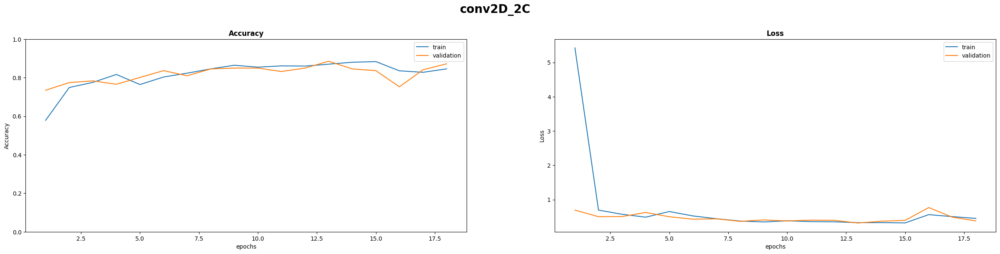



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



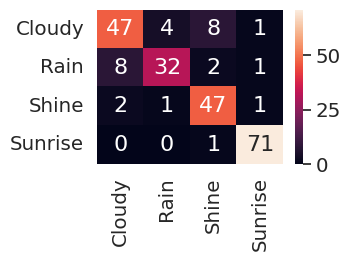



               precision    recall  f1-score   support

           0     0.8246    0.7833    0.8034        60
           1     0.8649    0.7442    0.8000        43
           2     0.8103    0.9216    0.8624        51
           3     0.9595    0.9861    0.9726        72

    accuracy                         0.8717       226
   macro avg     0.8648    0.8588    0.8596       226
weighted avg     0.8720    0.8717    0.8700       226
 



conv2D_2C: 

╒════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers   │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                    │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════════════╪══════════════════════════════════╪═════

In [ ]:
history_simple_conv2d_2 = print_full_results("conv2D_2C", model, history_simple_conv2d_2_, validation_generator)

simple conv 3C

In [ ]:
history_simple_conv2d_3_, model = simple_conv2model(convlayers=3, epochs=200, kernel_size=5, strides=1, padding='same', dense=256, lr=0.0011538907663386716)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 16)      1216      
                                                                 
 conv2d_1 (Conv2D)           (None, 128, 128, 32)      12832     
                                                                 
 conv2d_2 (Conv2D)           (None, 128, 128, 48)      38448     
                                                                 
 flatten (Flatten)           (None, 786432)            0         
                                                                 
 dense (Dense)               (None, 64)                50331712  
                                                                 
 dense_1 (Dense)             (None, 4)                 260       
                                                                 
Total params: 50,384,468
Trainable params: 50,384,468
No

0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 1s 183ms/step - loss: 0.4497 - accuracy: 0.8230


Plots:




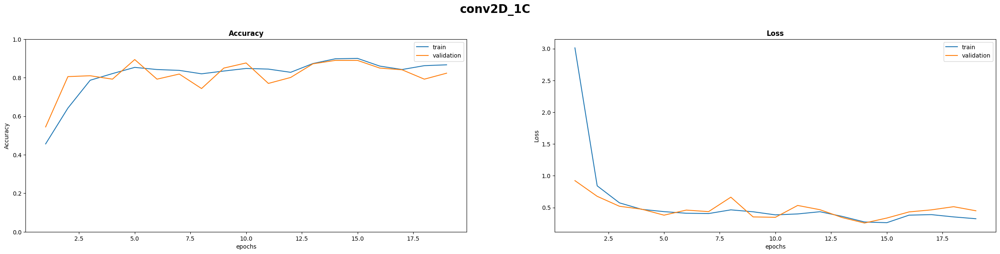



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



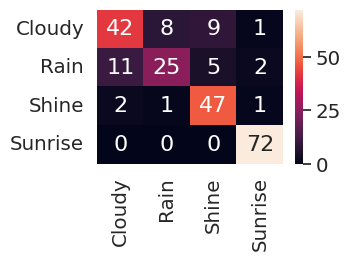



               precision    recall  f1-score   support

           0     0.7636    0.7000    0.7304        60
           1     0.7353    0.5814    0.6494        43
           2     0.7705    0.9216    0.8393        51
           3     0.9474    1.0000    0.9730        72

    accuracy                         0.8230       226
   macro avg     0.8042    0.8007    0.7980       226
weighted avg     0.8183    0.8230    0.8168       226
 



conv2D_1C: 

╒════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers   │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                    │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════════════╪══════════════════════════════════╪═════

In [ ]:
history_simple_conv2d_3 = print_full_results("conv2D_1C", model, history_simple_conv2d_3_, validation_generator)

#### Simple conv2d model results

In [ ]:
print(colored("Simple Conv2D models:\n", 'yellow', attrs=['bold']), "\n")
print(print_table(
    [find_max_i(history_simple_conv2d_1), find_max_i(history_simple_conv2d_2), find_max_i(history_simple_conv2d_3), ],
    head=["Number of Layers",
          "Accuracy and Loss of train set\naccording to Min train Loss",
          "Accuracy and Loss of val set\naccording to Min val Loss",
          "Accuracy and Loss of train set\naccording to Max train Accuracy",
          "Accuracy and Loss of val set\naccording to Max val Accuracy"],
    rows=["Simple Conv2D 1C", "Simple Conv2D 2C", "Simple Conv2D 3C"]))

Simple Conv2D models:
 

╒════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers   │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                    │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════════════╪══════════════════════════════════╪════════════════════════════════╪═══════════════════════════════════╪═════════════════════════════════╡
│ Simple Conv2D 1C   │ (epoch index:15)                 │ (epoch index:13)               │ (epoch index:18)                  │ (epoch index:13)                │
│                    │ Accuracy: 0.9032257795333862     │ Accuracy: 0.8893805146217346   │ Accuracy: 0.9087875485420227      │ Accuracy: 0.8893805146217346    │
│        

Simple Conv2d:




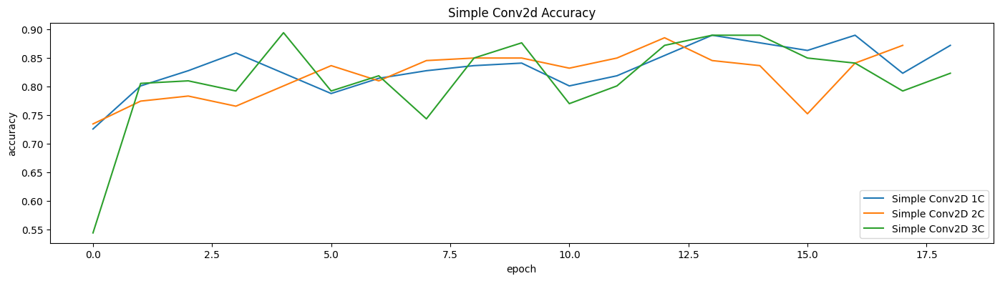

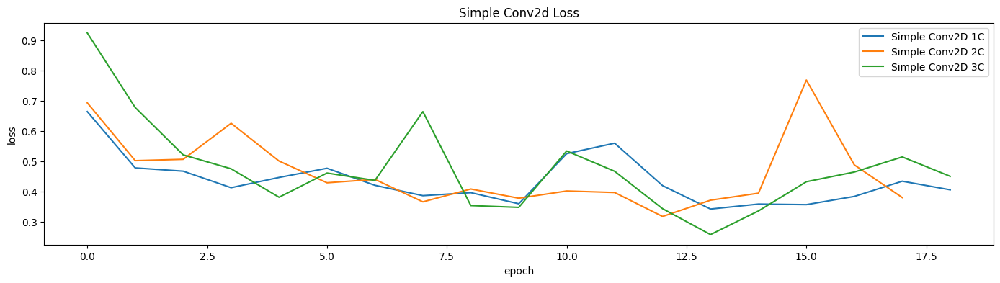

In [ ]:
print(colored("Simple Conv2d:\n\n", 'yellow', attrs=['bold']))
plot_multi_plots(names=["Simple Conv2D 1C", "Simple Conv2D 2C", "Simple Conv2D 3C"],
                 history=[history_simple_conv2d_1, history_simple_conv2d_2, history_simple_conv2d_3],
                 purpose="val_accuracy", title="Simple Conv2d Accuracy", y_label="accuracy")
print()
plot_multi_plots(names=["Simple Conv2D 1C", "Simple Conv2D 2C", "Simple Conv2D 3C"],
                 history=[history_simple_conv2d_1, history_simple_conv2d_2, history_simple_conv2d_3],
                 purpose="val_loss", title="Simple Conv2d Loss", y_label="loss")

### Conv2d models stride, kernel, dilation, padding

In [ ]:
def conv2model_diffrent_parameters (epochs=1, kernel_size=5, strides=1, padding='same', dilation=1, dense=64, lr=0.0010142202510360857, return_model=False):
    tf.keras.backend.clear_session()

    # fixing the seed
    set_random_seed()

    model = tf.keras.Sequential()

    # input layer
    model.add(tf.keras.layers.Conv2D(filters=16, kernel_size=kernel_size, strides=strides, padding=padding, dilation_rate=dilation, activation='relu', input_shape=(avg_height, avg_width, 3)))
    model.add(tf.keras.layers.Conv2D(filters=32, kernel_size=kernel_size, strides=strides, padding=padding, dilation_rate=dilation, activation='relu'))
    model.add(tf.keras.layers.Conv2D(filters=48, kernel_size=kernel_size, strides=strides, padding=padding, dilation_rate=dilation, activation='relu'))

    #  flatten
    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(64, activation='relu'))

    # output layer
    model.add(Dense(4, activation='softmax'))

    # print model summary
    model.summary()

    # compiling the model
    model.compile(loss='categorical_crossentropy',
                  optimizer=Adam(lr),
                  metrics=['accuracy'],)
    if return_model:
      return model

    # regenrating the sets
    print()
    train_generator, validation_generator = generate_sets()
    print()
    print()

    # defining early stop
    # patience is the number of epochs if there is no improvement, the algorithm will early stop.
    stop_early = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)

    # training the model
    hist_inc = model.fit(train_generator,
                         validation_data=validation_generator,
                         epochs=epochs,
                         steps_per_epoch=int(np.ceil(train_generator.samples / train_generator.batch_size)),  # ~28
                         verbose=0,
                         callbacks=[stop_early, TqdmCallback(verbose=0)])

    return hist_inc, model


#### conv2d 3C with different kernels 

simple conv 3C kernel 7

In [ ]:
history_conv2model_diffrent_parameters_kernel7_, model = conv2model_diffrent_parameters(epochs=200, kernel_size=7, strides=1, padding='same', dense=64, lr=0.0010142202510360857)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 16)      2368      
                                                                 
 conv2d_1 (Conv2D)           (None, 128, 128, 32)      25120     
                                                                 
 conv2d_2 (Conv2D)           (None, 128, 128, 48)      75312     
                                                                 
 flatten (Flatten)           (None, 786432)            0         
                                                                 
 dense (Dense)               (None, 64)                50331712  
                                                                 
 dense_1 (Dense)             (None, 4)                 260       
                                                                 
Total params: 50,434,772
Trainable params: 50,434,772
No

0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 2s 193ms/step - loss: 0.3118 - accuracy: 0.8717


Plots:




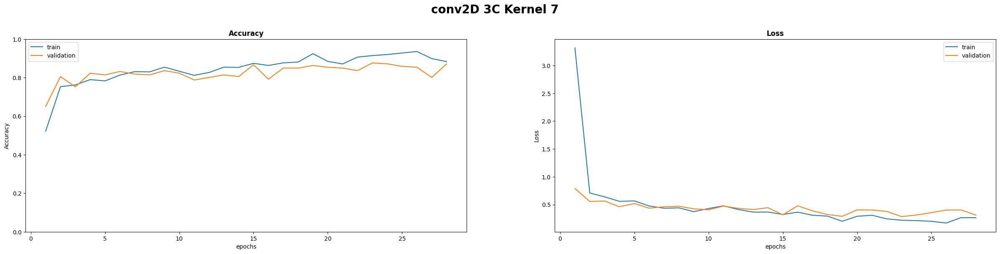



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



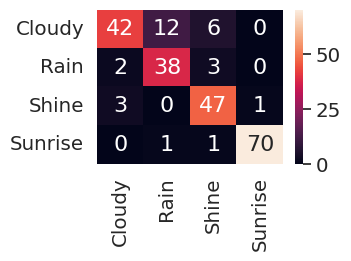



               precision    recall  f1-score   support

           0     0.8936    0.7000    0.7850        60
           1     0.7451    0.8837    0.8085        43
           2     0.8246    0.9216    0.8704        51
           3     0.9859    0.9722    0.9790        72

    accuracy                         0.8717       226
   macro avg     0.8623    0.8694    0.8607       226
weighted avg     0.8792    0.8717    0.8706       226
 



conv2D 3C Kernel 7: 

╒════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers   │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                    │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════════════╪═══════════════════════════════

In [ ]:
history_conv2model_diffrent_parameters_kernel7 = print_full_results("conv2D 3C Kernel 7", model, history_conv2model_diffrent_parameters_kernel7_, validation_generator)

simple conv 3C kernel 5

In [ ]:
history_conv2model_diffrent_parameters_kernel5_, model = conv2model_diffrent_parameters(epochs=200, kernel_size=5, strides=1, padding='same', dense=64, lr=0.0010142202510360857)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 16)      1216      
                                                                 
 conv2d_1 (Conv2D)           (None, 128, 128, 32)      12832     
                                                                 
 conv2d_2 (Conv2D)           (None, 128, 128, 48)      38448     
                                                                 
 flatten (Flatten)           (None, 786432)            0         
                                                                 
 dense (Dense)               (None, 64)                50331712  
                                                                 
 dense_1 (Dense)             (None, 4)                 260       
                                                                 
Total params: 50,384,468
Trainable params: 50,384,468
No

0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 2s 187ms/step - loss: 0.2785 - accuracy: 0.8938


Plots:




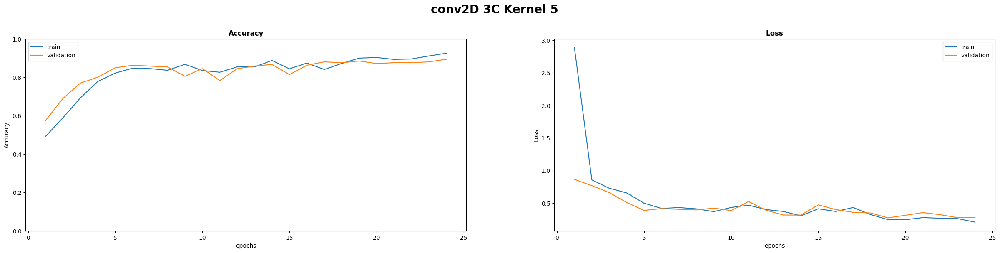



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



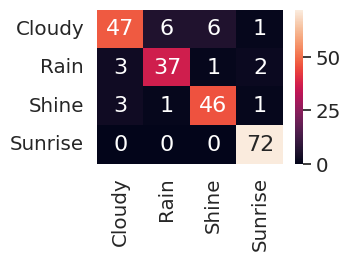



               precision    recall  f1-score   support

           0     0.8868    0.7833    0.8319        60
           1     0.8409    0.8605    0.8506        43
           2     0.8679    0.9020    0.8846        51
           3     0.9474    1.0000    0.9730        72

    accuracy                         0.8938       226
   macro avg     0.8857    0.8864    0.8850       226
weighted avg     0.8931    0.8938    0.8923       226
 



conv2D 3C Kernel 5: 

╒════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers   │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                    │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════════════╪═══════════════════════════════

In [ ]:
history_conv2model_diffrent_parameters_kernel5 = print_full_results("conv2D 3C Kernel 5", model, history_conv2model_diffrent_parameters_kernel5_, validation_generator)

simple conv 3C kernel 3

In [ ]:
history_conv2model_diffrent_parameters_kernel3_, model = conv2model_diffrent_parameters(epochs=200, kernel_size=3, strides=1, padding='same', dense=64, lr=0.0010142202510360857)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 16)      448       
                                                                 
 conv2d_1 (Conv2D)           (None, 128, 128, 32)      4640      
                                                                 
 conv2d_2 (Conv2D)           (None, 128, 128, 48)      13872     
                                                                 
 flatten (Flatten)           (None, 786432)            0         
                                                                 
 dense (Dense)               (None, 64)                50331712  
                                                                 
 dense_1 (Dense)             (None, 4)                 260       
                                                                 
Total params: 50,350,932
Trainable params: 50,350,932
No

0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 2s 221ms/step - loss: 0.3131 - accuracy: 0.9027


Plots:




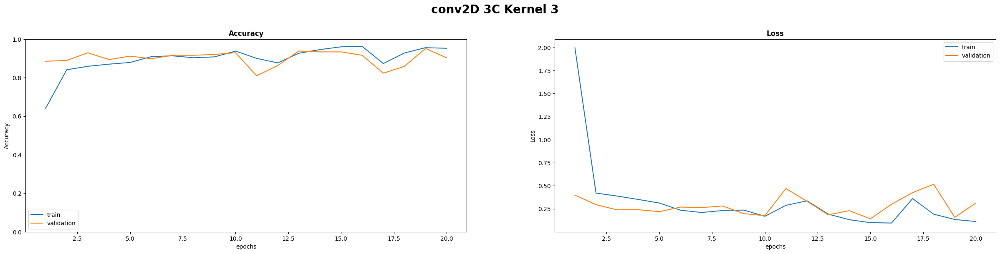



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



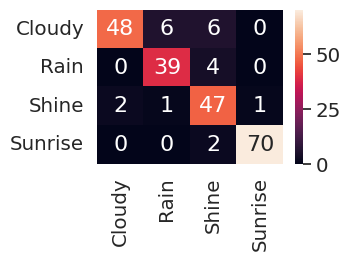



               precision    recall  f1-score   support

           0     0.9600    0.8000    0.8727        60
           1     0.8478    0.9070    0.8764        43
           2     0.7966    0.9216    0.8545        51
           3     0.9859    0.9722    0.9790        72

    accuracy                         0.9027       226
   macro avg     0.8976    0.9002    0.8957       226
weighted avg     0.9100    0.9027    0.9032       226
 



conv2D 3C Kernel 3: 

╒════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers   │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                    │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════════════╪═══════════════════════════════

In [ ]:
history_conv2model_diffrent_parameters_kernel3 = print_full_results("conv2D 3C Kernel 3", model, history_conv2model_diffrent_parameters_kernel3_, validation_generator)

##### conv2d different kernels model results

In [ ]:
print(colored("Simple Conv2D diffrent kernels models:\n", 'yellow', attrs=['bold']), "\n")
print(print_table(
    [find_max_i(history_conv2model_diffrent_parameters_kernel7), find_max_i(history_conv2model_diffrent_parameters_kernel5), find_max_i(history_conv2model_diffrent_parameters_kernel3)],
    head=["Number of Layers",
          "Accuracy and Loss of train set\naccording to Min train Loss",
          "Accuracy and Loss of val set\naccording to Min val Loss",
          "Accuracy and Loss of train set\naccording to Max train Accuracy",
          "Accuracy and Loss of val set\naccording to Max val Accuracy"],
    rows=["Simple Conv2D 3C kernel 7", "Simple Conv2D 3C kernel 5", "Simple Conv2D 3C kernel 3"]))

Simple Conv2D diffrent kernels models:
 

╒═══════════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers          │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                           │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞═══════════════════════════╪══════════════════════════════════╪════════════════════════════════╪═══════════════════════════════════╪═════════════════════════════════╡
│ Simple Conv2D 3C kernel 7 │ (epoch index:25)                 │ (epoch index:22)               │ (epoch index:25)                  │ (epoch index:22)                │
│                           │ Accuracy: 0.9354838728904724     │ Accuracy: 0.8761062026023865   │ Accuracy: 0.93548387

Simple Conv2D diffrent kernels:




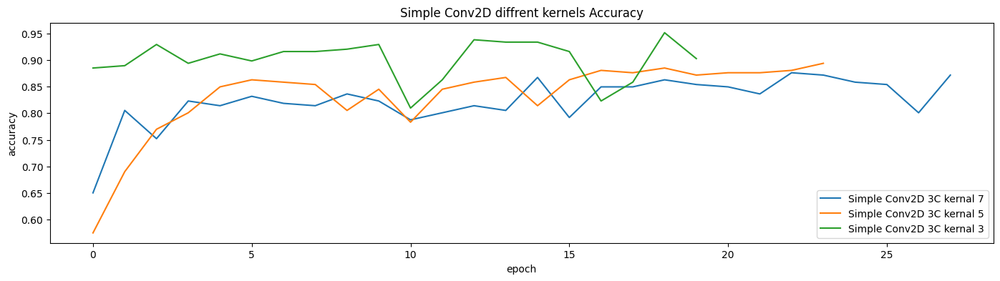

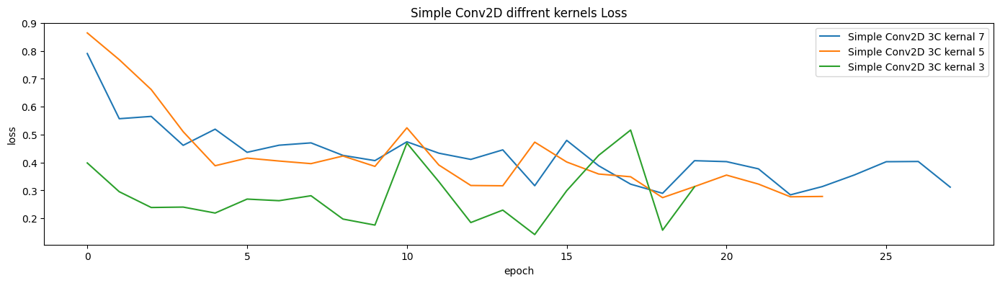

In [ ]:
print(colored("Simple Conv2D diffrent kernels:\n\n", 'yellow', attrs=['bold']))
plot_multi_plots(names=["Simple Conv2D 3C kernal 7", "Simple Conv2D 3C kernal 5", "Simple Conv2D 3C kernal 3"],
                 history=[history_conv2model_diffrent_parameters_kernel7, history_conv2model_diffrent_parameters_kernel5, history_conv2model_diffrent_parameters_kernel3],
                 purpose="val_accuracy", title="Simple Conv2D diffrent kernels Accuracy", y_label="accuracy")
print()
plot_multi_plots(names=["Simple Conv2D 3C kernal 7", "Simple Conv2D 3C kernal 5", "Simple Conv2D 3C kernal 3"],
                 history=[history_conv2model_diffrent_parameters_kernel7, history_conv2model_diffrent_parameters_kernel5, history_conv2model_diffrent_parameters_kernel3],
                 purpose="val_loss", title="Simple Conv2D diffrent kernels Loss", y_label="loss")

#### conv2d 3C 3K with different strides

simple conv 3C 3K S1

In [ ]:
history_conv2d_3c_3k_s1_, model = conv2model_diffrent_parameters(epochs=200, kernel_size=3, strides=1, padding='same', dense=64, lr=0.0010142202510360857)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 16)      448       
                                                                 
 conv2d_1 (Conv2D)           (None, 128, 128, 32)      4640      
                                                                 
 conv2d_2 (Conv2D)           (None, 128, 128, 48)      13872     
                                                                 
 flatten (Flatten)           (None, 786432)            0         
                                                                 
 dense (Dense)               (None, 64)                50331712  
                                                                 
 dense_1 (Dense)             (None, 4)                 260       
                                                                 
Total params: 50,350,932
Trainable params: 50,350,932
No

0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 2s 200ms/step - loss: 0.1895 - accuracy: 0.9292


Plots:




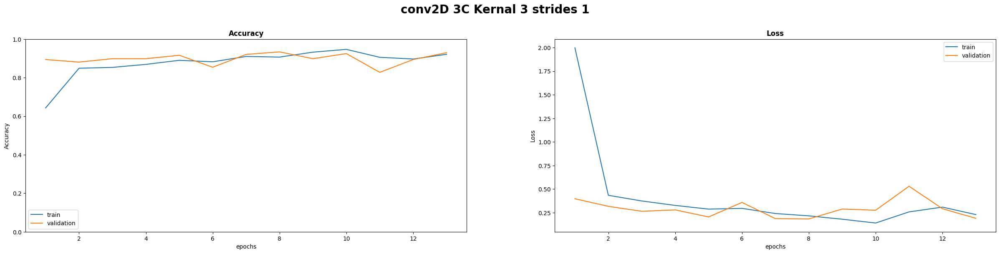



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



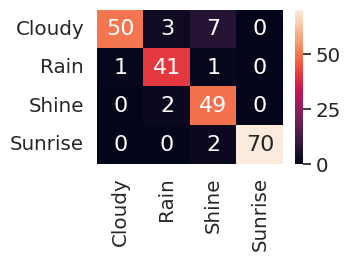



               precision    recall  f1-score   support

           0     0.9804    0.8333    0.9009        60
           1     0.8913    0.9535    0.9213        43
           2     0.8305    0.9608    0.8909        51
           3     1.0000    0.9722    0.9859        72

    accuracy                         0.9292       226
   macro avg     0.9256    0.9300    0.9248       226
weighted avg     0.9359    0.9292    0.9296       226
 



conv2D 3C Kernal 3 strides 1: 

╒══════════════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers             │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                              │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════

In [ ]:
history_conv2d_3c_3k_s1 = print_full_results("conv2D 3C Kernal 3 strides 1", model, history_conv2d_3c_3k_s1_, validation_generator)

simple conv 3C 3K S2

In [ ]:
history_conv2d_3c_3k_s2_, model = conv2model_diffrent_parameters(epochs=200, kernel_size=3, strides=2, padding='same', dense=64, lr=0.0010142202510360857)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 64, 64, 16)        448       
                                                                 
 conv2d_1 (Conv2D)           (None, 32, 32, 32)        4640      
                                                                 
 conv2d_2 (Conv2D)           (None, 16, 16, 48)        13872     
                                                                 
 flatten (Flatten)           (None, 12288)             0         
                                                                 
 dense (Dense)               (None, 64)                786496    
                                                                 
 dense_1 (Dense)             (None, 4)                 260       
                                                                 
Total params: 805,716
Trainable params: 805,716
Non-trai

0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 1s 180ms/step - loss: 0.2244 - accuracy: 0.9159


Plots:




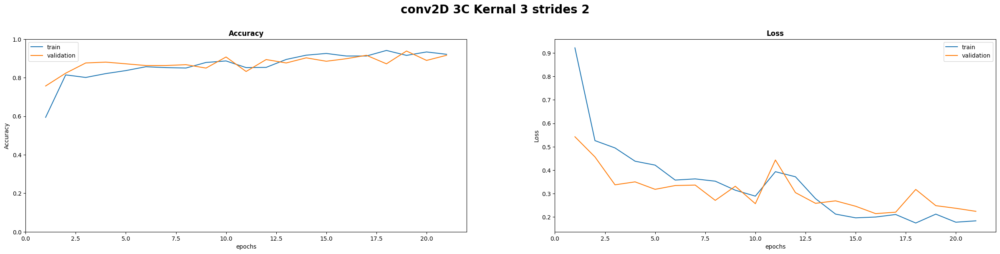



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



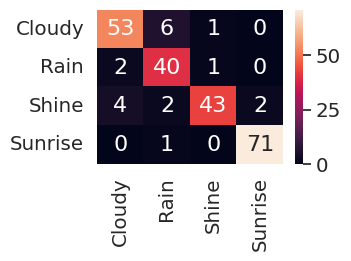



               precision    recall  f1-score   support

           0     0.8983    0.8833    0.8908        60
           1     0.8163    0.9302    0.8696        43
           2     0.9556    0.8431    0.8958        51
           3     0.9726    0.9861    0.9793        72

    accuracy                         0.9159       226
   macro avg     0.9107    0.9107    0.9089       226
weighted avg     0.9193    0.9159    0.9161       226
 



conv2D 3C Kernal 3 strides 2: 

╒══════════════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers             │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                              │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════

In [ ]:
history_conv2d_3c_3k_s2 = print_full_results("conv2D 3C Kernal 3 strides 2", model, history_conv2d_3c_3k_s2_, validation_generator)

simple conv 3C 3K S3

In [ ]:
history_conv2d_3c_3k_s3_, model = conv2model_diffrent_parameters(epochs=200, kernel_size=3, strides=3, padding='same', dense=64, lr=0.0010142202510360857)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 43, 43, 16)        448       
                                                                 
 conv2d_1 (Conv2D)           (None, 15, 15, 32)        4640      
                                                                 
 conv2d_2 (Conv2D)           (None, 5, 5, 48)          13872     
                                                                 
 flatten (Flatten)           (None, 1200)              0         
                                                                 
 dense (Dense)               (None, 64)                76864     
                                                                 
 dense_1 (Dense)             (None, 4)                 260       
                                                                 
Total params: 96,084
Trainable params: 96,084
Non-traina

0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 1s 183ms/step - loss: 0.2915 - accuracy: 0.9071


Plots:




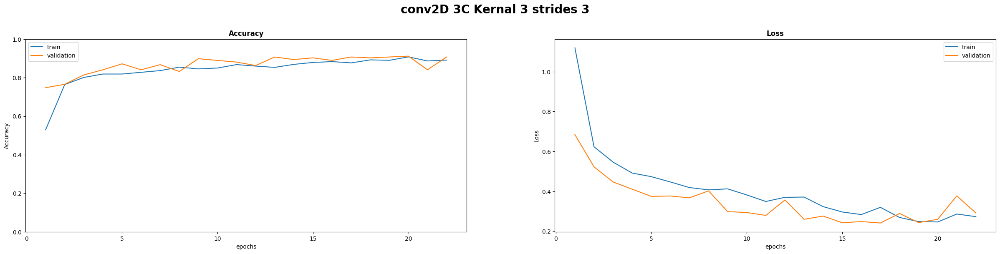



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



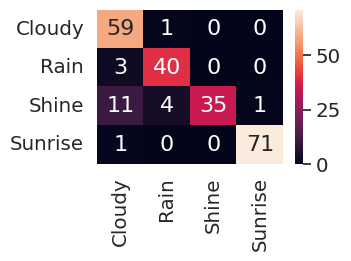



               precision    recall  f1-score   support

           0     0.7973    0.9833    0.8806        60
           1     0.8889    0.9302    0.9091        43
           2     1.0000    0.6863    0.8140        51
           3     0.9861    0.9861    0.9861        72

    accuracy                         0.9071       226
   macro avg     0.9181    0.8965    0.8974       226
weighted avg     0.9206    0.9071    0.9046       226
 



conv2D 3C Kernal 3 strides 3: 

╒══════════════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers             │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                              │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════

In [ ]:
history_conv2d_3c_3k_s3 = print_full_results("conv2D 3C Kernal 3 strides 3", model, history_conv2d_3c_3k_s3_, validation_generator)

##### conv2d 3C 3K different strides results

In [ ]:
print(colored("Conv2D 3C 3K diffrent strides models:\n", 'yellow', attrs=['bold']), "\n")
print(print_table(
    [find_max_i(history_conv2d_3c_3k_s1), find_max_i(history_conv2d_3c_3k_s2), find_max_i(history_conv2d_3c_3k_s3)],
    head=["Number of Layers",
          "Accuracy and Loss of train set\naccording to Min train Loss",
          "Accuracy and Loss of val set\naccording to Min val Loss",
          "Accuracy and Loss of train set\naccording to Max train Accuracy",
          "Accuracy and Loss of val set\naccording to Max val Accuracy"],
    rows=["Conv2D 3C 3K 1S", "Conv2D 3C 3K 2S", "Conv2D 3C 3K 3S"]))

Conv2D 3C 3K diffrent strides models:
 

╒════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers   │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                    │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════════════╪══════════════════════════════════╪════════════════════════════════╪═══════════════════════════════════╪═════════════════════════════════╡
│ Conv2D 3C 3K 1S    │ (epoch index:9)                  │ (epoch index:7)                │ (epoch index:9)                   │ (epoch index:7)                 │
│                    │ Accuracy: 0.9466073513031006     │ Accuracy: 0.9336283206939697   │ Accuracy: 0.9466073513031006      │ Accuracy: 0.933628320693969

Conv2D 3C 3K diffrent strides:




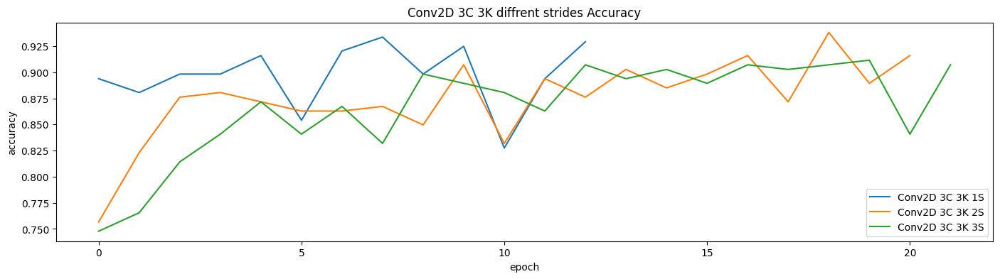

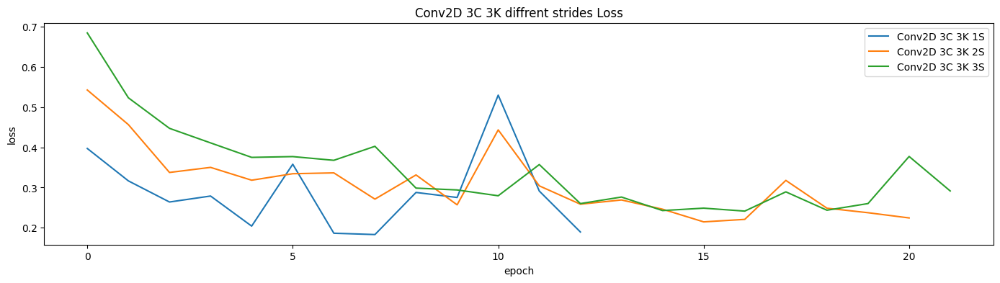

In [ ]:
print(colored("Conv2D 3C 3K diffrent strides:\n\n", 'yellow', attrs=['bold']))
plot_multi_plots(names=["Conv2D 3C 3K 1S", "Conv2D 3C 3K 2S", "Conv2D 3C 3K 3S"],
                 history=[history_conv2d_3c_3k_s1, history_conv2d_3c_3k_s2, history_conv2d_3c_3k_s3],
                 purpose="val_accuracy", title="Conv2D 3C 3K diffrent strides Accuracy", y_label="accuracy")
print()
plot_multi_plots(names=["Conv2D 3C 3K 1S", "Conv2D 3C 3K 2S", "Conv2D 3C 3K 3S"],
                 history=[history_conv2d_3c_3k_s1, history_conv2d_3c_3k_s2, history_conv2d_3c_3k_s3],
                 purpose="val_loss", title="Conv2D 3C 3K diffrent strides Loss", y_label="loss")

#### conv2d 3C 3K 1S with different dilation

<div>
<img src="https://drive.google.com/uc?export=view&id=1q45KQ3klkbueFMxx-qxOSIL0_uU3T-H4" alt="dilation example" width="600"/>
</div>


conv2d_3c_3k_s1_d1

In [ ]:
history_conv2d_3c_3k_s1_d1_, model = conv2model_diffrent_parameters(epochs=200, kernel_size=3, strides=1, padding='same', dilation=1, dense=64, lr=0.0010142202510360857)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 16)      448       
                                                                 
 conv2d_1 (Conv2D)           (None, 128, 128, 32)      4640      
                                                                 
 conv2d_2 (Conv2D)           (None, 128, 128, 48)      13872     
                                                                 
 flatten (Flatten)           (None, 786432)            0         
                                                                 
 dense (Dense)               (None, 64)                50331712  
                                                                 
 dense_1 (Dense)             (None, 4)                 260       
                                                                 
Total params: 50,350,932
Trainable params: 50,350,932
No

0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 2s 195ms/step - loss: 0.1890 - accuracy: 0.9204


Plots:




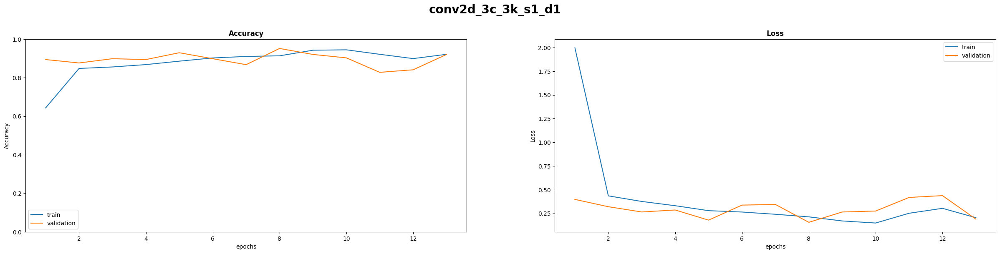



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



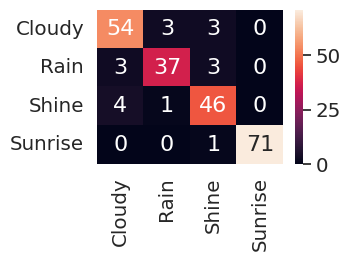



               precision    recall  f1-score   support

           0     0.8852    0.9000    0.8926        60
           1     0.9024    0.8605    0.8810        43
           2     0.8679    0.9020    0.8846        51
           3     1.0000    0.9861    0.9930        72

    accuracy                         0.9204       226
   macro avg     0.9139    0.9121    0.9128       226
weighted avg     0.9212    0.9204    0.9206       226
 



conv2d_3c_3k_s1_d1: 

╒════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers   │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                    │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════════════╪═══════════════════════════════

In [ ]:
history_conv2d_3c_3k_s1_d1 = print_full_results("conv2d_3c_3k_s1_d1", model, history_conv2d_3c_3k_s1_d1_, validation_generator)

conv2d_3c_3k_s1_d2

In [ ]:
history_conv2d_3c_3k_s1_d2_, model = conv2model_diffrent_parameters(epochs=200, kernel_size=3, strides=1, padding='same', dilation=2, dense=64, lr=0.0010142202510360857)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 16)      448       
                                                                 
 conv2d_1 (Conv2D)           (None, 128, 128, 32)      4640      
                                                                 
 conv2d_2 (Conv2D)           (None, 128, 128, 48)      13872     
                                                                 
 flatten (Flatten)           (None, 786432)            0         
                                                                 
 dense (Dense)               (None, 64)                50331712  
                                                                 
 dense_1 (Dense)             (None, 4)                 260       
                                                                 
Total params: 50,350,932
Trainable params: 50,350,932
No

0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 2s 196ms/step - loss: 0.2247 - accuracy: 0.9336


Plots:




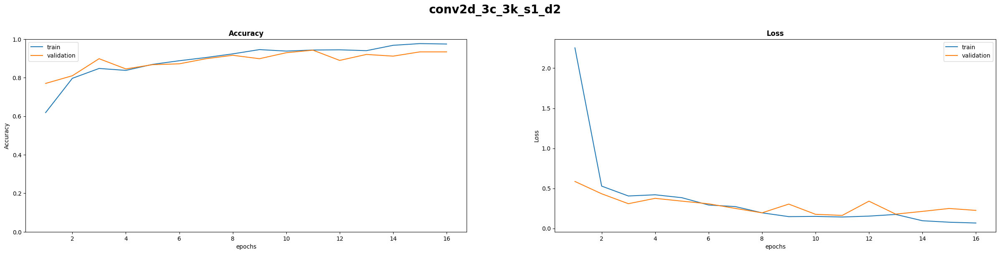



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



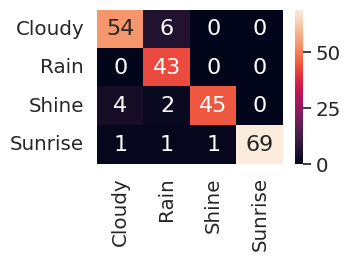



               precision    recall  f1-score   support

           0     0.9153    0.9000    0.9076        60
           1     0.8269    1.0000    0.9053        43
           2     0.9783    0.8824    0.9278        51
           3     1.0000    0.9583    0.9787        72

    accuracy                         0.9336       226
   macro avg     0.9301    0.9352    0.9298       226
weighted avg     0.9397    0.9336    0.9344       226
 



conv2d_3c_3k_s1_d2: 

╒════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers   │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                    │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════════════╪═══════════════════════════════

In [ ]:
history_conv2d_3c_3k_s1_d2 = print_full_results("conv2d_3c_3k_s1_d2", model, history_conv2d_3c_3k_s1_d2_, validation_generator)

conv2d_3c_3k_s1_d3

In [ ]:
history_conv2d_3c_3k_s1_d3_, model = conv2model_diffrent_parameters(epochs=200, kernel_size=3, strides=1, padding='same', dilation=3, dense=64, lr=0.0010142202510360857)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 16)      448       
                                                                 
 conv2d_1 (Conv2D)           (None, 128, 128, 32)      4640      
                                                                 
 conv2d_2 (Conv2D)           (None, 128, 128, 48)      13872     
                                                                 
 flatten (Flatten)           (None, 786432)            0         
                                                                 
 dense (Dense)               (None, 64)                50331712  
                                                                 
 dense_1 (Dense)             (None, 4)                 260       
                                                                 
Total params: 50,350,932
Trainable params: 50,350,932
No

0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 2s 204ms/step - loss: 0.2610 - accuracy: 0.8894


Plots:




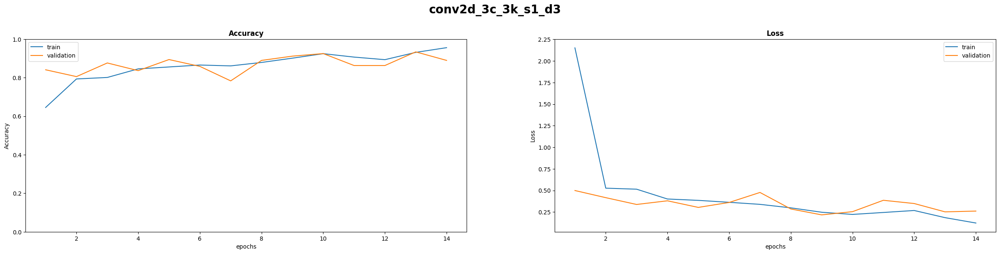



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



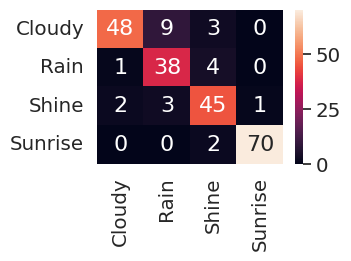



               precision    recall  f1-score   support

           0     0.9412    0.8000    0.8649        60
           1     0.7600    0.8837    0.8172        43
           2     0.8333    0.8824    0.8571        51
           3     0.9859    0.9722    0.9790        72

    accuracy                         0.8894       226
   macro avg     0.8801    0.8846    0.8796       226
weighted avg     0.8966    0.8894    0.8904       226
 



conv2d_3c_3k_s1_d3: 

╒════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers   │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                    │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════════════╪═══════════════════════════════

In [ ]:
history_conv2d_3c_3k_s1_d3 = print_full_results("conv2d_3c_3k_s1_d3", model, history_conv2d_3c_3k_s1_d3_, validation_generator)

##### conv2d 3C 3K 1S different dilations results 

In [ ]:
print(colored("conv2d 3C 3K 1S with different dilation models:\n", 'yellow', attrs=['bold']), "\n")
print(print_table(
    [find_max_i(history_conv2d_3c_3k_s1_d1), find_max_i(history_conv2d_3c_3k_s1_d2), find_max_i(history_conv2d_3c_3k_s1_d3)],
    head=["Number of Layers",
          "Accuracy and Loss of train set\naccording to Min train Loss",
          "Accuracy and Loss of val set\naccording to Min val Loss",
          "Accuracy and Loss of train set\naccording to Max train Accuracy",
          "Accuracy and Loss of val set\naccording to Max val Accuracy"],
    rows=["conv2d_3c_3k_s1_d1", "conv2d_3c_3k_s1_d2", "conv2d_3c_3k_s1_d3"]))

conv2d 3C 3K 1S with different dilation models:
 

╒════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers   │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                    │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════════════╪══════════════════════════════════╪════════════════════════════════╪═══════════════════════════════════╪═════════════════════════════════╡
│ conv2d_3c_3k_s1_d1 │ (epoch index:9)                  │ (epoch index:7)                │ (epoch index:9)                   │ (epoch index:7)                 │
│                    │ Accuracy: 0.9443826675415039     │ Accuracy: 0.9513274431228638   │ Accuracy: 0.9443826675415039      │ Accuracy: 0.95132

conv2d 3C 3K 1S with different dilation:




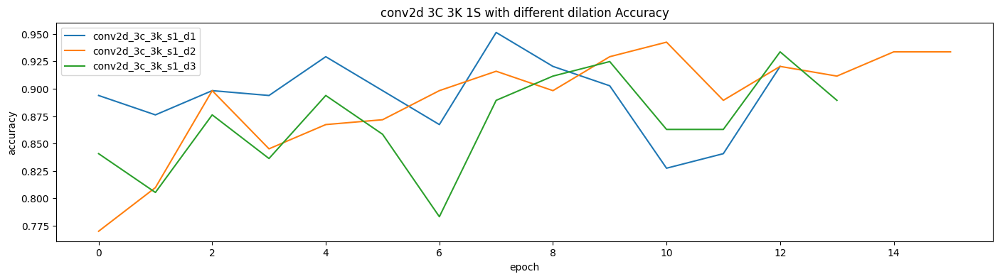

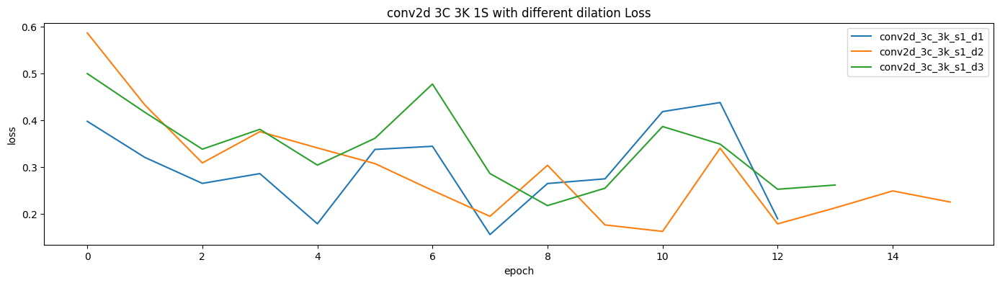

In [ ]:
print(colored("conv2d 3C 3K 1S with different dilation:\n\n", 'yellow', attrs=['bold']))
plot_multi_plots(names=["conv2d_3c_3k_s1_d1", "conv2d_3c_3k_s1_d2", "conv2d_3c_3k_s1_d3"],
                 history=[history_conv2d_3c_3k_s1_d1, history_conv2d_3c_3k_s1_d2, history_conv2d_3c_3k_s1_d3],
                 purpose="val_accuracy", title="conv2d 3C 3K 1S with different dilation Accuracy", y_label="accuracy")
print()
plot_multi_plots(names=["conv2d_3c_3k_s1_d1", "conv2d_3c_3k_s1_d2", "conv2d_3c_3k_s1_d3"],
                 history=[history_conv2d_3c_3k_s1_d1, history_conv2d_3c_3k_s1_d2, history_conv2d_3c_3k_s1_d3],
                 purpose="val_loss", title="conv2d 3C 3K 1S with different dilation Loss", y_label="loss")

#### conv2d 3C 3K 1S with different Paddings and Dilation

conv2d_3c_3k_s1_d1 padding valid

In [ ]:
history_conv2d_3c_3k_s1_d1_pV_, model = conv2model_diffrent_parameters(epochs=200, kernel_size=3, strides=1, padding='valid', dilation=1, dense=64, lr=0.0010142202510360857)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 126, 126, 16)      448       
                                                                 
 conv2d_1 (Conv2D)           (None, 124, 124, 32)      4640      
                                                                 
 conv2d_2 (Conv2D)           (None, 122, 122, 48)      13872     
                                                                 
 flatten (Flatten)           (None, 714432)            0         
                                                                 
 dense (Dense)               (None, 64)                45723712  
                                                                 
 dense_1 (Dense)             (None, 4)                 260       
                                                                 
Total params: 45,742,932
Trainable params: 45,742,932
No

0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 2s 196ms/step - loss: 0.2363 - accuracy: 0.9159


Plots:




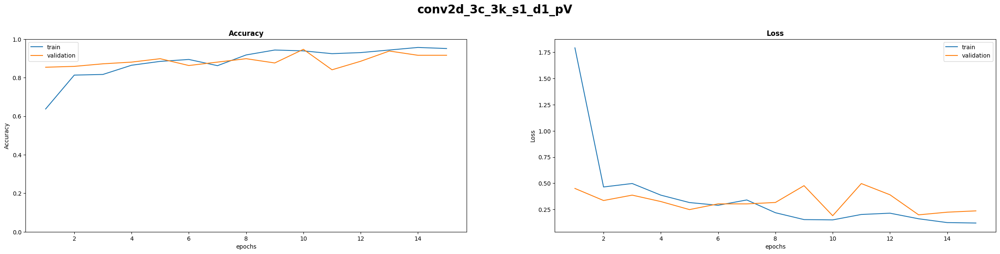



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



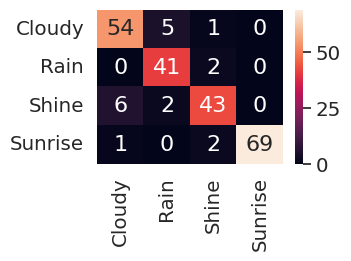



               precision    recall  f1-score   support

           0     0.8852    0.9000    0.8926        60
           1     0.8542    0.9535    0.9011        43
           2     0.8958    0.8431    0.8687        51
           3     1.0000    0.9583    0.9787        72

    accuracy                         0.9159       226
   macro avg     0.9088    0.9137    0.9103       226
weighted avg     0.9183    0.9159    0.9162       226
 



conv2d_3c_3k_s1_d1_pV: 

╒═══════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers      │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                       │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞═══════════════════════╪════════════════

In [ ]:
history_conv2d_3c_3k_s1_d1_pV = print_full_results("conv2d_3c_3k_s1_d1_pV", model, history_conv2d_3c_3k_s1_d1_pV_, validation_generator)

conv2d_3c_3k_s1_d2 padding valid

In [ ]:
history_conv2d_3c_3k_s1_d2_pV_, model = conv2model_diffrent_parameters(epochs=200, kernel_size=3, strides=1, padding='valid', dilation=2, dense=64, lr=0.0010142202510360857)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 124, 124, 16)      448       
                                                                 
 conv2d_1 (Conv2D)           (None, 120, 120, 32)      4640      
                                                                 
 conv2d_2 (Conv2D)           (None, 116, 116, 48)      13872     
                                                                 
 flatten (Flatten)           (None, 645888)            0         
                                                                 
 dense (Dense)               (None, 64)                41336896  
                                                                 
 dense_1 (Dense)             (None, 4)                 260       
                                                                 
Total params: 41,356,116
Trainable params: 41,356,116
No

0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 2s 204ms/step - loss: 0.3040 - accuracy: 0.9027


Plots:




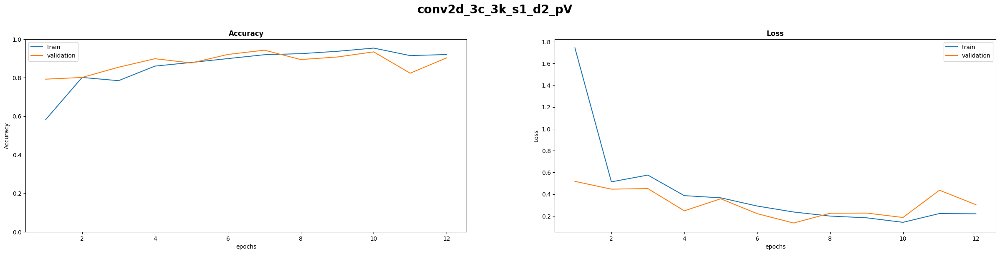



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



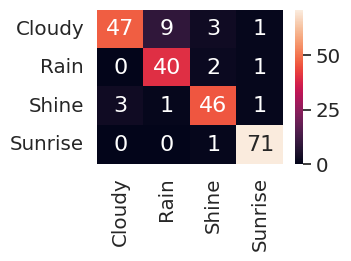



               precision    recall  f1-score   support

           0     0.9400    0.7833    0.8545        60
           1     0.8000    0.9302    0.8602        43
           2     0.8846    0.9020    0.8932        51
           3     0.9595    0.9861    0.9726        72

    accuracy                         0.9027       226
   macro avg     0.8960    0.9004    0.8951       226
weighted avg     0.9071    0.9027    0.9020       226
 



conv2d_3c_3k_s1_d2_pV: 

╒═══════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers      │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                       │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞═══════════════════════╪════════════════

In [ ]:
history_conv2d_3c_3k_s1_d2_pV = print_full_results("conv2d_3c_3k_s1_d2_pV", model, history_conv2d_3c_3k_s1_d2_pV_, validation_generator)

conv2d_3c_3k_s1_d1 padding same

In [ ]:
history_conv2d_3c_3k_s1_d1_pS_, model = conv2model_diffrent_parameters(epochs=200, kernel_size=3, strides=1, padding='same', dilation=1, dense=64, lr=0.0010142202510360857)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 16)      448       
                                                                 
 conv2d_1 (Conv2D)           (None, 128, 128, 32)      4640      
                                                                 
 conv2d_2 (Conv2D)           (None, 128, 128, 48)      13872     
                                                                 
 flatten (Flatten)           (None, 786432)            0         
                                                                 
 dense (Dense)               (None, 64)                50331712  
                                                                 
 dense_1 (Dense)             (None, 4)                 260       
                                                                 
Total params: 50,350,932
Trainable params: 50,350,932
No

0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 2s 190ms/step - loss: 0.3190 - accuracy: 0.8850


Plots:




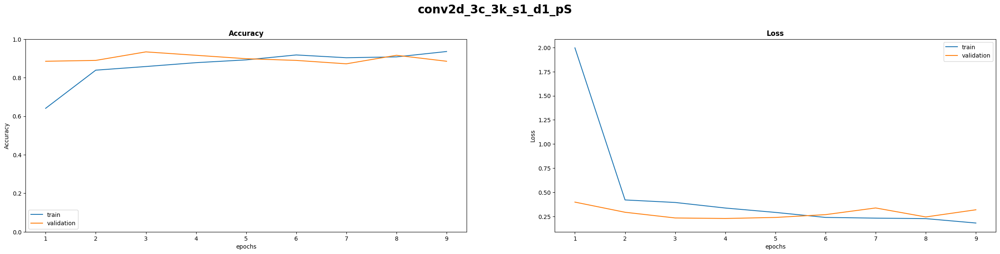



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



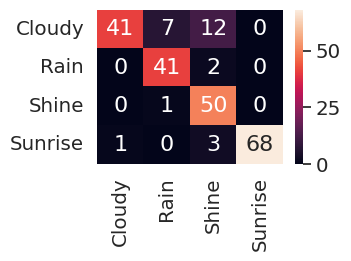



               precision    recall  f1-score   support

           0     0.9762    0.6833    0.8039        60
           1     0.8367    0.9535    0.8913        43
           2     0.7463    0.9804    0.8475        51
           3     1.0000    0.9444    0.9714        72

    accuracy                         0.8850       226
   macro avg     0.8898    0.8904    0.8785       226
weighted avg     0.9054    0.8850    0.8837       226
 



conv2d_3c_3k_s1_d1_pS: 

╒═══════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers      │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                       │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞═══════════════════════╪════════════════

In [ ]:
history_conv2d_3c_3k_s1_d1_pS = print_full_results("conv2d_3c_3k_s1_d1_pS", model, history_conv2d_3c_3k_s1_d1_pS_, validation_generator)

conv2d_3c_3k_s1_d2 padding same

In [ ]:
history_conv2d_3c_3k_s1_d2_pS_, model = conv2model_diffrent_parameters(epochs=200, kernel_size=3, strides=1, padding='same', dilation=2, dense=64, lr=0.0010142202510360857)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 16)      448       
                                                                 
 conv2d_1 (Conv2D)           (None, 128, 128, 32)      4640      
                                                                 
 conv2d_2 (Conv2D)           (None, 128, 128, 48)      13872     
                                                                 
 flatten (Flatten)           (None, 786432)            0         
                                                                 
 dense (Dense)               (None, 64)                50331712  
                                                                 
 dense_1 (Dense)             (None, 4)                 260       
                                                                 
Total params: 50,350,932
Trainable params: 50,350,932
No

0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 2s 197ms/step - loss: 0.2289 - accuracy: 0.9204


Plots:




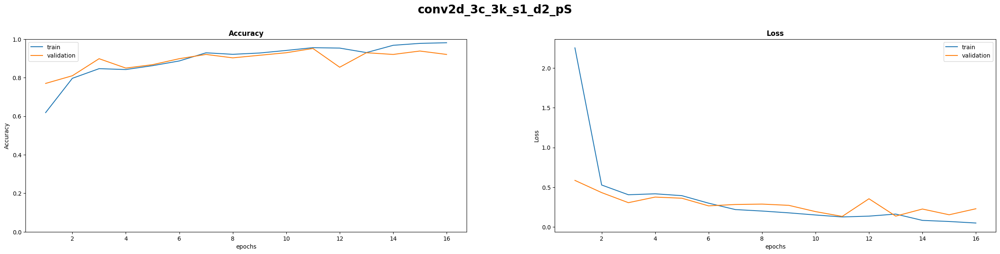



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



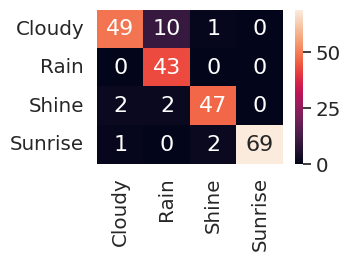



               precision    recall  f1-score   support

           0     0.9423    0.8167    0.8750        60
           1     0.7818    1.0000    0.8776        43
           2     0.9400    0.9216    0.9307        51
           3     1.0000    0.9583    0.9787        72

    accuracy                         0.9204       226
   macro avg     0.9160    0.9241    0.9155       226
weighted avg     0.9296    0.9204    0.9211       226
 



conv2d_3c_3k_s1_d2_pS: 

╒═══════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers      │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                       │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞═══════════════════════╪════════════════

In [ ]:
history_conv2d_3c_3k_s1_d2_pS = print_full_results("conv2d_3c_3k_s1_d2_pS", model, history_conv2d_3c_3k_s1_d2_pS_, validation_generator)

##### conv2d 3C 3K 1S with different Paddings and Dilation results 

In [ ]:
print(colored("conv2d 3C 3K 1S with different Paddings and Dilation models:\n", 'yellow', attrs=['bold']), "\n")
print(print_table(
    [find_max_i(history_conv2d_3c_3k_s1_d1_pV), find_max_i(history_conv2d_3c_3k_s1_d2_pV), 
     find_max_i(history_conv2d_3c_3k_s1_d1_pS), find_max_i(history_conv2d_3c_3k_s1_d2_pS)],
    head=["Number of Layers",
          "Accuracy and Loss of train set\naccording to Min train Loss",
          "Accuracy and Loss of val set\naccording to Min val Loss",
          "Accuracy and Loss of train set\naccording to Max train Accuracy",
          "Accuracy and Loss of val set\naccording to Max val Accuracy"],
    rows=["conv2d_3c_3k_s1_d1_pV", "conv2d_3c_3k_s1_d2_pV", "conv2d_3c_3k_s1_d1_pS", "conv2d_3c_3k_s1_d2_pS"]))

conv2d 3C 3K 1S with different Paddings and Dilation models:
 

╒═══════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers      │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                       │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞═══════════════════════╪══════════════════════════════════╪════════════════════════════════╪═══════════════════════════════════╪═════════════════════════════════╡
│ conv2d_3c_3k_s1_d1_pV │ (epoch index:14)                 │ (epoch index:9)                │ (epoch index:13)                  │ (epoch index:9)                 │
│                       │ Accuracy: 0.951056718826294      │ Accuracy: 0.9469026327133179   │ Accuracy: 0.9566184878

conv2d 3C 3K 1S with different Paddings and Dilation:




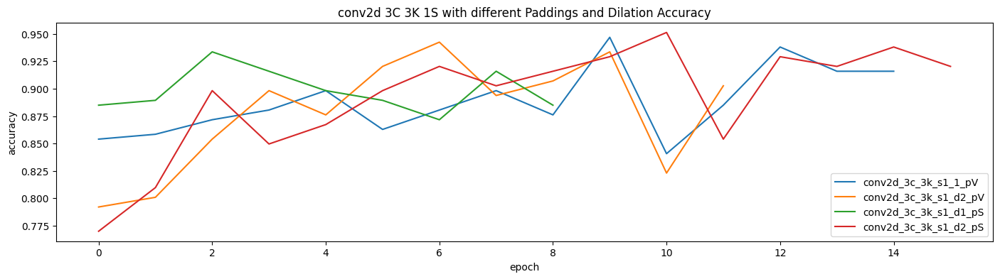

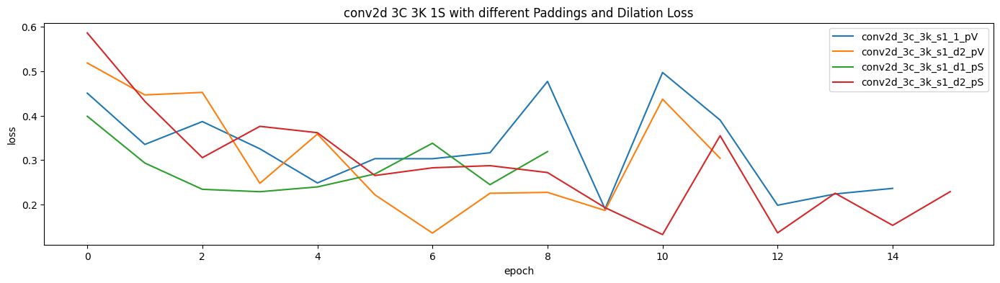

In [ ]:
print(colored("conv2d 3C 3K 1S with different Paddings and Dilation:\n\n", 'yellow', attrs=['bold']))
plot_multi_plots(names=["conv2d_3c_3k_s1_1_pV", "conv2d_3c_3k_s1_d2_pV", "conv2d_3c_3k_s1_d1_pS", "conv2d_3c_3k_s1_d2_pS"],
                 history=[history_conv2d_3c_3k_s1_d1_pV, history_conv2d_3c_3k_s1_d2_pV, history_conv2d_3c_3k_s1_d1_pS, history_conv2d_3c_3k_s1_d2_pS],
                 purpose="val_accuracy", title="conv2d 3C 3K 1S with different Paddings and Dilation Accuracy", y_label="accuracy")
print()
plot_multi_plots(names=["conv2d_3c_3k_s1_1_pV", "conv2d_3c_3k_s1_d2_pV", "conv2d_3c_3k_s1_d1_pS", "conv2d_3c_3k_s1_d2_pS"],
                 history=[history_conv2d_3c_3k_s1_d1_pV, history_conv2d_3c_3k_s1_d2_pV, history_conv2d_3c_3k_s1_d1_pS, history_conv2d_3c_3k_s1_d2_pS],
                 purpose="val_loss", title="conv2d 3C 3K 1S with different Paddings and Dilation Loss", y_label="loss")

## Pooling layers

<div>
<img src="https://drive.google.com/uc?export=view&id=1E51_tio1gteK8HqBZW6JMxxasNdg908c" alt="pooling example" width="400"/>
</div>

Why to use Pooling Layers? Pooling layers are used to reduce the dimensions of the feature maps. Thus, it reduces the number of parameters to learn and the amount of computation performed in the network. The pooling layer summarises the features present in a region of the feature map generated by a convolution layer.

<br></br>

Average Pooling is used to inly reduce the dimensions

Max Pooling is used to reduce the dimensions and highlights the image

Min Pooling is used to reduce the dimensions and find shadows in image

In [ ]:
def conv2model_pooling(epochs=1, kernel_size=3, strides=1, padding='valid', dilation=2, dense=64, pooling_function=AveragePooling2D, pool_size=(2, 2), lr=0.0010142202510360857, return_model=False):
    tf.keras.backend.clear_session()

    # fixing the seed
    set_random_seed()

    model = tf.keras.Sequential()

    # input layer
    model.add(tf.keras.layers.Conv2D(filters=16, kernel_size=kernel_size, strides=strides, padding=padding, dilation_rate=dilation, activation='relu', input_shape=(avg_height, avg_width, 3)))
    # pooling
    model.add(pooling_function(pool_size=pool_size))
    # secend conv
    model.add(tf.keras.layers.Conv2D(filters=32, kernel_size=kernel_size, strides=strides, padding=padding, dilation_rate=dilation, activation='relu'))
    # pooling
    model.add(pooling_function(pool_size=pool_size))
    # third conv
    model.add(tf.keras.layers.Conv2D(filters=48, kernel_size=kernel_size, strides=strides, padding=padding, dilation_rate=dilation, activation='relu'))
    # pooling
    model.add(pooling_function(pool_size=pool_size))

    #  flatten
    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(64, activation='relu'))

    # output layer
    model.add(Dense(4, activation='softmax'))

    # print model summary
    model.summary()

    # compiling the model
    model.compile(loss='categorical_crossentropy',
                  optimizer=Adam(lr),
                  metrics=['accuracy'], )
    if return_model == True:
        return model

    # regenrating the sets
    print()
    train_generator, validation_generator = generate_sets()
    print()
    print()

    # defining early stop
    # patience is the number of epochs if there is no improvement, the algorithm will early stop.
    stop_early = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)

    # training the model
    hist_inc = model.fit(train_generator,
                         validation_data=validation_generator,
                         epochs=epochs,
                         steps_per_epoch=int(np.ceil(train_generator.samples / train_generator.batch_size)),  # ~28
                         verbose=0,
                         callbacks=[stop_early, TqdmCallback(verbose=0)])

    return hist_inc, model

### Conv2d Model with **Average Pooling**

Conv2d Model with Average Pooling 2 S2 D1

In [ ]:
history_conv2d_with_pooling_S2_d1_avg_2_, model = conv2model_pooling(epochs=200, kernel_size=3, strides=2, padding='same', dilation=1, dense=64,
                                                                       pooling_function=AveragePooling2D, pool_size=(2, 2), lr=0.0010142202510360857)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 64, 64, 16)        448       
                                                                 
 average_pooling2d (AverageP  (None, 32, 32, 16)       0         
 ooling2D)                                                       
                                                                 
 conv2d_1 (Conv2D)           (None, 16, 16, 32)        4640      
                                                                 
 average_pooling2d_1 (Averag  (None, 8, 8, 32)         0         
 ePooling2D)                                                     
                                                                 
 conv2d_2 (Conv2D)           (None, 4, 4, 48)          13872     
                                                                 
 average_pooling2d_2 (Averag  (None, 2, 2, 48)         0

0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 1s 160ms/step - loss: 0.3218 - accuracy: 0.8894


Plots:




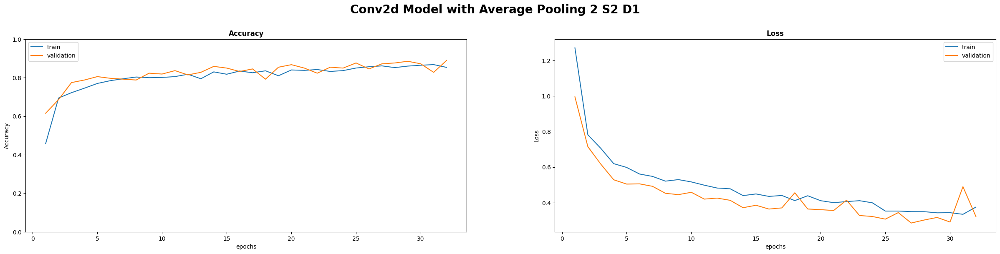



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



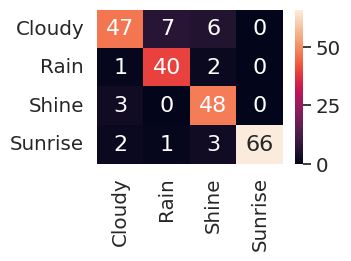



               precision    recall  f1-score   support

           0     0.8868    0.7833    0.8319        60
           1     0.8333    0.9302    0.8791        43
           2     0.8136    0.9412    0.8727        51
           3     1.0000    0.9167    0.9565        72

    accuracy                         0.8894       226
   macro avg     0.8834    0.8929    0.8851       226
weighted avg     0.8962    0.8894    0.8898       226
 



Conv2d Model with Average Pooling 2 S2 D1: 

╒═══════════════════════════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers                          │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                                           │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy

In [ ]:
history_conv2d_with_pooling_S2_d1_avg_2 = print_full_results("Conv2d Model with Average Pooling 2 S2 D1", model, history_conv2d_with_pooling_S2_d1_avg_2_, validation_generator)

Conv2d Model with Average Pooling 2 S1 D2

In [ ]:
history_conv2d_with_pooling_S1_d2_avg_2_, model = conv2model_pooling(epochs=200, kernel_size=3, strides=1, padding='same', dilation=2, dense=64,
                                                                       pooling_function=AveragePooling2D, pool_size=(2, 2), lr=0.0010142202510360857)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 16)      448       
                                                                 
 average_pooling2d (AverageP  (None, 64, 64, 16)       0         
 ooling2D)                                                       
                                                                 
 conv2d_1 (Conv2D)           (None, 64, 64, 32)        4640      
                                                                 
 average_pooling2d_1 (Averag  (None, 32, 32, 32)       0         
 ePooling2D)                                                     
                                                                 
 conv2d_2 (Conv2D)           (None, 32, 32, 48)        13872     
                                                                 
 average_pooling2d_2 (Averag  (None, 16, 16, 48)       0

0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 1s 164ms/step - loss: 0.2405 - accuracy: 0.8982


Plots:




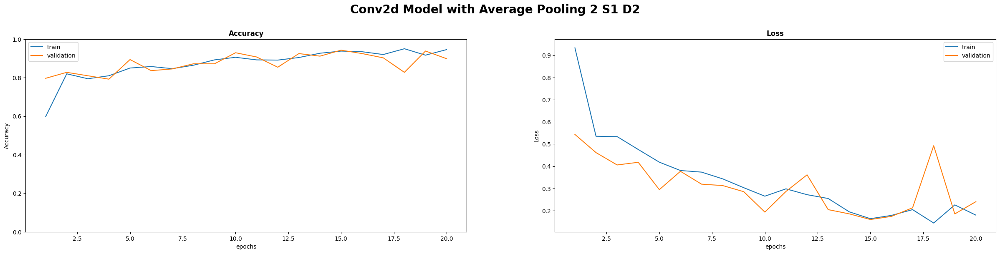



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



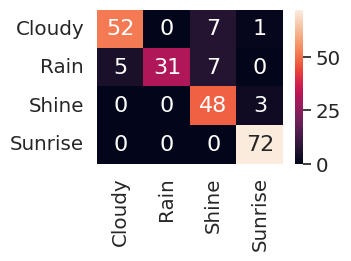



               precision    recall  f1-score   support

           0     0.9123    0.8667    0.8889        60
           1     1.0000    0.7209    0.8378        43
           2     0.7742    0.9412    0.8496        51
           3     0.9474    1.0000    0.9730        72

    accuracy                         0.8982       226
   macro avg     0.9085    0.8822    0.8873       226
weighted avg     0.9090    0.8982    0.8971       226
 



Conv2d Model with Average Pooling 2 S1 D2: 

╒═══════════════════════════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers                          │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                                           │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy

In [ ]:
history_conv2d_with_pooling_S1_d2_avg_2 = print_full_results("Conv2d Model with Average Pooling 2 S1 D2", model, history_conv2d_with_pooling_S1_d2_avg_2_, validation_generator)

#### Conv2d Model with **Average Pooling** results 

In [ ]:
print(colored("Conv2d Model with Average Pooling models:\n", 'yellow', attrs=['bold']), "\n")
print(print_table(
    [find_max_i(history_conv2d_with_pooling_S2_d1_avg_2), find_max_i(history_conv2d_with_pooling_S1_d2_avg_2)],
     
    head=["Number of Layers",
          "Accuracy and Loss of train set\naccording to Min train Loss",
          "Accuracy and Loss of val set\naccording to Min val Loss",
          "Accuracy and Loss of train set\naccording to Max train Accuracy",
          "Accuracy and Loss of val set\naccording to Max val Accuracy"],
    rows=["conv2d_3c_3k_s2_d1_avg2", "conv2d_3c_3k_s1_d2_avg2"]))

Conv2d Model with Average Pooling modles:
 

╒═════════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers        │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                         │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞═════════════════════════╪══════════════════════════════════╪════════════════════════════════╪═══════════════════════════════════╪═════════════════════════════════╡
│ conv2d_3c_3k_s2_d1_avg2 │ (epoch index:30)                 │ (epoch index:26)               │ (epoch index:30)                  │ (epoch index:31)                │
│                         │ Accuracy: 0.8676307201385498     │ Accuracy: 0.8716813921928406   │ Accuracy: 0.8676307201385498 

Conv2d Model with Average Pooling modles:




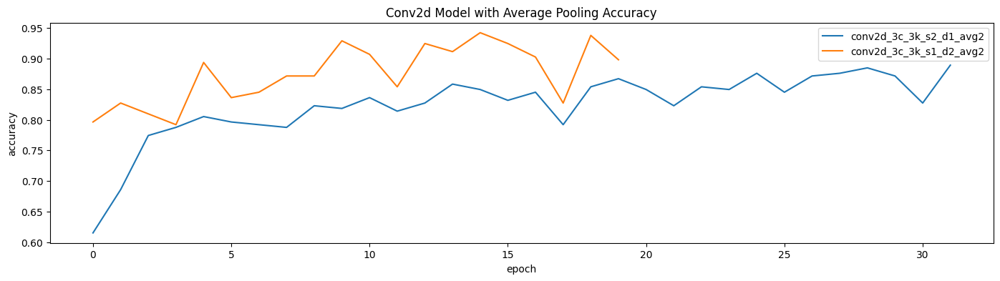

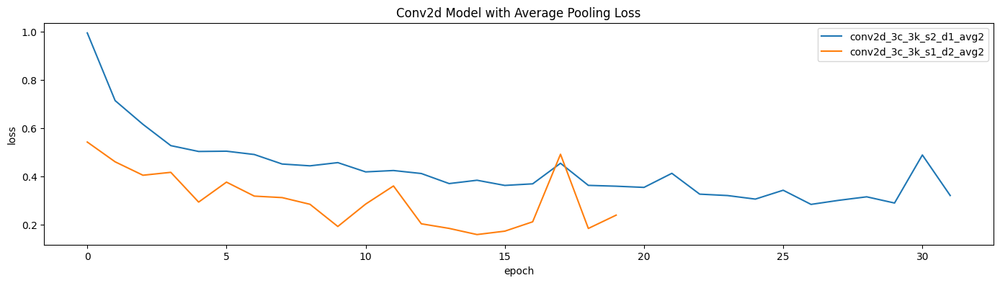

In [ ]:
print(colored("Conv2d Model with Average Pooling models:\n\n", 'yellow', attrs=['bold']))
plot_multi_plots(names=["conv2d_3c_3k_s2_d1_avg2", "conv2d_3c_3k_s1_d2_avg2"],
                 history=[history_conv2d_with_pooling_S2_d1_avg_2, history_conv2d_with_pooling_S1_d2_avg_2],
                 purpose="val_accuracy", title="Conv2d Model with Average Pooling Accuracy", y_label="accuracy")
print()
plot_multi_plots(names=["conv2d_3c_3k_s2_d1_avg2", "conv2d_3c_3k_s1_d2_avg2"],
                 history=[history_conv2d_with_pooling_S2_d1_avg_2, history_conv2d_with_pooling_S1_d2_avg_2],
                 purpose="val_loss", title="Conv2d Model with Average Pooling Loss", y_label="loss")

### Conv2d Model with **Max Pooling**

Conv2d Model with Max Pooling 2 S2 D1

In [ ]:
history_conv2d_with_pooling_S2_d1_max_2_, model = conv2model_pooling(epochs=200, kernel_size=3, strides=2, padding='same', dilation=1, dense=64,
                                                                       pooling_function=MaxPooling2D, pool_size=(2, 2), lr=0.0010142202510360857)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 64, 64, 16)        448       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 32, 32, 16)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 16, 16, 32)        4640      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 8, 8, 32)         0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 4, 4, 48)          13872     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 2, 2, 48)         0

0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 1s 157ms/step - loss: 0.2881 - accuracy: 0.8982


Plots:




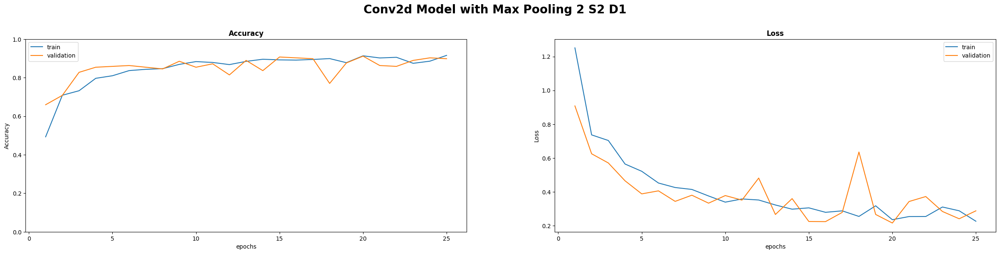



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



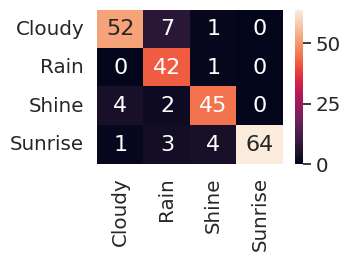



               precision    recall  f1-score   support

           0     0.9123    0.8667    0.8889        60
           1     0.7778    0.9767    0.8660        43
           2     0.8824    0.8824    0.8824        51
           3     1.0000    0.8889    0.9412        72

    accuracy                         0.8982       226
   macro avg     0.8931    0.9037    0.8946       226
weighted avg     0.9079    0.8982    0.8997       226
 



Conv2d Model with Max Pooling 2 S2 D1: 

╒═══════════════════════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers                      │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                                       │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according t

In [ ]:
history_conv2d_with_pooling_S2_d1_max_2 = print_full_results("Conv2d Model with Max Pooling 2 S2 D1", model, history_conv2d_with_pooling_S2_d1_max_2_, validation_generator)

Conv2d Model with Max Pooling 2 S1 D2

In [ ]:
history_conv2d_with_pooling_S1_d2_max_2_, model = conv2model_pooling(epochs=200, kernel_size=3, strides=1, padding='same', dilation=2, dense=64,
                                                                       pooling_function=MaxPooling2D, pool_size=(2, 2), lr=0.0010142202510360857)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 64, 64, 16)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 64, 64, 32)        4640      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 32, 32, 32)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 32, 32, 48)        13872     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 16, 16, 48)       0

0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 1s 161ms/step - loss: 0.1595 - accuracy: 0.9469


Plots:




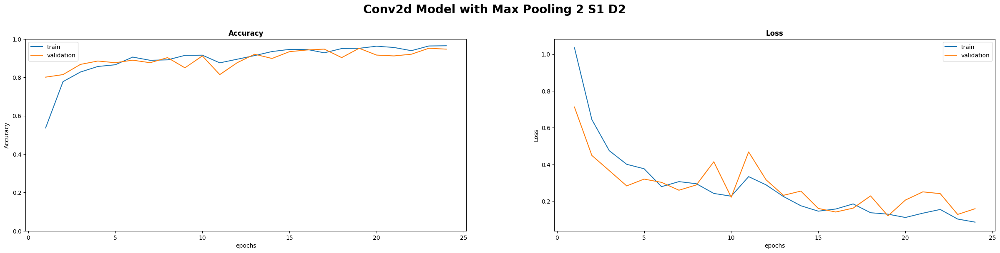



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



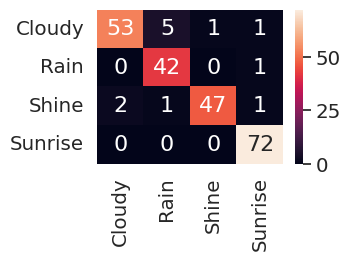



               precision    recall  f1-score   support

           0     0.9636    0.8833    0.9217        60
           1     0.8750    0.9767    0.9231        43
           2     0.9792    0.9216    0.9495        51
           3     0.9600    1.0000    0.9796        72

    accuracy                         0.9469       226
   macro avg     0.9445    0.9454    0.9435       226
weighted avg     0.9491    0.9469    0.9467       226
 



Conv2d Model with Max Pooling 2 S1 D2: 

╒═══════════════════════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers                      │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                                       │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according t

In [ ]:
history_conv2d_with_pooling_S1_d2_max_2 = print_full_results("Conv2d Model with Max Pooling 2 S1 D2", model, history_conv2d_with_pooling_S1_d2_max_2_, validation_generator)

#### Conv2d Model with **Max Pooling** results 

In [ ]:
print(colored("Conv2d Model with Max Pooling models:\n", 'yellow', attrs=['bold']), "\n")
print(print_table(
    [find_max_i(history_conv2d_with_pooling_S2_d1_max_2), find_max_i(history_conv2d_with_pooling_S1_d2_max_2)],

    head=["Number of Layers",
          "Accuracy and Loss of train set\naccording to Min train Loss",
          "Accuracy and Loss of val set\naccording to Min val Loss",
          "Accuracy and Loss of train set\naccording to Max train Accuracy",
          "Accuracy and Loss of val set\naccording to Max val Accuracy"],
    rows=["conv2d_3c_3k_s2_d1_max2", "conv2d_3c_3k_s1_d2_max2"]))


Conv2d Model with Max Pooling modles:
 

╒═════════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers        │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                         │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞═════════════════════════╪══════════════════════════════════╪════════════════════════════════╪═══════════════════════════════════╪═════════════════════════════════╡
│ conv2d_3c_3k_s2_d1_max2 │ (epoch index:24)                 │ (epoch index:19)               │ (epoch index:24)                  │ (epoch index:19)                │
│                         │ Accuracy: 0.9154615998268127     │ Accuracy: 0.9115044474601746   │ Accuracy: 0.9154615998268127     

Conv2d Model with Max Pooling modles:




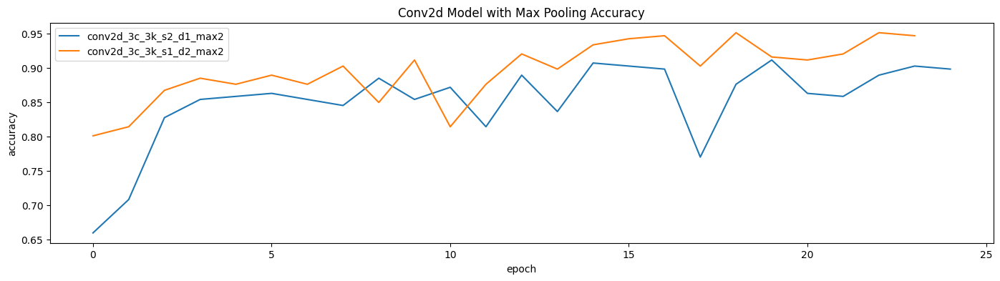

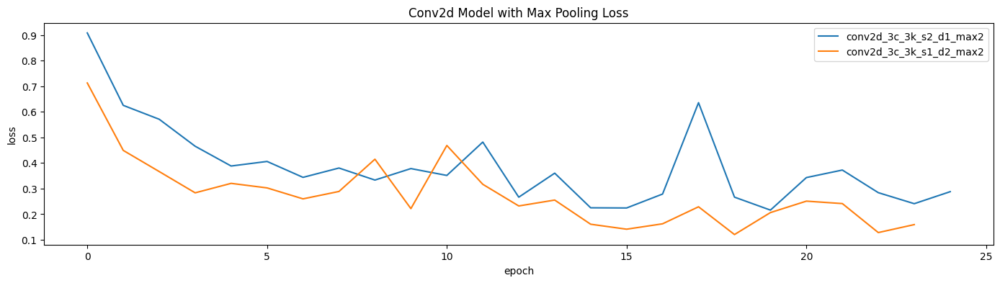

In [ ]:
print(colored("Conv2d Model with Max Pooling models:\n\n", 'yellow', attrs=['bold']))
plot_multi_plots(names=["conv2d_3c_3k_s2_d1_max2", "conv2d_3c_3k_s1_d2_max2"],
                 history=[history_conv2d_with_pooling_S2_d1_max_2, history_conv2d_with_pooling_S1_d2_max_2],
                 purpose="val_accuracy", title="Conv2d Model with Max Pooling Accuracy", y_label="accuracy")
print()
plot_multi_plots(names=["conv2d_3c_3k_s2_d1_max2", "conv2d_3c_3k_s1_d2_max2"],
                 history=[history_conv2d_with_pooling_S2_d1_max_2, history_conv2d_with_pooling_S1_d2_max_2],
                 purpose="val_loss", title="Conv2d Model with Max Pooling Loss", y_label="loss")

### Conv2d Model with Pooling layer results 

In [ ]:
print(colored("Conv2d Model with Pooling layer models:\n", 'yellow', attrs=['bold']), "\n")
print(print_table(
    [find_max_i(history_conv2d_with_pooling_S2_d1_avg_2), find_max_i(history_conv2d_with_pooling_S1_d2_avg_2),
     find_max_i(history_conv2d_with_pooling_S2_d1_max_2), find_max_i(history_conv2d_with_pooling_S1_d2_max_2)],

    head=["Number of Layers",
          "Accuracy and Loss of train set\naccording to Min train Loss",
          "Accuracy and Loss of val set\naccording to Min val Loss",
          "Accuracy and Loss of train set\naccording to Max train Accuracy",
          "Accuracy and Loss of val set\naccording to Max val Accuracy"],
    rows=["conv2d_3c_3k_s2_d1_avg2", "conv2d_3c_3k_s1_d2_avg2", "conv2d_3c_3k_s2_d1_max2", "conv2d_3c_3k_s1_d2_max2"]))


Conv2d Model with Pooling layer modles:
 

╒═════════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers        │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                         │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞═════════════════════════╪══════════════════════════════════╪════════════════════════════════╪═══════════════════════════════════╪═════════════════════════════════╡
│ conv2d_3c_3k_s2_d1_avg2 │ (epoch index:30)                 │ (epoch index:26)               │ (epoch index:30)                  │ (epoch index:31)                │
│                         │ Accuracy: 0.8676307201385498     │ Accuracy: 0.8716813921928406   │ Accuracy: 0.8676307201385498   

Conv2d Model with Pooling layer modles:




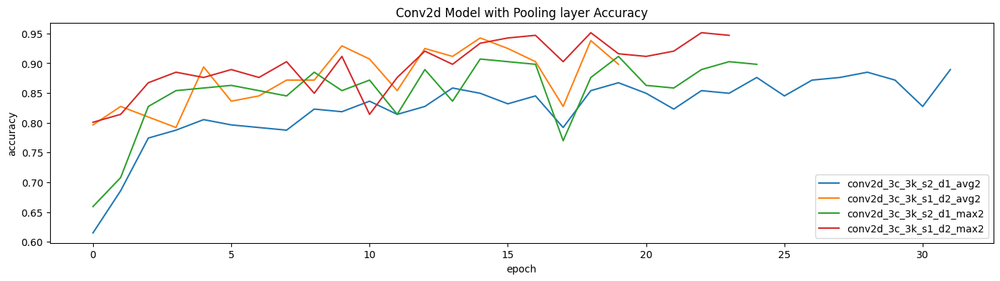

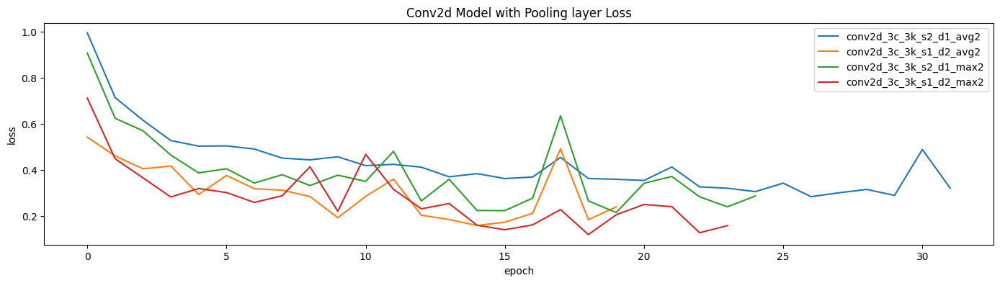

In [ ]:
print(colored("Conv2d Model with Pooling layer models:\n\n", 'yellow', attrs=['bold']))
plot_multi_plots(names=["conv2d_3c_3k_s2_d1_avg2", "conv2d_3c_3k_s1_d2_avg2", "conv2d_3c_3k_s2_d1_max2", "conv2d_3c_3k_s1_d2_max2"],
                 history=[history_conv2d_with_pooling_S2_d1_avg_2, history_conv2d_with_pooling_S1_d2_avg_2,
                          history_conv2d_with_pooling_S2_d1_max_2, history_conv2d_with_pooling_S1_d2_max_2],
                 purpose="val_accuracy", title="Conv2d Model with Pooling layer Accuracy", y_label="accuracy")
print()
plot_multi_plots(names=["conv2d_3c_3k_s2_d1_avg2", "conv2d_3c_3k_s1_d2_avg2", "conv2d_3c_3k_s2_d1_max2", "conv2d_3c_3k_s1_d2_max2"],
                 history=[history_conv2d_with_pooling_S2_d1_avg_2, history_conv2d_with_pooling_S1_d2_avg_2,
                          history_conv2d_with_pooling_S2_d1_max_2, history_conv2d_with_pooling_S1_d2_max_2],
                 purpose="val_loss", title="Conv2d Model with Pooling layer Loss", y_label="loss")

## Dropout and Batch norm

###Dropout


<div>
<img src="https://drive.google.com/uc?export=view&id=197sUHknGL_RZGaoDy3pLBGH6DlF6ahCi" alt="dropout example"/>
</div>

[why not applying dropout layer between convolutional layers](https://towardsdatascience.com/dropout-on-convolutional-layers-is-weird-5c6ab14f19b2): it providesd noise in model

rather we will apply this layer after flattening the convolution layer

In [ ]:
# reset outputing dir
output_dir = 'models/my_dir'
if os.path.exists(output_dir):
    shutil.rmtree(output_dir)

In [ ]:
def dtopout_model(max_trial, kernel_size=3, strides=1, padding='same', dilation=2, dense=64, pooling_function=MaxPooling2D, pool_size=(2, 2), lr=0.0010142202510360857):
    tf.keras.backend.clear_session()
    # fixing the seed 
    set_random_seed()

    def simple_model(hp):
        #  set random seed
        set_random_seed()

        # Dropout sampling rate
        dropout = hp.Float('dropout', 0, 0.5, step=0.1, default=0.1)

        model = tf.keras.Sequential()
        # input layer
        model.add(tf.keras.layers.Conv2D(filters=16, kernel_size=kernel_size, strides=strides, padding=padding, dilation_rate=dilation, activation='relu', input_shape=(avg_height, avg_width, 3)))
        # pooling
        model.add(pooling_function(pool_size=pool_size))

        # secend conv
        model.add(tf.keras.layers.Conv2D(filters=32, kernel_size=kernel_size, strides=strides, padding=padding, dilation_rate=dilation, activation='relu'))
        # pooling
        model.add(pooling_function(pool_size=pool_size))

        # third conv
        model.add(tf.keras.layers.Conv2D(filters=48, kernel_size=kernel_size, strides=strides, padding=padding, dilation_rate=dilation, activation='relu'))
        # pooling
        model.add(pooling_function(pool_size=pool_size))

        #  flatten
        model.add(tf.keras.layers.Flatten())
        # Dropout layer
        model.add(Dropout(dropout))

        # dense
        model.add(tf.keras.layers.Dense(64, activation='relu'))

        # output layer
        model.add(Dense(4, activation='softmax'))

        # print model summary
        model.summary()

        # compiling the model
        model.compile(loss='categorical_crossentropy',
                      optimizer=Adam(lr),
                      metrics=['accuracy'], )
        return model

    # define search
    simple_tuner = kt.RandomSearch(
    hypermodel=simple_model,
    objective="val_accuracy",
    max_trials=max_trial,
    executions_per_trial=1,
    overwrite=True,
    directory=output_dir,
    seed=seed,
    project_name=f"dropout",
    )
        
    print()

    # summary of tuner
    simple_tuner.search_space_summary(extended=False)

    return simple_tuner

In [ ]:
def dropout_tuner_run(simple_tuner, epochs=200):
    tf.keras.backend.clear_session()
    # fixing the seed
    set_random_seed()

    # defining early stop
    # patience is the number of epochs if there is no improvement, the algorithm will early stop.
    stop_early = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)

    # regenrating the sets
    print()
    train_generator, validation_generator = generate_sets()
    print()

    # running search for best simple model
    simple_tuner.search(train_generator,
                        epochs=epochs,
                        steps_per_epoch=int(np.ceil(train_generator.samples / train_generator.batch_size)),  # ~28
                        validation_data=validation_generator,
                        # overwrite=False,
                        # verbose=0,
                        callbacks=[stop_early, tf.keras.callbacks.TensorBoard("/tmp/tb_logs")])
    return simple_tuner

In [ ]:
tuner = dtopout_model(max_trial=999 ,kernel_size=3, strides=1, padding='same', dilation=2, dense=64, pooling_function=MaxPooling2D, pool_size=(2, 2), lr=0.0010142202510360857)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 64, 64, 16)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 64, 64, 32)        4640      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 32, 32, 32)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 32, 32, 48)        13872     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 16, 16, 48)       0

In [ ]:
tuner = dropout_tuner_run(tuner, epochs=200)

Trial 6 Complete [00h 02m 13s]
val_accuracy: 0.9159291982650757

Best val_accuracy So Far: 0.9513274431228638
Total elapsed time: 00h 18m 58s
INFO:tensorflow:Oracle triggered exit


In [ ]:
def results(tuner):
    # remove all checkpoints data
    # remove_checkpoint_data()

    # print tuner summary
    tuner.results_summary(num_trials=1)
    print()
    print()

    # get best learning rate
    best_dropout = tuner.get_best_hyperparameters(num_trials=1)[0].get("dropout")
    print("dropout:", best_dropout)

    return best_dropout


results(tuner)


Results summary
Results in models/my_dir/dropout
Showing 1 best trials
Trial summary
Hyperparameters:
dropout: 0.1
Score: 0.9513274431228638


dropout: 0.1


0.1

### Dropout Results

save dropout results in drive

In [ ]:
# from google.colab import drive
# drive.mount('/content/gdrive')
# !zip -rqo /content/gdrive/MyDrive/Shared/AI/DL14002/DL14002_E3/logs/dropout.zip /tmp/tb_logs

In [ ]:
# Downloading dataset zip file
!gdown 1J_P-lgJiZlbxpjCUgYYM7fxAjap9sDiG

# silently unzip and overwrite
!unzip -qq -o /content/dropout.zip -d /

Downloading...
From: https://drive.google.com/uc?id=1J_P-lgJiZlbxpjCUgYYM7fxAjap9sDiG
To: /content/dropout.zip
100% 191k/191k [00:00<00:00, 69.6MB/s]


In [ ]:
# %load_ext  tensorboard

%tensorboard --logdir /tmp/tb_logs

<IPython.core.display.Javascript object>

### Batch Normalization

<div>
<img src="https://drive.google.com/uc?export=view&id=1KsW1jyyJo6ao5X9OWiq9V6XTrv4MzpQC" alt="dilation example" />
</div>

model without batchnormlization

In [ ]:
history_conv2d_model_without_batch_, model = conv2model_pooling(epochs=200, kernel_size=3, strides=1, padding='same', dilation=2, dense=64,
                                                                       pooling_function=MaxPooling2D, pool_size=(2, 2), lr=0.0010142202510360857)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 64, 64, 16)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 64, 64, 32)        4640      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 32, 32, 32)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 32, 32, 48)        13872     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 16, 16, 48)       0

0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 2s 187ms/step - loss: 0.2493 - accuracy: 0.9115


Plots:




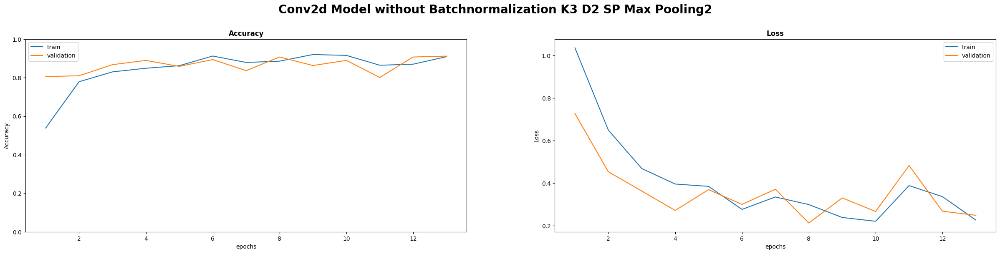



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



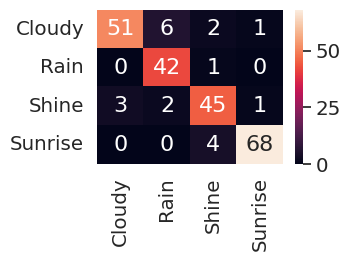



               precision    recall  f1-score   support

           0     0.9444    0.8500    0.8947        60
           1     0.8400    0.9767    0.9032        43
           2     0.8654    0.8824    0.8738        51
           3     0.9714    0.9444    0.9577        72

    accuracy                         0.9115       226
   macro avg     0.9053    0.9134    0.9074       226
weighted avg     0.9153    0.9115    0.9117       226
 



Conv2d Model without Batchnormalization K3 D2 SP Max Pooling2: 

╒═══════════════════════════════════════════════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers                                              │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                                                               │ according to Min tr

In [ ]:
history_conv2d_model_without_batch = print_full_results("Conv2d Model without Batchnormalization K3 D2 SP Max Pooling2",
                                                        model, history_conv2d_model_without_batch_, validation_generator)

model with batchnormlization

In [ ]:
def batch_norm(epochs=1, kernel_size=3, strides=1, padding='valid', dilation=2, dense=64,
               pooling_function=AveragePooling2D, pool_size=(2, 2), lr=0.0010142202510360857, optimizer=Adam, activation='relu', return_model=False):
    tf.keras.backend.clear_session()

    # fixing the seed
    set_random_seed()

    model = tf.keras.Sequential()

    # input layer
    model.add(Conv2D(filters=16, kernel_size=kernel_size, strides=strides, padding=padding, dilation_rate=dilation, input_shape=(avg_height, avg_width, 3)))
    # batch norm
    model.add(BatchNormalization())
    model.add(Activation(activation))
    # pooling
    model.add(pooling_function(pool_size=pool_size))

    # secend conv
    model.add(Conv2D(filters=32, kernel_size=kernel_size, strides=strides, padding=padding, dilation_rate=dilation))
    # batch norm
    model.add(BatchNormalization())
    model.add(Activation(activation))
    # pooling
    model.add(pooling_function(pool_size=pool_size))

    # third conv
    model.add(Conv2D(filters=48, kernel_size=kernel_size, strides=strides, padding=padding, dilation_rate=dilation))
    # batch norm
    model.add(BatchNormalization())
    model.add(Activation(activation))
    # pooling
    model.add(pooling_function(pool_size=pool_size))

    #  flatten
    model.add(Flatten())
    # batch norm
    model.add(BatchNormalization())

    # Dense
    model.add(Dense(64))
    # batch norm
    model.add(BatchNormalization())
    model.add(Activation(activation))

    # output layer
    model.add(Dense(4, activation='softmax'))

    # print model summary
    model.summary()

    # compiling the model
    model.compile(loss='categorical_crossentropy',
                  optimizer=optimizer(lr),
                  metrics=['accuracy'], )
    if return_model:
      return model
    # regenrating the sets
    print()
    train_generator, validation_generator = generate_sets()
    print()
    print()

    # defining early stop
    # patience is the number of epochs if there is no improvement, the algorithm will early stop.
    stop_early = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)

    # training the model
    hist_inc = model.fit(train_generator,
                         validation_data=validation_generator,
                         epochs=epochs,
                         steps_per_epoch=int(np.ceil(train_generator.samples / train_generator.batch_size)),  # ~28
                         verbose=0,
                         callbacks=[stop_early, TqdmCallback(verbose=0)])

    return hist_inc, model


In [ ]:
history_conv2d_model_with_batch_, model = batch_norm(epochs=200, kernel_size=3, strides=1, padding='same', dilation=2, dense=64,
                                                                       pooling_function=MaxPooling2D, pool_size=(2, 2), lr=0.0010142202510360857)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 16)      448       
                                                                 
 batch_normalization (BatchN  (None, 128, 128, 16)     64        
 ormalization)                                                   
                                                                 
 activation (Activation)     (None, 128, 128, 16)      0         
                                                                 
 max_pooling2d (MaxPooling2D  (None, 64, 64, 16)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 64, 64, 32)        4640      
                                                                 
 batch_normalization_1 (Batc  (None, 64, 64, 32)       1

0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 2s 189ms/step - loss: 0.2529 - accuracy: 0.8938


Plots:




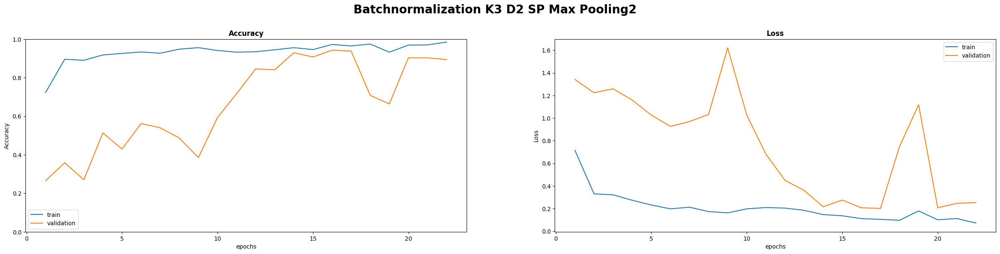



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



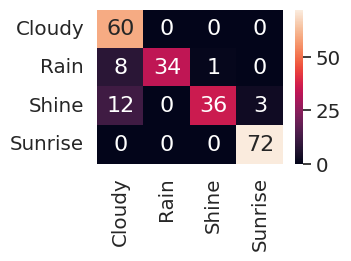



               precision    recall  f1-score   support

           0     0.7500    1.0000    0.8571        60
           1     1.0000    0.7907    0.8831        43
           2     0.9730    0.7059    0.8182        51
           3     0.9600    1.0000    0.9796        72

    accuracy                         0.8938       226
   macro avg     0.9207    0.8741    0.8845       226
weighted avg     0.9148    0.8938    0.8923       226
 



Batchnormalization K3 D2 SP Max Pooling2: 

╒══════════════════════════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers                         │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                                          │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │

In [ ]:
history_conv2d_model_with_batch = print_full_results("Batchnormalization K3 D2 SP Max Pooling2",
                                                        model, history_conv2d_model_with_batch_, validation_generator)

### Batch Normalization results 

In [ ]:
print(colored("Conv2d Models with and without Batch normalization:\n", 'yellow', attrs=['bold']), "\n")
print(print_table(
    [find_max_i(history_conv2d_model_without_batch), find_max_i(history_conv2d_model_with_batch)],

    head=["Number of Layers",
          "Accuracy and Loss of train set\naccording to Min train Loss",
          "Accuracy and Loss of val set\naccording to Min val Loss",
          "Accuracy and Loss of train set\naccording to Max train Accuracy",
          "Accuracy and Loss of val set\naccording to Max val Accuracy"],
   rows=["conv2d model without batch normalization", "conv2d model with batch normalization"]))

Conv2d Models with and without Batch normalization:
 

╒══════════════════════════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers                         │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                                          │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞══════════════════════════════════════════╪══════════════════════════════════╪════════════════════════════════╪═══════════════════════════════════╪═════════════════════════════════╡
│ conv2d model without batch normalization │ (epoch index:9)                  │ (epoch index:7)                │ (epoch index:8)                   │ (epoch index:12)                │
│                             

Conv2d Models with and without Batch normalization:




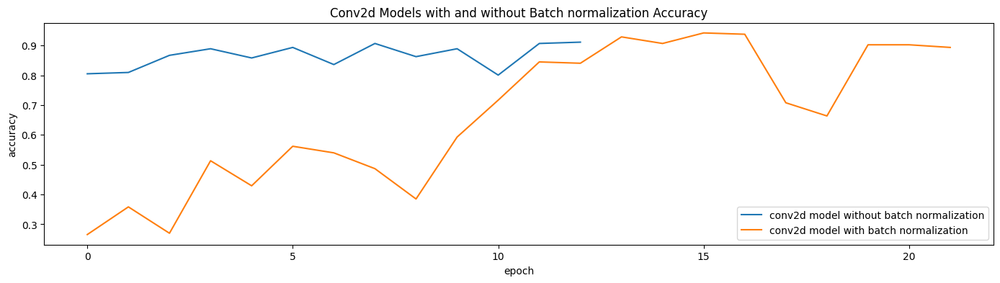

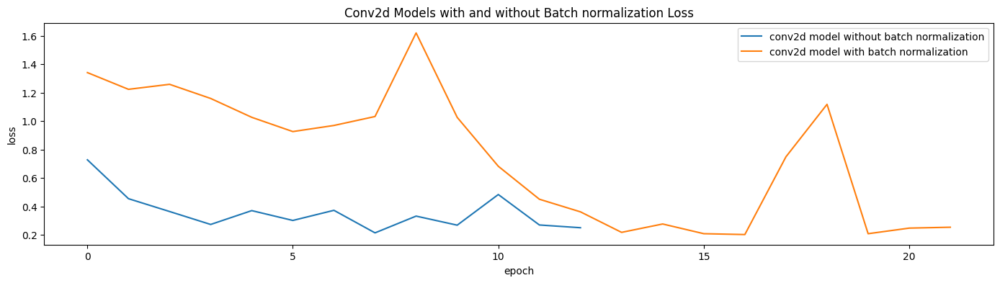

In [ ]:
print(colored("Conv2d Models with and without Batch normalization:\n\n", 'yellow', attrs=['bold']))
plot_multi_plots(names=["conv2d model without batch normalization", "conv2d model with batch normalization"],
                 history=[history_conv2d_model_without_batch, history_conv2d_model_with_batch,],
                 purpose="val_accuracy", title="Conv2d Models with and without Batch normalization Accuracy", y_label="accuracy")
print()
plot_multi_plots(names=["conv2d model without batch normalization", "conv2d model with batch normalization"],
                 history=[history_conv2d_model_without_batch, history_conv2d_model_with_batch,],
                 purpose="val_loss", title="Conv2d Models with and without Batch normalization Loss", y_label="loss")

## ResNet

<div>
<img src="https://drive.google.com/uc?export=view&id=1iBJvnrP3Nfv_ZmSVAOjOQk-p2yBvqBOu" alt="dilation example" width="300"/>
</div>

###Resnet 1

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 128, 128, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_1 (Conv2D)              (None, 128, 128, 64  1792        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 conv2d_2 (Conv2D)              (None, 128, 128, 64  36928       ['conv2d_1[0][0]']               
                                )                                                             

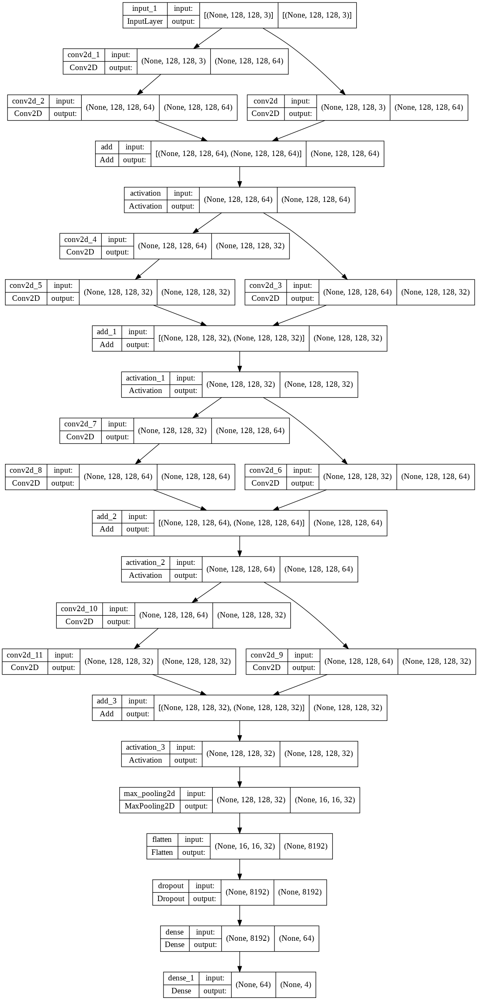

In [ ]:
def resnet1():
    # set random seed
    set_random_seed()
    tf.keras.backend.clear_session()

    # function for creating an identity or projection residual module
    def residual_module(layer_in, n_filters):
        merge_input = layer_in
        # check if the number of filters needs to be increase, assumes channels last format
        if layer_in.shape[-1] != n_filters:
            merge_input = Conv2D(n_filters, (1, 1), padding='same', activation='relu', kernel_initializer='he_normal')(layer_in)
        # conv1
        conv1 = Conv2D(n_filters, (3, 3), padding='same', activation='relu', kernel_initializer='he_normal')(layer_in)
        # conv2
        conv2 = Conv2D(n_filters, (3, 3), padding='same', activation='linear', kernel_initializer='he_normal')(conv1)
        # add filters, assumes filters/channels last
        layer_out = add([conv2, merge_input])
        # activation function
        layer_out = Activation('relu')(layer_out)
        return layer_out

    # define model input
    visible = Input(shape=(128, 128, 3))
    # add vgg module
    layer = residual_module(visible, 64)

    layer = residual_module(layer, 32)

    layer = residual_module(layer, 64)

    layer = residual_module(layer, 32)

    # pooling
    pooling = MaxPooling2D(pool_size=(2, 2), strides=8)(layer)

    flatten = Flatten()(pooling)

    # Dropout layer
    dropout = Dropout(0.1)(flatten)
    # dense
    dense = Dense(64, activation='relu')(dropout)
    # out layer
    output = Dense(4, activation='softmax')(dense)
    # create model
    model = Model(inputs=visible, outputs=output)
    # summarize model
    model.summary()

    return model

model = resnet1()
# plot model architecture
plot_model(model, show_shapes=True, to_file='inception_module.png')

In [ ]:
lr = 0.0010142202510360857
# compiling the model
model.compile(loss='categorical_crossentropy',
              optimizer=Adam(lr),
              metrics=['accuracy'], )

# regenrating the sets
print()
train_generator, validation_generator = generate_sets()
print()
print()

# defining early stop
# patience is the number of epochs if there is no improvement, the algorithm will early stop.
stop_early = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)

# training the model
resnet_history_1_ = model.fit(train_generator,
                      validation_data=validation_generator,
                      epochs=100,
                      steps_per_epoch=int(np.ceil(train_generator.samples / train_generator.batch_size)),  # ~28
                      verbose=0,
                      callbacks=[stop_early, TqdmCallback(verbose=0)])


Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.




0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 2s 229ms/step - loss: 0.3242 - accuracy: 0.9027


Plots:




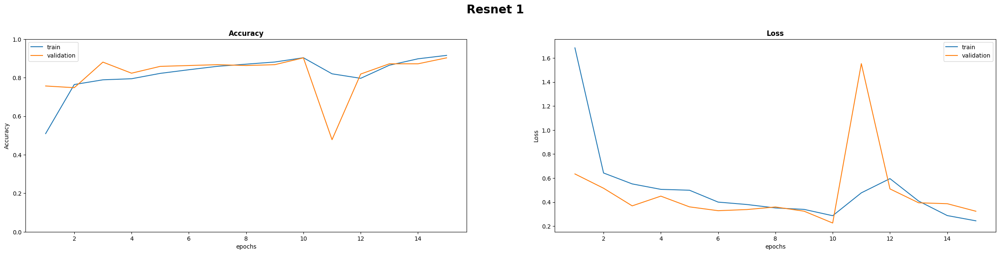



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



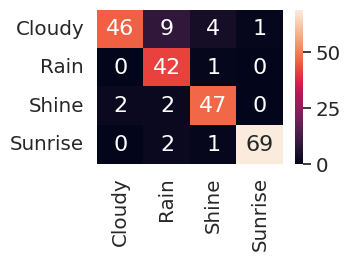



               precision    recall  f1-score   support

           0     0.9583    0.7667    0.8519        60
           1     0.7636    0.9767    0.8571        43
           2     0.8868    0.9216    0.9038        51
           3     0.9857    0.9583    0.9718        72

    accuracy                         0.9027       226
   macro avg     0.8986    0.9058    0.8962       226
weighted avg     0.9139    0.9027    0.9028       226
 



Resnet 1: 

╒════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers   │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                    │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════════════╪══════════════════════════════════╪══════

In [ ]:
resnet_history_1 = print_full_results("Resnet 1", model, resnet_history_1_, validation_generator)

###Resnet 2

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 128, 128, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_1 (Conv2D)              (None, 128, 128, 64  1792        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 conv2d_2 (Conv2D)              (None, 128, 128, 64  36928       ['conv2d_1[0][0]']               
                                )                                                             

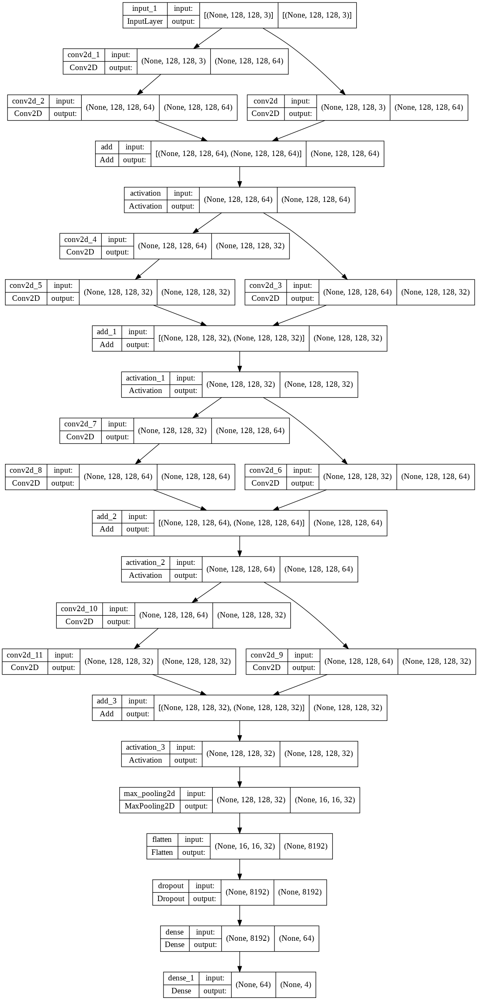

In [ ]:
def resnet2():
    # set random seed
    set_random_seed()
    tf.keras.backend.clear_session()

    # function for creating an identity or projection residual module
    def residual_module(layer_in, n_filters):
        merge_input = layer_in
        # check if the number of filters needs to be increase, assumes channels last format
        if layer_in.shape[-1] != n_filters:
            merge_input = Conv2D(n_filters, (1, 1), padding='valid', activation='relu', kernel_initializer='he_normal')(layer_in)
        # conv1
        conv1 = Conv2D(n_filters, (5, 5), padding='valid', activation='relu', kernel_initializer='he_normal')(layer_in)
        # conv2
        conv2 = Conv2D(n_filters, (5, 5), padding='valid', activation='linear', kernel_initializer='he_normal')(conv1)
        # add filters, assumes filters/channels last
        layer_out = add([conv2, merge_input])
        # activation function
        layer_out = Activation('relu')(layer_out)
        return layer_out

    # define model input
    visible = Input(shape=(128, 128, 3))
    # add vgg module
    layer = residual_module(visible, 64)

    layer = residual_module(layer, 32)

    layer = residual_module(layer, 64)
    
    layer = residual_module(layer, 32)

    layer = residual_module(layer, 32)

    # pooling
    pooling = MaxPooling2D(pool_size=(3, 3), strides=6)(layer)

    flatten = Flatten()(pooling)

    # Dropout layer
    dropout = Dropout(0.2)(flatten)
    # dense
    dense = Dense(64, activation='relu')(dropout)
    # out layer
    output = Dense(4, activation='softmax')(dense)
    # create model
    model = Model(inputs=visible, outputs=output)
    # summarize model
    model.summary()

    return model

model = resnet1()
# plot model architecture
plot_model(model, show_shapes=True, to_file='inception_module.png')

In [ ]:
lr = 0.0010142202510360857
# compiling the model
model.compile(loss='categorical_crossentropy',
              optimizer=Adam(lr),
              metrics=['accuracy'], )

# regenrating the sets
print()
train_generator, validation_generator = generate_sets()
print()
print()

# defining early stop
# patience is the number of epochs if there is no improvement, the algorithm will early stop.
stop_early = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)

# training the model
resnet_history_2_ = model.fit(train_generator,
                      validation_data=validation_generator,
                      epochs=100,
                      steps_per_epoch=int(np.ceil(train_generator.samples / train_generator.batch_size)),  # ~28
                      verbose=0,
                      callbacks=[stop_early, TqdmCallback(verbose=0)])


Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.




0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 2s 222ms/step - loss: 0.1822 - accuracy: 0.9292


Plots:




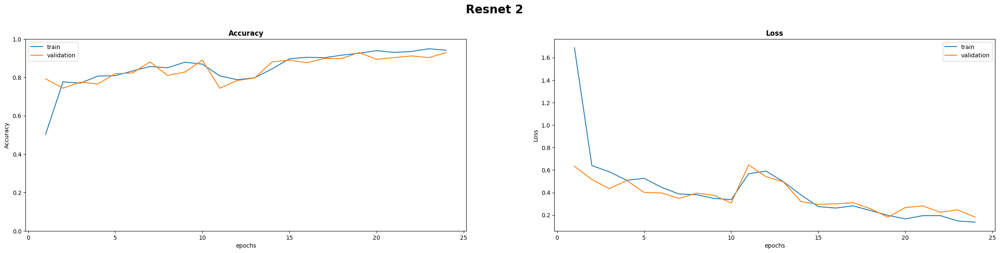



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



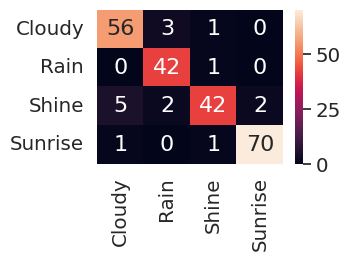



               precision    recall  f1-score   support

           0     0.9032    0.9333    0.9180        60
           1     0.8936    0.9767    0.9333        43
           2     0.9333    0.8235    0.8750        51
           3     0.9722    0.9722    0.9722        72

    accuracy                         0.9292       226
   macro avg     0.9256    0.9265    0.9246       226
weighted avg     0.9302    0.9292    0.9285       226
 



Resnet 2: 

╒════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers   │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                    │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════════════╪══════════════════════════════════╪══════

In [ ]:
resnet_history_2 = print_full_results("Resnet 2", model, resnet_history_2_, validation_generator)

###Resnet 3

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 128, 128, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_1 (Conv2D)              (None, 128, 128, 64  1792        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 conv2d_2 (Conv2D)              (None, 128, 128, 64  36928       ['conv2d_1[0][0]']               
                                )                                                             

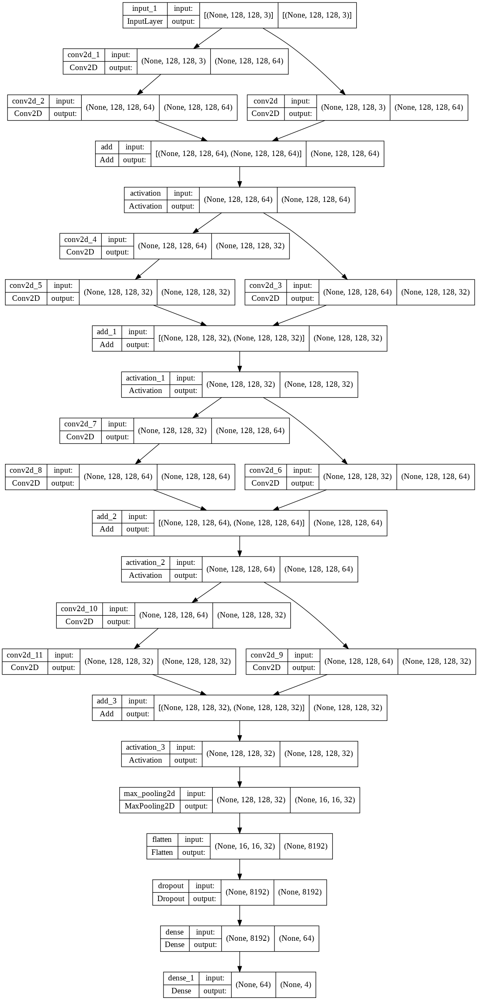

In [ ]:
def resnet3():
    # set random seed
    set_random_seed()
    tf.keras.backend.clear_session()

    # function for creating an identity or projection residual module
    def residual_module(layer_in, n_filters):
        merge_input = layer_in
        # check if the number of filters needs to be increase, assumes channels last format
        if layer_in.shape[-1] != n_filters:
            merge_input = Conv2D(n_filters, (1, 1), padding='valid', strides=3, activation='relu', kernel_initializer='he_normal')(layer_in)
        # conv1
        conv1 = Conv2D(n_filters, (3, 3), padding='valid', strides=3, activation='relu', kernel_initializer='he_normal')(layer_in)
        # conv2
        conv2 = Conv2D(n_filters, (3, 3), padding='valid', strides=3, activation='linear', kernel_initializer='he_normal')(conv1)
        # add filters, assumes filters/channels last
        layer_out = add([conv2, merge_input])
        # activation function
        layer_out = Activation('relu')(layer_out)
        return layer_out

    # define model input
    visible = Input(shape=(128, 128, 3))
    # add vgg module
    layer = residual_module(visible, 64)

    layer = residual_module(layer, 64)

    layer = residual_module(layer, 32)

    # pooling
    pooling = MaxPooling2D(pool_size=(2, 2), strides=8)(layer)

    flatten = Flatten()(pooling)

    # Dropout layer
    dropout = Dropout(0.3)(flatten)
    # dense
    dense = Dense(32, activation='relu')(dropout)
    # out layer
    output = Dense(4, activation='softmax')(dense)
    # create model
    model = Model(inputs=visible, outputs=output)
    # summarize model
    model.summary()

    return model

model = resnet1()
# plot model architecture
plot_model(model, show_shapes=True, to_file='inception_module.png')

In [ ]:
lr = 0.0010142202510360857
# compiling the model
model.compile(loss='categorical_crossentropy',
              optimizer=Adam(lr),
              metrics=['accuracy'], )

# regenrating the sets
print()
train_generator, validation_generator = generate_sets()
print()
print()

# defining early stop
# patience is the number of epochs if there is no improvement, the algorithm will early stop.
stop_early = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)

# training the model
resnet_history_3_ = model.fit(train_generator,
                      validation_data=validation_generator,
                      epochs=100,
                      steps_per_epoch=int(np.ceil(train_generator.samples / train_generator.batch_size)),  # ~28
                      verbose=0,
                      callbacks=[stop_early, TqdmCallback(verbose=0)])


Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.




0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 3s 323ms/step - loss: 0.3313 - accuracy: 0.8717


Plots:




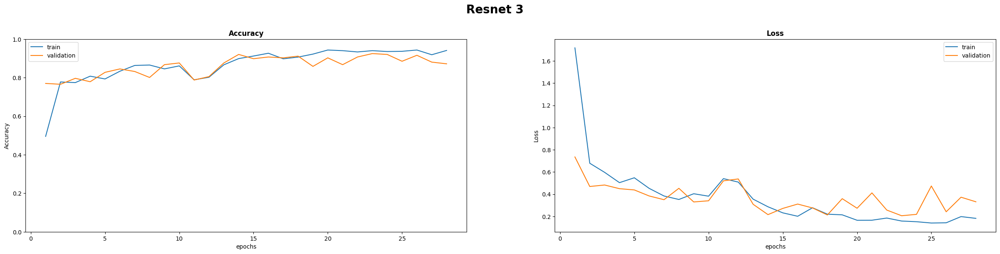



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



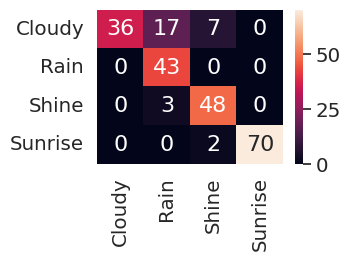



               precision    recall  f1-score   support

           0     1.0000    0.6000    0.7500        60
           1     0.6825    1.0000    0.8113        43
           2     0.8421    0.9412    0.8889        51
           3     1.0000    0.9722    0.9859        72

    accuracy                         0.8717       226
   macro avg     0.8812    0.8783    0.8590       226
weighted avg     0.9040    0.8717    0.8682       226
 



Resnet 3: 

╒════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers   │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                    │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════════════╪══════════════════════════════════╪══════

In [ ]:
resnet_history_3 = print_full_results("Resnet 3", model, resnet_history_3_, validation_generator)

### Resnet Models results 

In [ ]:
print(colored("Resnet models:\n", 'yellow', attrs=['bold']), "\n")
print(print_table(
    [find_max_i(resnet_history_1), find_max_i(resnet_history_2), find_max_i(resnet_history_3)],

    head=["Number of Layers",
          "Accuracy and Loss of train set\naccording to Min train Loss",
          "Accuracy and Loss of val set\naccording to Min val Loss",
          "Accuracy and Loss of train set\naccording to Max train Accuracy",
          "Accuracy and Loss of val set\naccording to Max val Accuracy"],
    rows=["Resnet 1", "Resnet 2", "Resnet 3"]))


Resnet modles:
 

╒════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers   │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                    │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════════════╪══════════════════════════════════╪════════════════════════════════╪═══════════════════════════════════╪═════════════════════════════════╡
│ Resnet 1           │ (epoch index:14)                 │ (epoch index:9)                │ (epoch index:14)                  │ (epoch index:9)                 │
│                    │ Accuracy: 0.9154615998268127     │ Accuracy: 0.9026548862457275   │ Accuracy: 0.9154615998268127      │ Accuracy: 0.9026548862457275    │
│               

Resnet modles:




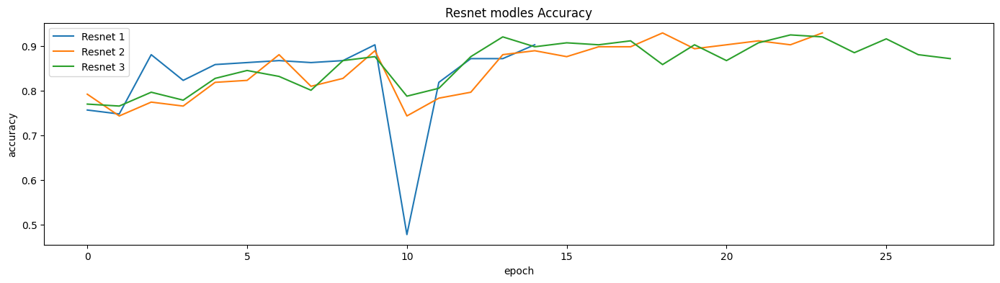

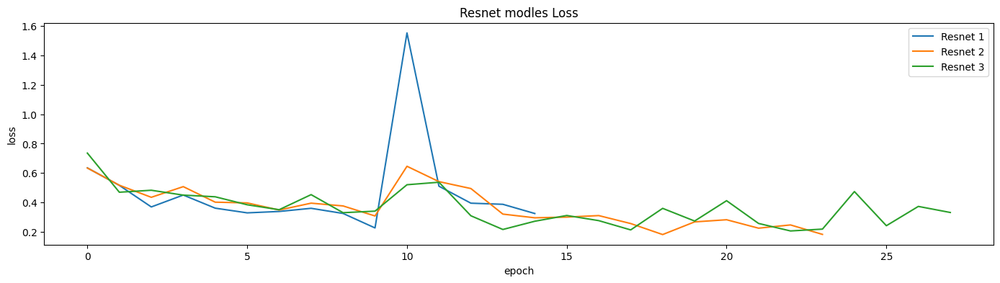

In [ ]:
print(colored("Resnet models:\n\n", 'yellow', attrs=['bold']))
plot_multi_plots(names=["Resnet 1", "Resnet 2", "Resnet 3"],
                 history=[resnet_history_1, resnet_history_2, resnet_history_3],
                 purpose="val_accuracy", title="Resnet models Accuracy", y_label="accuracy")
print()
plot_multi_plots(names=["Resnet 1", "Resnet 2", "Resnet 3"],
                 history=[resnet_history_1, resnet_history_2, resnet_history_3],
                 purpose="val_loss", title="Resnet models Loss", y_label="loss")

## Inception

<div>
<img src="https://drive.google.com/uc?export=view&id=13KPiXzkFeDxKX29yTP9B0P5T5ZYk8mCr" alt="inception example" width="600"/>
</div>

###Inception 1

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 128, 128, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_1 (Conv2D)              (None, 128, 128, 32  128         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 conv2d_3 (Conv2D)              (None, 128, 128, 32  128         ['input_1[0][0]']                
                                )                                                             

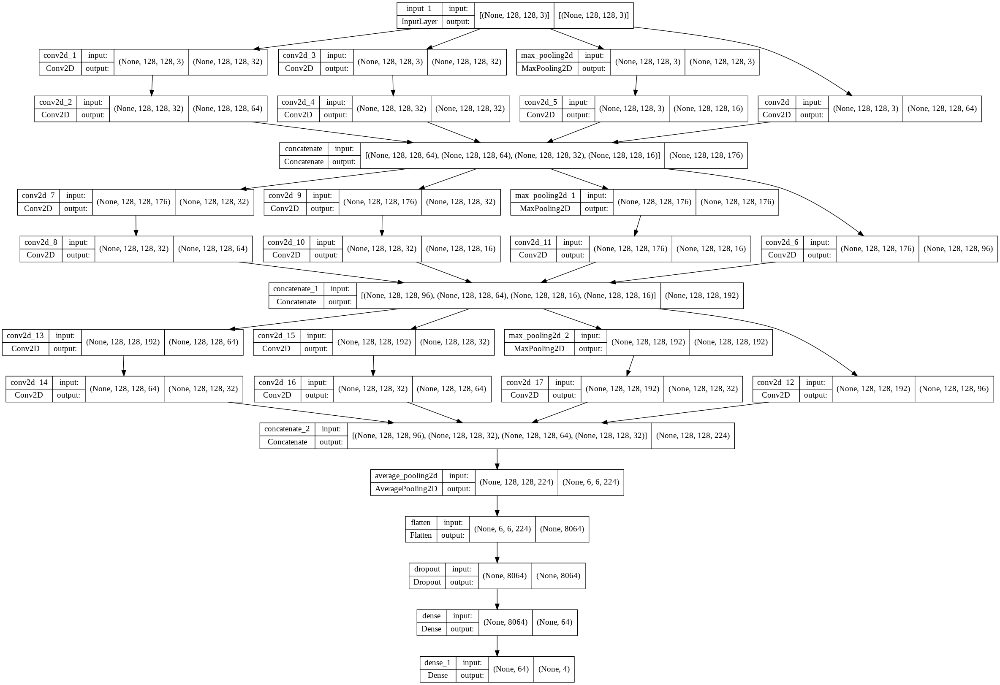

In [ ]:
def inception1():
    tf.keras.backend.clear_session()
    # set random seed
    set_random_seed()

    # function for creating a projected inception module
    def inception_module(layer_in, f1, f2_in, f2_out, f3_in, f3_out, f4_out):
        # 1x1 conv
        conv1 = Conv2D(f1, (1, 1), padding='same', activation='relu')(layer_in)
        # 3x3 conv
        conv3 = Conv2D(f2_in, (1, 1), padding='same', activation='relu')(layer_in)
        conv3 = Conv2D(f2_out, (3, 3), padding='same', activation='relu')(conv3)
        # 5x5 conv
        conv5 = Conv2D(f3_in, (1, 1), padding='same', activation='relu')(layer_in)
        conv5 = Conv2D(f3_out, (5, 5), padding='same', activation='relu')(conv5)
        # 3x3 max pooling
        pool = MaxPooling2D((3, 3), strides=(1, 1), padding='same')(layer_in)
        pool = Conv2D(f4_out, (1, 1), padding='same', activation='relu')(pool)
        # concatenate filters, assumes filters/channels last
        layer_out = concatenate([conv1, conv3, conv5, pool], axis=-1)

        return layer_out

    # define model input
    visible = Input(shape=(128, 128, 3))
    # add inception block 1
    layer = inception_module(visible, 64, 32, 64, 32, 32, 16)
    # add inception block 2
    layer = inception_module(layer, 96, 32, 64, 32, 16, 16)
    # add inception block 3
    layer = inception_module(layer, 96, 64, 32, 32, 64, 32)


    pool = AveragePooling2D((9, 9), strides=20, padding='valid')(layer)


    flatten = Flatten()(pool)

    # Dropout layer
    dropout = Dropout(0.1)(flatten)

    dense = tf.keras.layers.Dense(64, activation='relu')(dropout)

    output = tf.keras.layers.Dense(4, activation='softmax')(dense)

    model = Model(inputs=visible, outputs=output)

    # summarize model
    model.summary()

    return model

model = inception1()
# plot model architecture
plot_model(model, show_shapes=True, to_file='inception_module.png')

In [ ]:
lr = 0.0010142202510360857
# compiling the model
model.compile(loss='categorical_crossentropy',
              optimizer=Adam(lr),
              metrics=['accuracy'], )

# regenrating the sets
print()
train_generator, validation_generator = generate_sets()
print()
print()

# defining early stop
# patience is the number of epochs if there is no improvement, the algorithm will early stop.
stop_early = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)

# training the model
inception_history_1_ = model.fit(train_generator,
                      validation_data=validation_generator,
                      epochs=100,
                      steps_per_epoch=int(np.ceil(train_generator.samples / train_generator.batch_size)),  # ~28
                      verbose=0,
                      callbacks=[stop_early, TqdmCallback(verbose=0)])


Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.




0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 3s 284ms/step - loss: 0.2250 - accuracy: 0.8982


Plots:




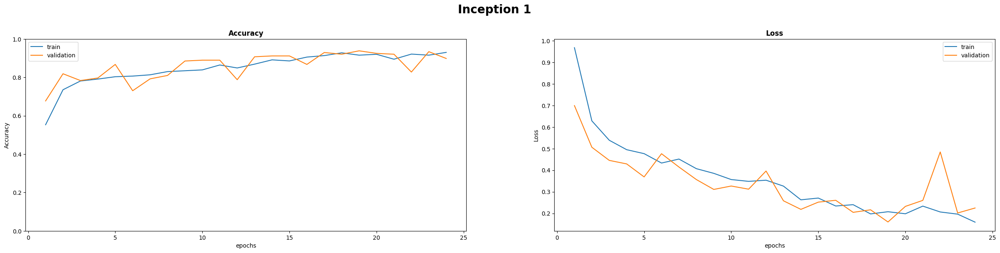



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



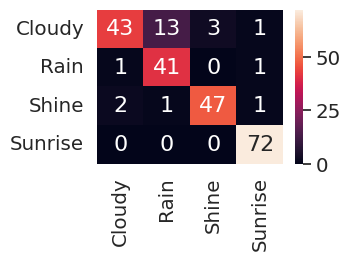



               precision    recall  f1-score   support

           0     0.9348    0.7167    0.8113        60
           1     0.7455    0.9535    0.8367        43
           2     0.9400    0.9216    0.9307        51
           3     0.9600    1.0000    0.9796        72

    accuracy                         0.8982       226
   macro avg     0.8951    0.8979    0.8896       226
weighted avg     0.9080    0.8982    0.8967       226
 



Inception 1: 

╒════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers   │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                    │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════════════╪══════════════════════════════════╪═══

In [ ]:
inception_history_1 = print_full_results("Inception 1", model, inception_history_1_, validation_generator)

###Inception 2

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 128, 128, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_1 (Conv2D)              (None, 128, 128, 32  128         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 conv2d_3 (Conv2D)              (None, 128, 128, 32  128         ['input_1[0][0]']                
                                )                                                             

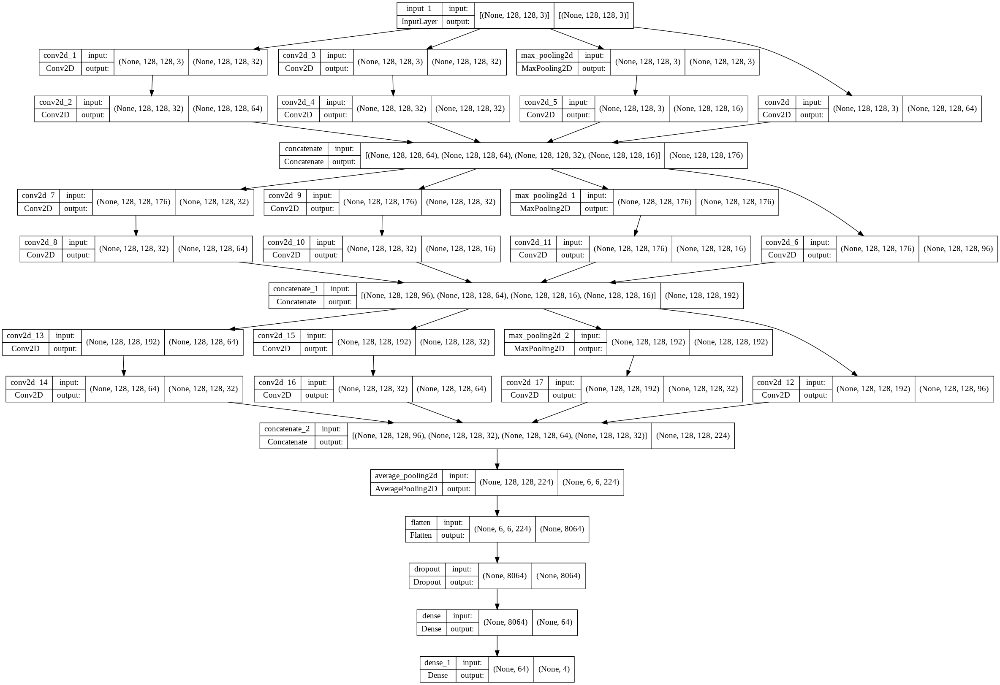

In [ ]:
def inception2():
    tf.keras.backend.clear_session()
    # set random seed
    set_random_seed()

    # function for creating a projected inception module
    def inception_module(layer_in, f1, f2_in, f2_out, f3_in, f3_out, f4_out):
        # 1x1 conv
        conv1 = Conv2D(f1, (1, 1), padding='valid', activation='relu')(layer_in)
        # 3x3 conv
        conv3 = Conv2D(f2_in, (1, 1), padding='valid', activation='relu')(layer_in)
        conv3 = Conv2D(f2_out, (3, 3), padding='valid', activation='relu')(conv3)
        # 5x5 conv
        conv5 = Conv2D(f3_in, (1, 1), padding='valid', activation='relu')(layer_in)
        conv5 = Conv2D(f3_out, (5, 5), padding='valid', activation='relu')(conv5)
        # 3x3 max pooling
        pool = MaxPooling2D((3, 3), strides=(1, 1), padding='same')(layer_in)
        pool = Conv2D(f4_out, (1, 1), padding='same', activation='relu')(pool)
        # concatenate filters, assumes filters/channels last
        layer_out = concatenate([conv1, conv3, conv5, pool], axis=-1)

        return layer_out

    # define model input
    visible = Input(shape=(128, 128, 3))
    # add inception block 1
    layer = inception_module(visible, 64, 32, 64, 32, 32, 16)
    # add inception block 2
    layer = inception_module(layer, 64, 40, 32, 20, 16, 16)
    # add inception block 3
    layer = inception_module(layer, 64, 32, 32, 16, 32, 16)


    pool = AveragePooling2D((9, 9), strides=20, padding='valid')(layer)


    flatten = Flatten()(pool)

    # Dropout layer
    dropout = Dropout(0.3)(flatten)

    dense = tf.keras.layers.Dense(64, activation='sigmoid')(dropout)

    output = tf.keras.layers.Dense(4, activation='softmax')(dense)

    model = Model(inputs=visible, outputs=output)

    # summarize model
    model.summary()

    return model

model = inception1()
# plot model architecture
plot_model(model, show_shapes=True, to_file='inception_module.png')

In [ ]:
lr = 0.0010142202510360857
# compiling the model
model.compile(loss='categorical_crossentropy',
              optimizer=Adam(lr),
              metrics=['accuracy'], )

# regenrating the sets
print()
train_generator, validation_generator = generate_sets()
print()
print()

# defining early stop
# patience is the number of epochs if there is no improvement, the algorithm will early stop.
stop_early = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)

# training the model
inception_history_2_ = model.fit(train_generator,
                      validation_data=validation_generator,
                      epochs=100,
                      steps_per_epoch=int(np.ceil(train_generator.samples / train_generator.batch_size)),  # ~28
                      verbose=0,
                      callbacks=[stop_early, TqdmCallback(verbose=0)])


Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.




0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 3s 280ms/step - loss: 0.2274 - accuracy: 0.9159


Plots:




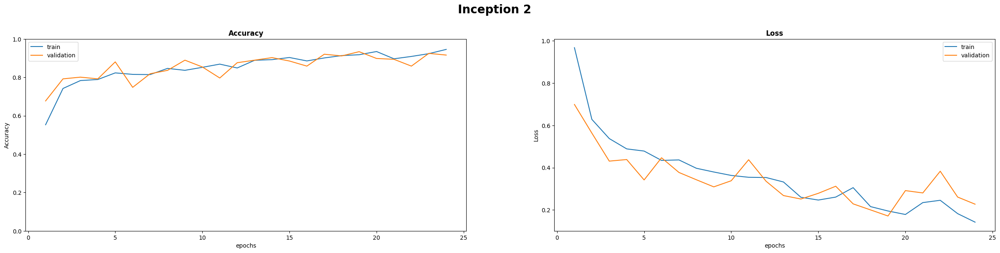



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



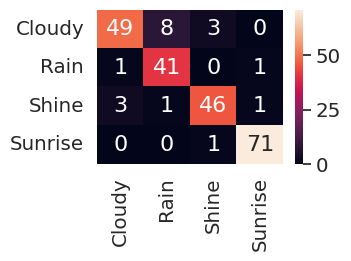



               precision    recall  f1-score   support

           0     0.9245    0.8167    0.8673        60
           1     0.8200    0.9535    0.8817        43
           2     0.9200    0.9020    0.9109        51
           3     0.9726    0.9861    0.9793        72

    accuracy                         0.9159       226
   macro avg     0.9093    0.9146    0.9098       226
weighted avg     0.9189    0.9159    0.9156       226
 



Inception 2: 

╒════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers   │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                    │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════════════╪══════════════════════════════════╪═══

In [ ]:
inception_history_2 = print_full_results("Inception 2", model, inception_history_2_, validation_generator)

###Inception 3

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 128, 128, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_1 (Conv2D)              (None, 128, 128, 32  128         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 conv2d_3 (Conv2D)              (None, 128, 128, 32  128         ['input_1[0][0]']                
                                )                                                             

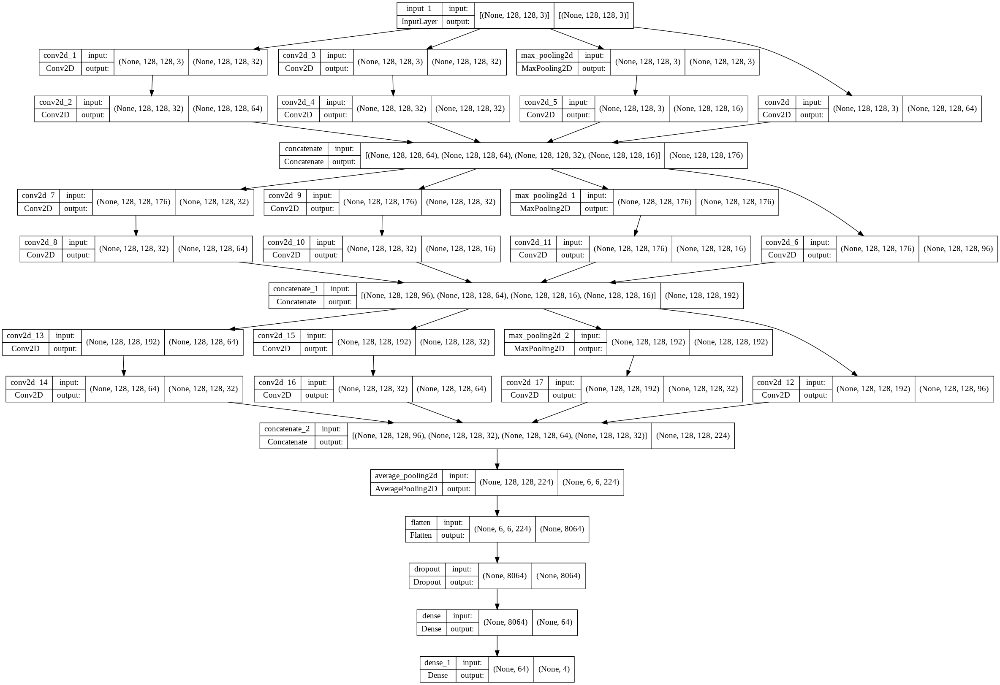

In [ ]:
def inception3():
    tf.keras.backend.clear_session()
    # set random seed
    set_random_seed()

    # function for creating a projected inception module
    def inception_module(layer_in, f1, f2_in, f2_out, f3_in, f3_out, f4_out):
        # 1x1 conv
        conv1 = Conv2D(f1, (1, 1), padding='same', activation='relu')(layer_in)
        # 3x3 conv
        conv3 = Conv2D(f2_in, (1, 1), padding='same', activation='relu')(layer_in)
        conv3 = Conv2D(f2_out, (3, 3), padding='same', activation='relu')(conv3)
        # 5x5 conv
        conv5 = Conv2D(f3_in, (1, 1), padding='same', activation='relu')(layer_in)
        conv5 = Conv2D(f3_out, (5, 5), padding='same', activation='relu')(conv5)
        # 3x3 max pooling
        pool = MaxPooling2D((5, 5), strides=(5, 5), padding='same')(layer_in)
        pool = Conv2D(f4_out, (1, 1), padding='same', activation='relu')(pool)
        # concatenate filters, assumes filters/channels last
        layer_out = concatenate([conv1, conv3, conv5, pool], axis=-1)

        return layer_out

    # define model input
    visible = Input(shape=(128, 128, 3))
    # add inception block 1
    layer = inception_module(visible, 64, 32, 64, 32, 32, 16)
    # add inception block 2
    layer = inception_module(layer, 64, 32, 20, 32, 24, 16)
    # add inception block 3
    layer = inception_module(layer, 64, 40, 32, 24, 20, 16)


    pool = AveragePooling2D((9, 9), strides=20, padding='valid')(layer)


    flatten = Flatten()(pool)

    # Dropout layer
    dropout = Dropout(0.1)(flatten)

    dense = tf.keras.layers.Dense(32, activation='relu')(dropout)

    output = tf.keras.layers.Dense(4, activation='softmax')(dense)

    model = Model(inputs=visible, outputs=output)

    # summarize model
    model.summary()

    return model

model = inception1()
# plot model architecture
plot_model(model, show_shapes=True, to_file='inception_module.png')

In [ ]:
lr = 0.0010142202510360857
# compiling the model
model.compile(loss='categorical_crossentropy',
              optimizer=Adam(lr),
              metrics=['accuracy'], )

# regenrating the sets
print()
train_generator, validation_generator = generate_sets()
print()
print()

# defining early stop
# patience is the number of epochs if there is no improvement, the algorithm will early stop.
stop_early = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)

# training the model
inception_history_3_ = model.fit(train_generator,
                      validation_data=validation_generator,
                      epochs=100,
                      steps_per_epoch=int(np.ceil(train_generator.samples / train_generator.batch_size)),  # ~28
                      verbose=0,
                      callbacks=[stop_early, TqdmCallback(verbose=0)])


Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.




0epoch [00:00, ?epoch/s]


Evaluation:
8/8 [==============================] - 2s 274ms/step - loss: 0.2543 - accuracy: 0.9071


Plots:




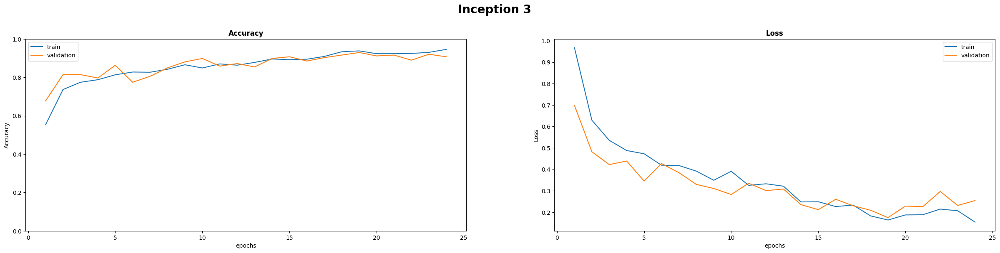



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.



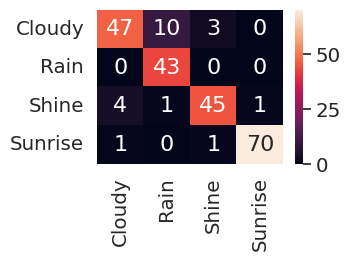



               precision    recall  f1-score   support

           0     0.9038    0.7833    0.8393        60
           1     0.7963    1.0000    0.8866        43
           2     0.9184    0.8824    0.9000        51
           3     0.9859    0.9722    0.9790        72

    accuracy                         0.9071       226
   macro avg     0.9011    0.9095    0.9012       226
weighted avg     0.9128    0.9071    0.9065       226
 



Inception 3: 

╒════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers   │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                    │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════════════╪══════════════════════════════════╪═══

In [ ]:
inception_history_3 = print_full_results("Inception 3", model, inception_history_3_, validation_generator)

### Inception Models results 

In [ ]:
print(colored("Inception models:\n", 'yellow', attrs=['bold']), "\n")
print(print_table(
    [find_max_i(inception_history_1), find_max_i(inception_history_2), find_max_i(inception_history_3)],

    head=["Number of Layers",
          "Accuracy and Loss of train set\naccording to Min train Loss",
          "Accuracy and Loss of val set\naccording to Min val Loss",
          "Accuracy and Loss of train set\naccording to Max train Accuracy",
          "Accuracy and Loss of val set\naccording to Max val Accuracy"],
    rows=["Inception 1", "Inception 2", "Inception 3"]))


Inception modles:
 

╒════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers   │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                    │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════════════╪══════════════════════════════════╪════════════════════════════════╪═══════════════════════════════════╪═════════════════════════════════╡
│ Inception 1        │ (epoch index:23)                 │ (epoch index:18)               │ (epoch index:23)                  │ (epoch index:18)                │
│                    │ Accuracy: 0.9299221634864807     │ Accuracy: 0.9380530714988708   │ Accuracy: 0.9299221634864807      │ Accuracy: 0.9380530714988708    │
│            

Inception modles:




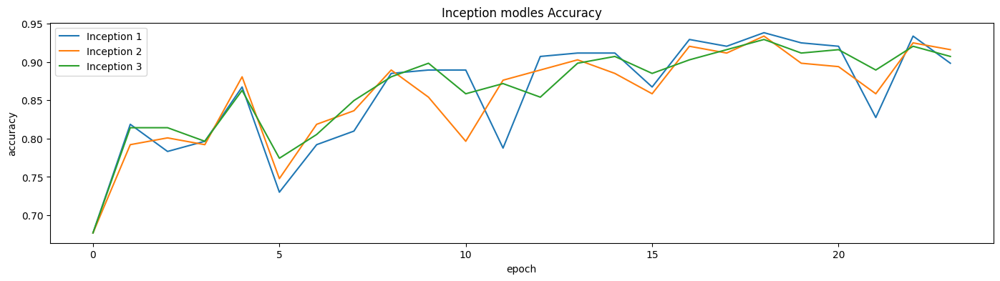

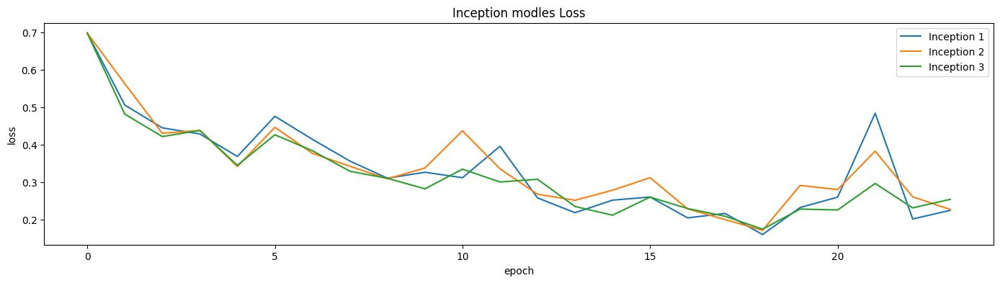

In [ ]:
print(colored("Inception models:\n\n", 'yellow', attrs=['bold']))
plot_multi_plots(names=["Inception 1", "Inception 2", "Inception 3"],
                 history=[inception_history_1, inception_history_2, inception_history_3],
                 purpose="val_accuracy", title="Inception models Accuracy", y_label="accuracy")
print()
plot_multi_plots(names=["Inception 1", "Inception 2", "Inception 3"],
                 history=[inception_history_1, inception_history_2, inception_history_3],
                 purpose="val_loss", title="Inception models Loss", y_label="loss")

##*K fold Cross-validation*


In [ ]:
# read data from images without augmentation

dataset = tf.keras.utils.image_dataset_from_directory(
    path,
    seed=seed,
    label_mode='categorical',
    image_size=(128, 128),
    batch_size=1125)
data = list(dataset.as_numpy_iterator())[0]
inputs = data[0]/ 255
targets = data[1]

Found 1125 files belonging to 4 classes.


In [ ]:
def cross_validation(model, epochs=1, Print=False, folds=5):
    # clear session
    tf.keras.backend.clear_session()
    # set random seed
    set_random_seed()
    History = {}

    # Define the K-fold Cross Validator
    kfold = KFold(n_splits=folds, shuffle=True)
    acc_per_fold = []
    loss_per_fold = []

    # defining early stop
    # patience is the number of epochs if there is no improvement, the algorithm will early stop.
    stop_early = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)

    # K-fold Cross Validation model evaluation
    fold_no = 1
    for train, test in kfold.split(inputs, targets):
        # Generate a print
        print('------------------------------------------------------------------------')
        print(f'Training for fold {fold_no} ...')
        # print(train.type)

        His = model.fit(inputs[train], targets[train], epochs=epochs, verbose=0,
                        validation_data=(inputs[test], targets[test]), callbacks=[stop_early, TqdmCallback(verbose=0)])
        # save history
        if fold_no == 1:
            History = His
        else:
            for key in History.history.keys():
                History.history[key] += His.history[key]
        # Generate generalization metrics
        scores = model.evaluate(inputs[test], targets[test], verbose=0)
        print(f'Score for fold {fold_no}: {model.metrics_names[0]} of {scores[0]}; {model.metrics_names[1]} of {scores[1] * 100}%')
        acc_per_fold.append(scores[1] * 100)
        loss_per_fold.append(scores[0])

        # Increase fold number
        fold_no += 1

    return History, model


### model 1
C3 K3 S1 PS D2 dense 64 maxpooling 2

In [ ]:
model = conv2model_pooling(epochs=200, kernel_size=3, strides=1, padding='same', dilation=2, dense=64, pooling_function=MaxPooling2D, pool_size=(2, 2),
                                                                lr=0.0010142202510360857, return_model=True)
history_k_fold_model_1_, model = cross_validation(model, epochs=5, folds=5)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 64, 64, 16)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 64, 64, 32)        4640      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 32, 32, 32)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 32, 32, 48)        13872     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 16, 16, 48)       0

0epoch [00:00, ?epoch/s]

Score for fold 1: loss of 0.6040328741073608; accuracy of 78.22222113609314%
------------------------------------------------------------------------
Training for fold 2 ...


0epoch [00:00, ?epoch/s]

Score for fold 2: loss of 0.11439688503742218; accuracy of 95.55555582046509%
------------------------------------------------------------------------
Training for fold 3 ...


0epoch [00:00, ?epoch/s]

Score for fold 3: loss of 0.05679718405008316; accuracy of 98.66666793823242%
------------------------------------------------------------------------
Training for fold 4 ...


0epoch [00:00, ?epoch/s]

Score for fold 4: loss of 0.05884858965873718; accuracy of 98.22221994400024%
------------------------------------------------------------------------
Training for fold 5 ...


0epoch [00:00, ?epoch/s]

Score for fold 5: loss of 0.021996621042490005; accuracy of 99.5555579662323%



Evaluation:
36/36 [==============================] - 0s 11ms/step - loss: 0.0126 - accuracy: 0.9982


Plots:




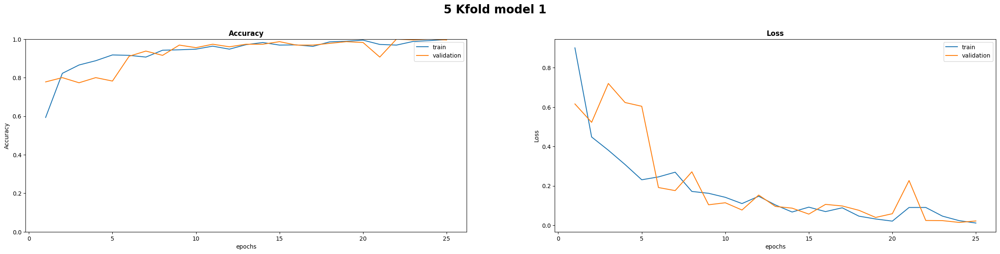



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.


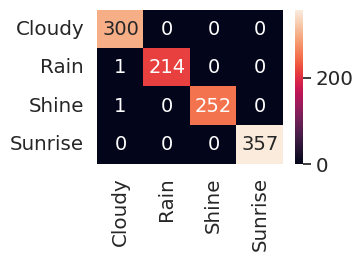



               precision    recall  f1-score   support

           0     0.9934    1.0000    0.9967       300
           1     1.0000    0.9953    0.9977       215
           2     1.0000    0.9960    0.9980       253
           3     1.0000    1.0000    1.0000       357

    accuracy                         0.9982      1125
   macro avg     0.9983    0.9978    0.9981      1125
weighted avg     0.9982    0.9982    0.9982      1125
 



5 Kfold model 1: 

╒════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers   │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                    │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════════════╪══════════════════════════════════

In [ ]:
history_k_fold_model_1 = print_full_results("5 Kfold model 1", model, history_k_fold_model_1_, dataset, read_data=True)

### model 2
c3 k3 PS D2 dense 64

In [ ]:
model = conv2model_diffrent_parameters(epochs=200, kernel_size=3, strides=1, padding='same', dilation=2, dense=64, lr=0.0010142202510360857, return_model=True)
history_k_fold_model_2_, model = cross_validation(model, epochs=5, folds=5)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 16)      448       
                                                                 
 conv2d_1 (Conv2D)           (None, 128, 128, 32)      4640      
                                                                 
 conv2d_2 (Conv2D)           (None, 128, 128, 48)      13872     
                                                                 
 flatten (Flatten)           (None, 786432)            0         
                                                                 
 dense (Dense)               (None, 64)                50331712  
                                                                 
 dense_1 (Dense)             (None, 4)                 260       
                                                                 
Total params: 50,350,932
Trainable params: 50,350,932
No

0epoch [00:00, ?epoch/s]

Score for fold 1: loss of 0.7949630618095398; accuracy of 79.55555319786072%
------------------------------------------------------------------------
Training for fold 2 ...


0epoch [00:00, ?epoch/s]

Score for fold 2: loss of 0.026560600847005844; accuracy of 99.11110997200012%
------------------------------------------------------------------------
Training for fold 3 ...


0epoch [00:00, ?epoch/s]

Score for fold 3: loss of 0.025748098269104958; accuracy of 99.11110997200012%
------------------------------------------------------------------------
Training for fold 4 ...


0epoch [00:00, ?epoch/s]

Score for fold 4: loss of 0.0015944538172334433; accuracy of 100.0%
------------------------------------------------------------------------
Training for fold 5 ...


0epoch [00:00, ?epoch/s]

Score for fold 5: loss of 0.00012389157200232148; accuracy of 100.0%



Evaluation:
36/36 [==============================] - 1s 27ms/step - loss: 1.2258e-04 - accuracy: 1.0000


Plots:




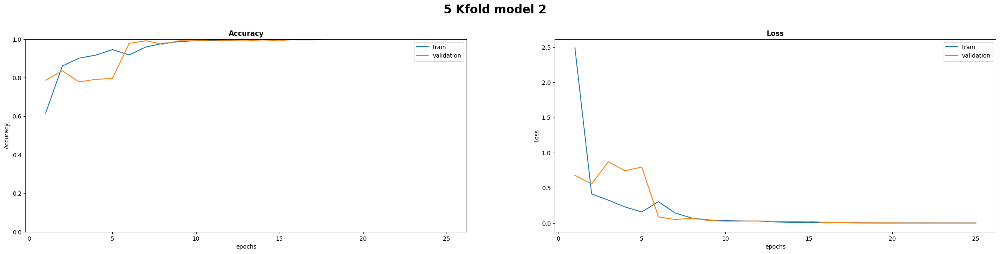



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.


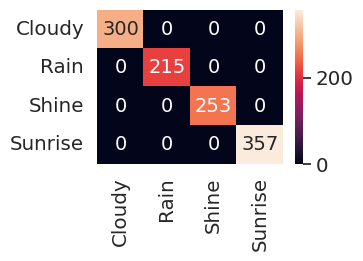



               precision    recall  f1-score   support

           0     1.0000    1.0000    1.0000       300
           1     1.0000    1.0000    1.0000       215
           2     1.0000    1.0000    1.0000       253
           3     1.0000    1.0000    1.0000       357

    accuracy                         1.0000      1125
   macro avg     1.0000    1.0000    1.0000      1125
weighted avg     1.0000    1.0000    1.0000      1125
 



5 Kfold model 2: 

╒════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers   │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                    │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════════════╪══════════════════════════════════

In [ ]:
history_k_fold_model_2 = print_full_results("5 Kfold model 2", model, history_k_fold_model_2_, dataset, read_data=True)

### model 3
c3 k3 s1 PS D2 dense 64 maxpooling 2 batch norm

In [ ]:
model = batch_norm(epochs=200, kernel_size=3, strides=1, padding='same', dilation=2, dense=64,
                   pooling_function=MaxPooling2D, pool_size=(2, 2), lr=0.0010142202510360857, return_model=True)
history_k_fold_model_3_, model = cross_validation(model, epochs=5, folds=5)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 16)      448       
                                                                 
 batch_normalization (BatchN  (None, 128, 128, 16)     64        
 ormalization)                                                   
                                                                 
 activation (Activation)     (None, 128, 128, 16)      0         
                                                                 
 max_pooling2d (MaxPooling2D  (None, 64, 64, 16)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 64, 64, 32)        4640      
                                                                 
 batch_normalization_1 (Batc  (None, 64, 64, 32)       1

0epoch [00:00, ?epoch/s]

Score for fold 1: loss of 1.601885437965393; accuracy of 37.33333349227905%
------------------------------------------------------------------------
Training for fold 2 ...


0epoch [00:00, ?epoch/s]

Score for fold 2: loss of 1.0581183433532715; accuracy of 59.55555438995361%
------------------------------------------------------------------------
Training for fold 3 ...


0epoch [00:00, ?epoch/s]

Score for fold 3: loss of 0.3308008909225464; accuracy of 87.55555748939514%
------------------------------------------------------------------------
Training for fold 4 ...


0epoch [00:00, ?epoch/s]

Score for fold 4: loss of 0.11642072349786758; accuracy of 95.99999785423279%
------------------------------------------------------------------------
Training for fold 5 ...


0epoch [00:00, ?epoch/s]

Score for fold 5: loss of 0.09457637369632721; accuracy of 96.88888788223267%



Evaluation:
36/36 [==============================] - 0s 11ms/step - loss: 0.0844 - accuracy: 0.9716


Plots:




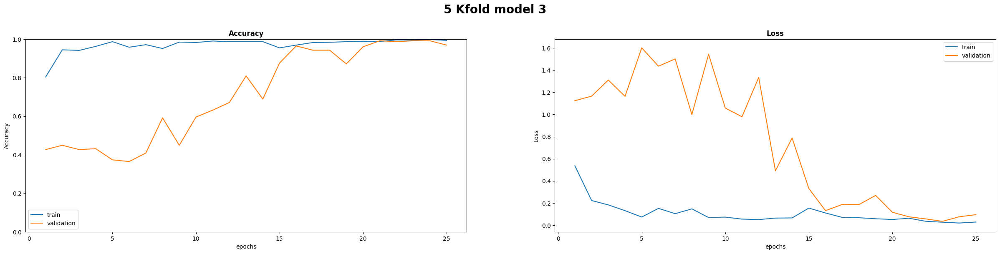



Confusion_matrix:
Found 899 images belonging to 4 classes.
Found 226 images belonging to 4 classes.


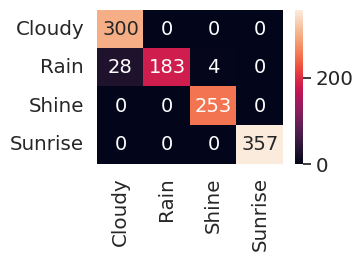



               precision    recall  f1-score   support

           0     0.9146    1.0000    0.9554       300
           1     1.0000    0.8512    0.9196       215
           2     0.9844    1.0000    0.9922       253
           3     1.0000    1.0000    1.0000       357

    accuracy                         0.9716      1125
   macro avg     0.9748    0.9628    0.9668      1125
weighted avg     0.9737    0.9716    0.9710      1125
 



5 Kfold model 3: 

╒════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers   │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                    │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════════════╪══════════════════════════════════

In [ ]:
history_k_fold_model_3 = print_full_results("5 Kfold model 3", model, history_k_fold_model_3_, dataset, read_data=True)

### K-fold results 

In [ ]:
print(colored("5 Kfold models:\n", 'yellow', attrs=['bold']), "\n")
print(print_table(
    [find_max_i(history_k_fold_model_1), find_max_i(history_k_fold_model_2), find_max_i(history_k_fold_model_3)],

    head=["Number of Layers",
          "Accuracy and Loss of train set\naccording to Min train Loss",
          "Accuracy and Loss of val set\naccording to Min val Loss",
          "Accuracy and Loss of train set\naccording to Max train Accuracy",
          "Accuracy and Loss of val set\naccording to Max val Accuracy"],
    rows=["5 Kfold model 1", "5 Kfold model 3", "5 Kfold model 3"]))


5 Kfold models:
 

╒════════════════════╤══════════════════════════════════╤════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╕
│ Number of Layers   │ Accuracy and Loss of train set   │ Accuracy and Loss of val set   │ Accuracy and Loss of train set    │ Accuracy and Loss of val set    │
│                    │ according to Min train Loss      │ according to Min val Loss      │ according to Max train Accuracy   │ according to Max val Accuracy   │
╞════════════════════╪══════════════════════════════════╪════════════════════════════════╪═══════════════════════════════════╪═════════════════════════════════╡
│ 5 Kfold model 1    │ (epoch index:24)                 │ (epoch index:23)               │ (epoch index:24)                  │ (epoch index:21)                │
│                    │ Accuracy: 0.9977777600288391     │ Accuracy: 1.0                  │ Accuracy: 0.9977777600288391      │ Accuracy: 1.0                   │
│              

5 Kfold models:




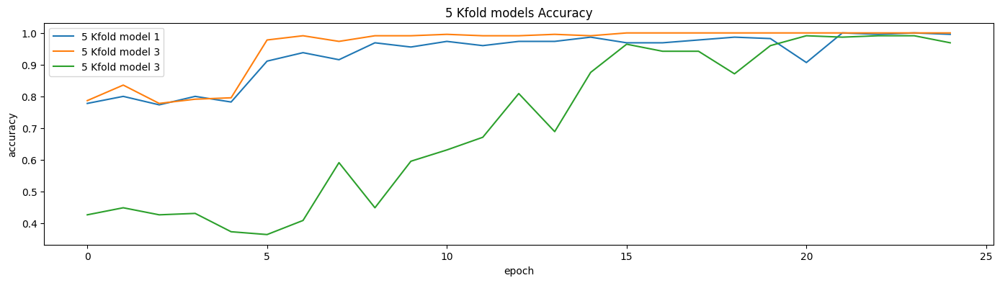

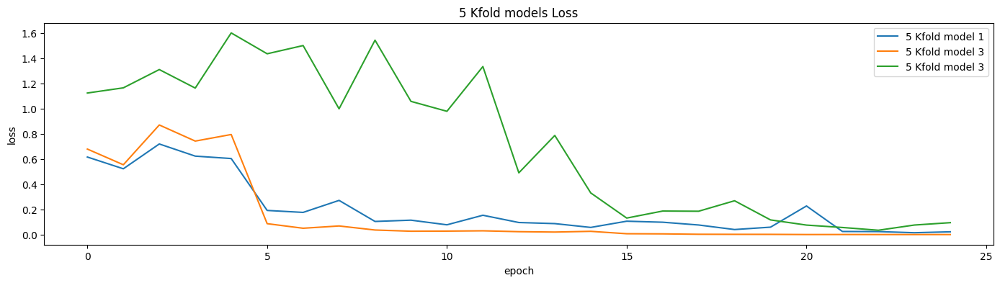

In [ ]:
print(colored("5 Kfold models:\n\n", 'yellow', attrs=['bold']))
plot_multi_plots(names=["5 Kfold model 1", "5 Kfold model 3", "5 Kfold model 3"],
                 history=[history_k_fold_model_1, history_k_fold_model_2, history_k_fold_model_3],
                 purpose="val_accuracy", title="5 Kfold models Accuracy", y_label="accuracy")
print()
plot_multi_plots(names=["5 Kfold model 1", "5 Kfold model 3", "5 Kfold model 3"],
                 history=[history_k_fold_model_1, history_k_fold_model_2, history_k_fold_model_3],
                 purpose="val_loss", title="5 Kfold models Loss", y_label="loss")